# Examine results from various smaller AP Pipeline runs

To close out the difference imaging sprint in March 2021, we analyzed results from several runs on the same HSC images with different configs set. We used the shared `rc2w50_ssw02` repo as before, and ran each set of images with best-seeing templates, middle-seeing templates, and worst-seeing templates.

The various difference-imaging-related settings we tried are as follows:

1. Default - A&L with default configs, plus the "usual" `doDecorrelation=True`, `doSelectSources=False`, and `doScaleDiffimVariance=True`; respectively, these turn on the decorrelation afterburner, do not use template source catalogs, and scale the variance of the difference image prior to PSF matching
2. Zogy - Zogy with default configs as in (1)
3. Preconvolution - A&L with `doPreConvolve=True`, which convolves the science image by its PSF before doing PSF matching
4. Convolve Science - A&L with `convolveTemplate=False`, which convolves the science image instead of the template during differencing. Only best seeing templates were used here as we realized (6) made more sense.
5. Preconvolution w/o Decorrelation - same as (3) but with `doDecorrelation=False`
6. Convolve Science w/o Decorrelation - same as (4) but with `doDecorrelation=False`
7. Zogy with Preconvolution - same as (2) but with `doPreConvolve=True`

In all cases, the images processed were either g-band or r-band. The g-band visits are 11690, 11692, 11694, 11696, 11698, 11700, 11702, 11704, 11706, 11708, 11710, 11712, 29324, 29326, 29336, 29340, 29350 and the r-band visits are 1202, 1204, 1206, 1208, 1210, 1212, 1214, 1216, 1218, 1220, 23692, 23694, 23704, 23706, 23716, 23718. For each visit, we processed detectors (ccds) 49, 50, 57, 58, 65, 66, which are all near the center of the focal plane.

Not all of the images processed successfully, but most of them did. In several cases, difference images were produced but writing to the APDB failed due to an upstream bug we have yet to track down. Here is a summary of how many of the 990 quanta failed in each run. (Recall 1 quantum = 1 visit + 1 detector + 1 job. Each AP Pipeline run consists of five jobs - isr, characterizeImage, calibrate, imageDifference, diaPipe.)

1. Default - No failures
2. Zogy - A few imageDifference failures pertaining to PSF centroids being offset.
* 24 bestSeeing
* 13 middleSeeing
* 22 worstSeeing
3. Preconvolve - Some imageDifference failures pertaining to variance rescaling or a point being outside the image. Nearly all the rest failed in diaPipe due to upstream NaNs, resulting in an empty APDB.
* 184 bestSeeing (64 imageDifference + 120 diaPipe)
* 183 middleSeeing (65 imageDifference + 118 diaPipe)
* 192 worstSeeing (58 imageDifference + 134 diaPipe)
4. ConvolveSci - No failures (recall only bestSeeing was done for this one)
5. Preconvolve_noDecorr - All diaPipe jobs failed due to upstream NaNs, resulting in an empty APDB.
* 198 in each of bestSeeing, middleSeeing, and worstSeeing.
6. ConvolveSci_noDecorr - No failures
7. Zogy_Preconvolve - A few imageDifference failures pertaining to PSF centroids being offset or a point being outside the image. All the rest failed in diaPipe due to upstream NaNs, resulting in an empty APDB.
* 198 bestSeeing (18 imageDifference + 180 diaPipe)
* 198 middleSeeing (13 imageDifference + 185 diaPipe)
* 198 worstSeeing (22 imageDifference + 176 diaPipe)

All of the output collections and APDBs are given in a cell below. In particular, we noticed the runs with preconvolution all failed to make it to an APDB. Due to this (and not actually wanting to make 21x all the plots!!), not every theoretically possible flavor of plot is shown in this notebook. Enjoy!

In [1]:
%matplotlib notebook

import os
import sys
import numpy as np
import matplotlib.pyplot as plt
import importlib
import pandas as pd
from types import SimpleNamespace

from astropy.coordinates import SkyCoord
import astropy.units as u
from astropy.visualization import (ZScaleInterval, SqrtStretch, ImageNormalize)

import lsst.geom
import lsst.daf.butler as dafButler
from lsst.ap.association import UnpackApdbFlags, MapDiaSourceConfig
from lsst.obs.decam import DarkEnergyCamera
from lsst.pipe.base import Struct

In [2]:
sys.path.append('/project/mrawls/ap_pipe-notebooks/')
import diaObjectAnalysis as doa
import apdbPlots as pla
import plotLightcurve as plc
import coaddAnalysis as coa

In [ ]:
# Only if you change anything in the code imported above
importlib.reload(doa)
importlib.reload(pla)
importlib.reload(plc)
importlib.reload(coa)

In [3]:
repo = '/datasets/hsc/gen3repo/rc2w50_ssw02'

In [4]:
butler = dafButler.Butler(repo)

## Define collections

In [6]:
default_best = SimpleNamespace(collection = 'u/kherner/ApPipe_default_bestSeeing',
                               apdb = '/project/kherner/diffim_sprint_2021-02/bps_testing/bps_default_best.db')
default_middle = SimpleNamespace(collection = 'u/kherner/ApPipe_default_middleSeeing',
                                 apdb = '/project/kherner/diffim_sprint_2021-02/bps_testing/bps_default_middle.db')
default_worst = SimpleNamespace(collection = 'u/kherner/ApPipe_default_worstSeeing',
                                apdb = '/project/kherner/diffim_sprint_2021-02/bps_testing/bps_default_worst.db')

zogy_best = SimpleNamespace(collection = 'u/kherner/ApPipe_ZOGY_bestSeeing_v3',
                            apdb = '/project/kherner/diffim_sprint_2021-02/bps_testing/bps_ZOGY_FULL_best3.db')
zogy_middle = SimpleNamespace(collection = 'u/kherner/ApPipe_ZOGY_middleSeeing_v3',
                              apdb = '/project/kherner/diffim_sprint_2021-02/bps_testing/bps_ZOGY_FULL_mid3.db')
zogy_worst = SimpleNamespace(collection = 'u/kherner/ApPipe_ZOGY_worstSeeing_v3',
                             apdb = '/project/kherner/diffim_sprint_2021-02/bps_testing/bps_ZOGY_FULL_worst3.db')

preconvolve_best = SimpleNamespace(collection = 'u/kherner/ApPipe_PreConvolve_bestSeeing',
                                   apdb = '/project/kherner/diffim_sprint_2021-02/bps_testing/bps_PreConvolve_best.db')
preconvolve_middle = SimpleNamespace(collection = 'u/kherner/ApPipe_PreConvolve_middleSeeing',
                                     apdb = '/project/kherner/diffim_sprint_2021-02/bps_testing/bps_PreConvolve_middle.db')
preconvolve_worst = SimpleNamespace(collection = 'u/kherner/ApPipe_PreConvolve_worstSeeing',
                                    apdb = '/project/kherner/diffim_sprint_2021-02/bps_testing/bps_PreConvolve_worst.db')

convolvesci_best = SimpleNamespace(collection = 'u/kherner/ApPipe_convolveSci_bestSeeing',
                                   apdb = '/project/kherner/diffim_sprint_2021-02/bps_testing/bps_convolveSci_best.db')
#convolvesci_middle = SimpleNamespace(collection = 'u/kherner/ApPipe_convolveSci_middleSeeing',
#                                     apdb = '/project/kherner/diffim_sprint_2021-02/bps_testing/bps_convolveSci_middle.db')
#convolvesci_worst = SimpleNamespace(collection = 'u/kherner/ApPipe_convolveSci_worstSeeing',
#                                    apdb = '/project/kherner/diffim_sprint_2021-02/bps_testing/bps_convolveSci_worst.db')

preconvolve_nodecorr_best = SimpleNamespace(collection = 'u/kherner/ApPipe_PreConvolve_noDecorr_bestSeeing',
                                            apdb = '/project/kherner/diffim_sprint_2021-02/bps_testing/bps_PreConvolve_noDecorr_best.db')
preconvolve_nodecorr_middle = SimpleNamespace(collection = 'u/kherner/ApPipe_PreConvolve_noDecorr_middleSeeing',
                                              apdb = '/project/kherner/diffim_sprint_2021-02/bps_testing/bps_PreConvolve_noDecorr_middle.db')
preconvolve_nodecorr_worst = SimpleNamespace(collection = 'u/kherner/ApPipe_PreConvolve_noDecorr_worstSeeing',
                                             apdb = '/project/kherner/diffim_sprint_2021-02/bps_testing/bps_PreConvolve_noDecorr_worst.db')

convolvesci_nodecorr_best = SimpleNamespace(collection = 'u/kherner/ApPipe_convolveSci_noDecorr_bestSeeing',
                                            apdb = '/project/kherner/diffim_sprint_2021-02/bps_testing/bps_convolveSci_noDecorr_best.db')
convolvesci_nodecorr_middle = SimpleNamespace(collection = 'u/kherner/ApPipe_convolveSci_noDecorr_middleSeeing',
                                              apdb = '/project/kherner/diffim_sprint_2021-02/bps_testing/bps_convolveSci_noDecorr_middle.db')
convolvesci_nodecorr_worst = SimpleNamespace(collection = 'u/kherner/ApPipe_convolveSci_noDecorr_worstSeeing',
                                             apdb = '/project/kherner/diffim_sprint_2021-02/bps_testing/bps_convolveSci_noDecorr_worst.db')

zogy_preconvolve_best = SimpleNamespace(collection = 'u/kherner/ApPipe_ZOGY_PreConvolve_bestSeeing',
                                        apdb = '/project/kherner/diffim_sprint_2021-02/bps_testing/bps_ZOGY_PreConvolve_best.db')
zogy_preconvolve_middle = SimpleNamespace(collection = 'u/kherner/ApPipe_ZOGY_PreConvolve_middleSeeing',
                                          apdb = '/project/kherner/diffim_sprint_2021-02/bps_testing/bps_ZOGY_PreConvolve_middle.db')
zogy_preconvolve_worst = SimpleNamespace(collection = 'u/kherner/ApPipe_ZOGY_PreConvolve_worstSeeing',
                                         apdb = '/project/kherner/diffim_sprint_2021-02/bps_testing/bps_ZOGY_PreConvolve_worst.db')

## Summary tables

In [11]:
all_collections = [default_best.collection, default_middle.collection, default_worst.collection,
                   zogy_best.collection, zogy_middle.collection, #zogy_worst.collection,
                   preconvolve_best.collection, preconvolve_middle.collection, preconvolve_worst.collection,
                   convolvesci_best.collection, 
                   preconvolve_nodecorr_best.collection, preconvolve_nodecorr_middle.collection, preconvolve_nodecorr_worst.collection,
                   convolvesci_nodecorr_best.collection, convolvesci_nodecorr_middle.collection, convolvesci_nodecorr_worst.collection,
                   zogy_preconvolve_best.collection, zogy_preconvolve_middle.collection, #zogy_preconvolve_worst.collection,
                   ]

In [30]:
print(f'Diffim variance median in each collection')
print(f'-----------------------------------------')
for collection in all_collections:
    oneVisit = 1220
    oneDetector = 66
    diffim = butler.get('deepDiff_differenceExp', instrument='HSC',
                        visit=oneVisit, detector=oneDetector, collections=collection)
    print(f'{np.median(diffim.variance.array):9.3f}\t{collection.split("/")[-1]}')

Diffim variance median in each collection
-----------------------------------------
  486.250	ApPipe_default_bestSeeing
  717.035	ApPipe_default_middleSeeing
  705.645	ApPipe_default_worstSeeing
    9.417	ApPipe_ZOGY_bestSeeing_v3
   11.645	ApPipe_ZOGY_middleSeeing_v3
  534.784	ApPipe_PreConvolve_bestSeeing
  677.505	ApPipe_PreConvolve_middleSeeing
  614.709	ApPipe_PreConvolve_worstSeeing
  140.055	ApPipe_convolveSci_bestSeeing
   19.642	ApPipe_PreConvolve_noDecorr_bestSeeing
   37.549	ApPipe_PreConvolve_noDecorr_middleSeeing
   42.619	ApPipe_PreConvolve_noDecorr_worstSeeing
  140.055	ApPipe_convolveSci_noDecorr_bestSeeing
  179.754	ApPipe_convolveSci_noDecorr_middleSeeing
  123.805	ApPipe_convolveSci_noDecorr_worstSeeing
    0.002	ApPipe_ZOGY_PreConvolve_bestSeeing
    0.004	ApPipe_ZOGY_PreConvolve_middleSeeing


In [36]:
apdbs_nonempty = [default_best, default_middle, default_worst,
                  zogy_best, zogy_middle, zogy_worst,
                  preconvolve_best, preconvolve_middle, preconvolve_worst,
                  convolvesci_best,
                  convolvesci_nodecorr_best, convolvesci_nodecorr_middle, convolvesci_nodecorr_worst,
                 ]

badFlagList = ['base_PixelFlags_flag_bad',
               'base_PixelFlags_flag_suspect',
               'base_PixelFlags_flag_saturatedCenter',
               'base_PixelFlags_flag_interpolated',
               'base_PixelFlags_flag_interpolatedCenter',
               'base_PixelFlags_flag_edge',
              ]

print(f'N DiaSources and N "good" DiaSources in each collection')
print(f'-------------------------------------------------------')
for run in apdbs_nonempty:
    collection = run.collection
    apdb = run.apdb
    objTable, srcTable, goodObj, goodSrc = pla.loadTables(repo, dbType='sqlite', dbName=apdb, gen='gen3',
                                                          instrument='HSC', badFlagList=badFlagList)
    print(f'{len(srcTable):7d}\t{len(goodSrc):7d}\t\t{collection.split("/")[-1]}')

N DiaSources and N "good" DiaSources in each collection
-------------------------------------------------------
 112309	  35099		ApPipe_default_bestSeeing
  98259	  30016		ApPipe_default_middleSeeing
  96452	  30138		ApPipe_default_worstSeeing
 191175	 120830		ApPipe_ZOGY_bestSeeing_v3
 195363	 125543		ApPipe_ZOGY_middleSeeing_v3
 165157	 102769		ApPipe_ZOGY_worstSeeing_v3
  10897	   4723		ApPipe_PreConvolve_bestSeeing
   8832	   3893		ApPipe_PreConvolve_middleSeeing
   3977	   1359		ApPipe_PreConvolve_worstSeeing
1052601	 783218		ApPipe_convolveSci_bestSeeing
 423447	 305095		ApPipe_convolveSci_noDecorr_bestSeeing
 469982	 334763		ApPipe_convolveSci_noDecorr_middleSeeing
 497027	 357995		ApPipe_convolveSci_noDecorr_worstSeeing


## Look at one visit + detector in a set of runs

<IPython.core.display.Javascript object>


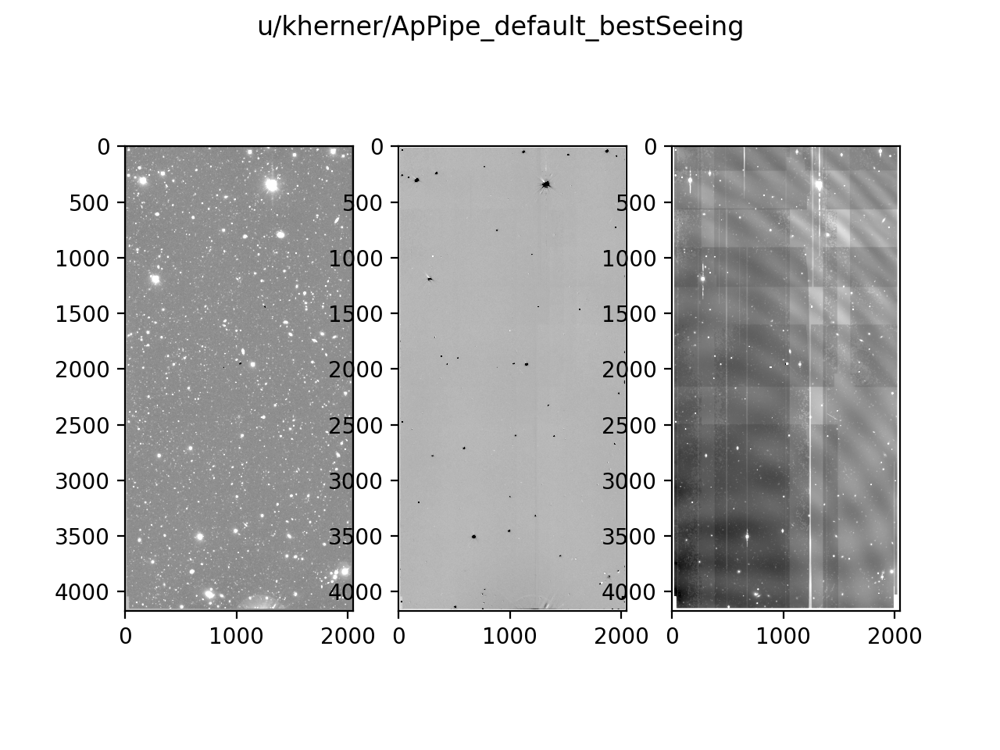

diffim variance median: 486.2501


<IPython.core.display.Javascript object>


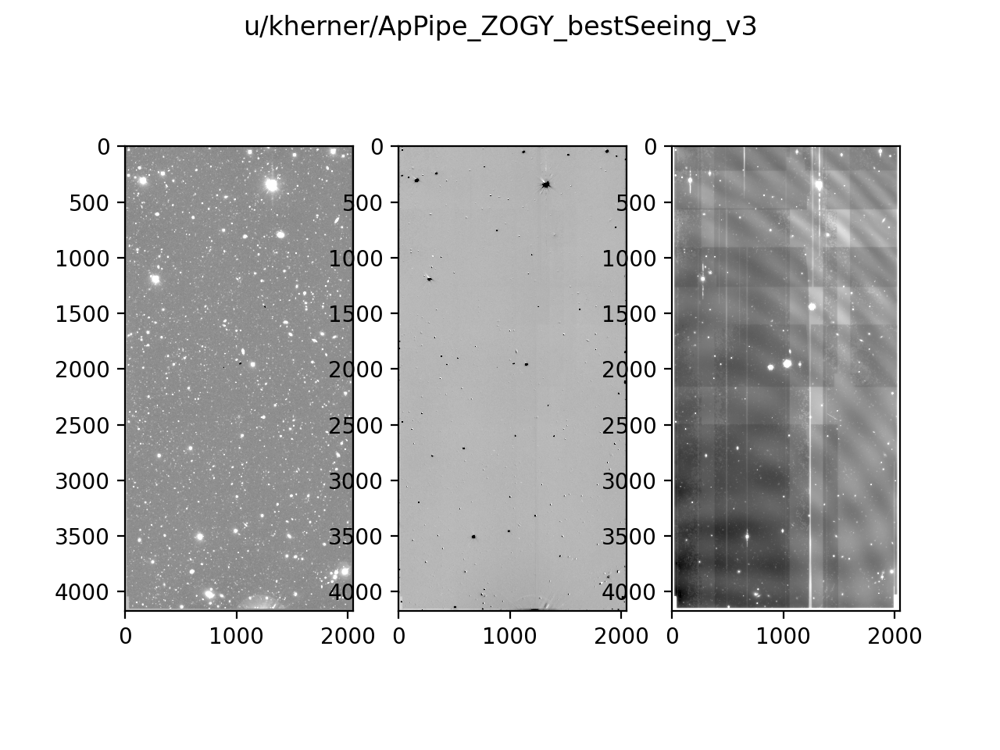

diffim variance median: 9.417171


<IPython.core.display.Javascript object>


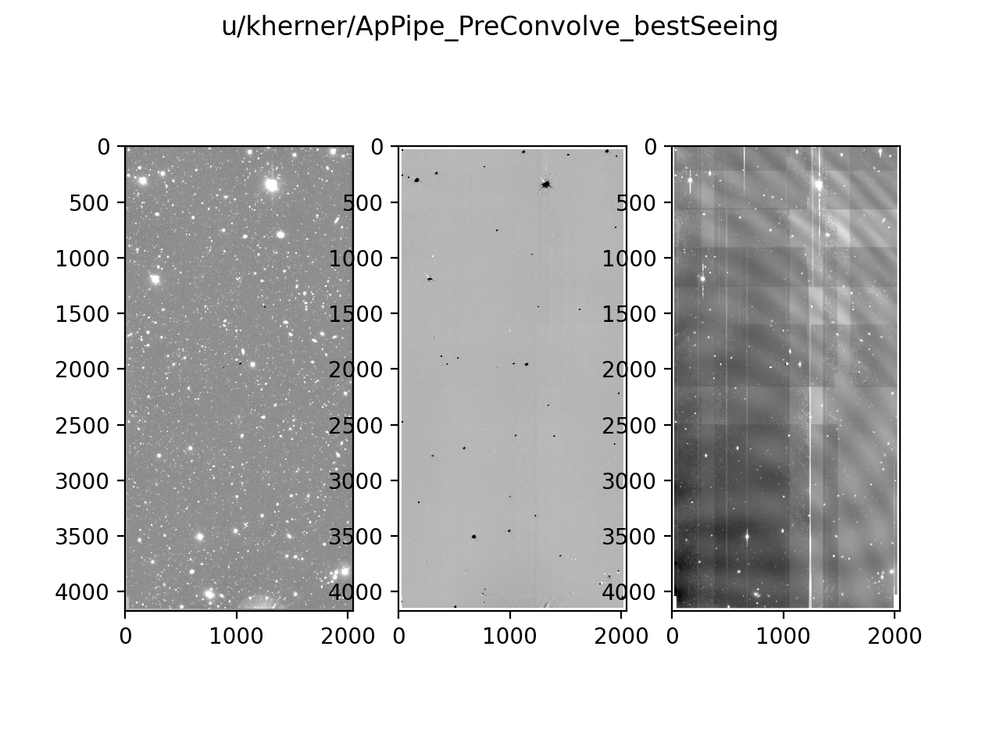

diffim variance median: 534.7839


<IPython.core.display.Javascript object>


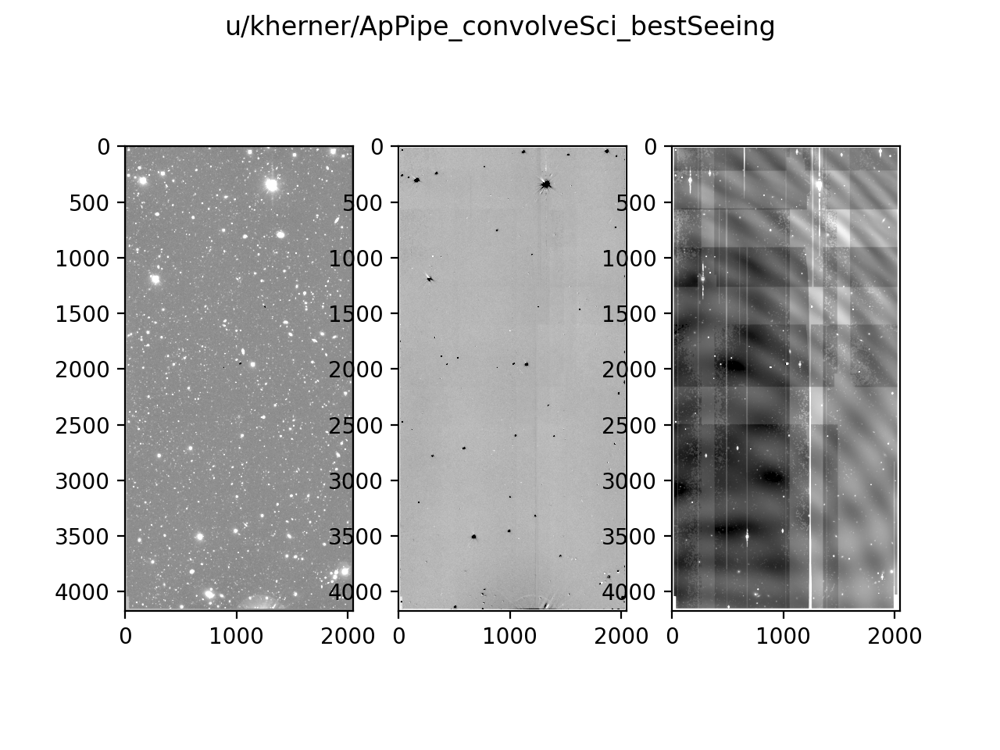

diffim variance median: 140.05539


<IPython.core.display.Javascript object>


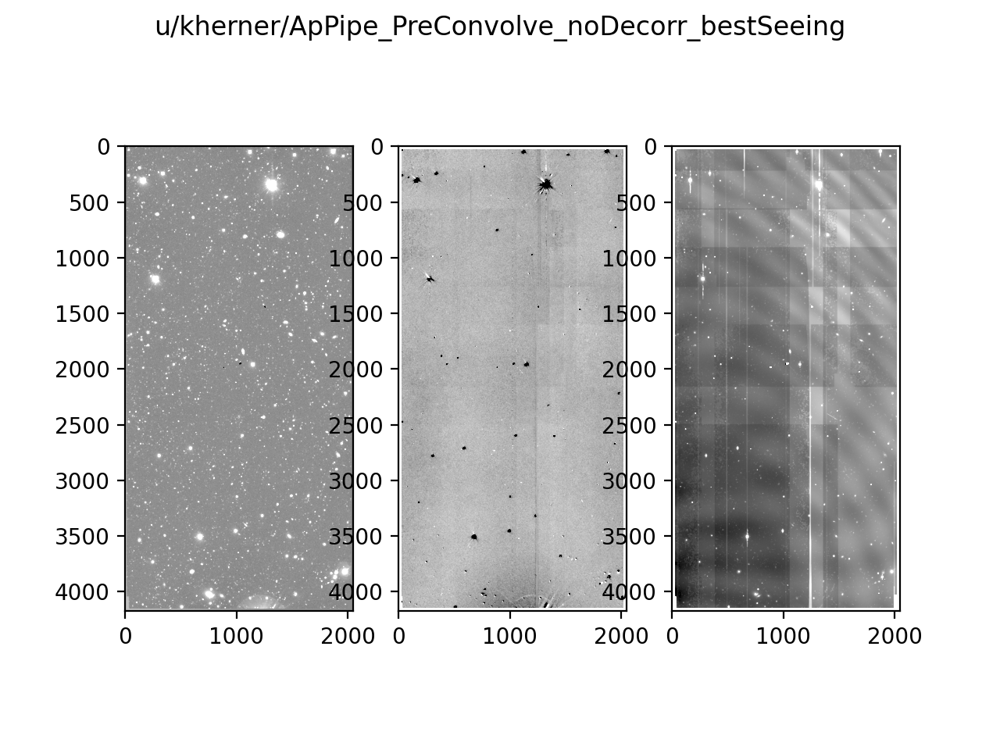

diffim variance median: 19.642082


<IPython.core.display.Javascript object>


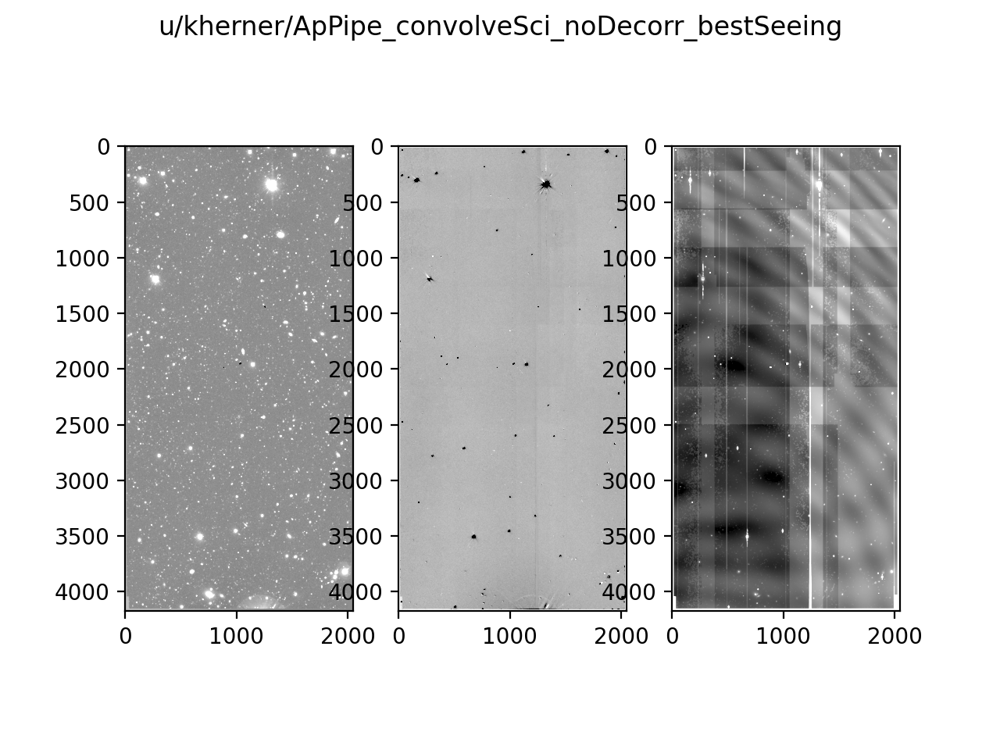

diffim variance median: 140.05463


<IPython.core.display.Javascript object>


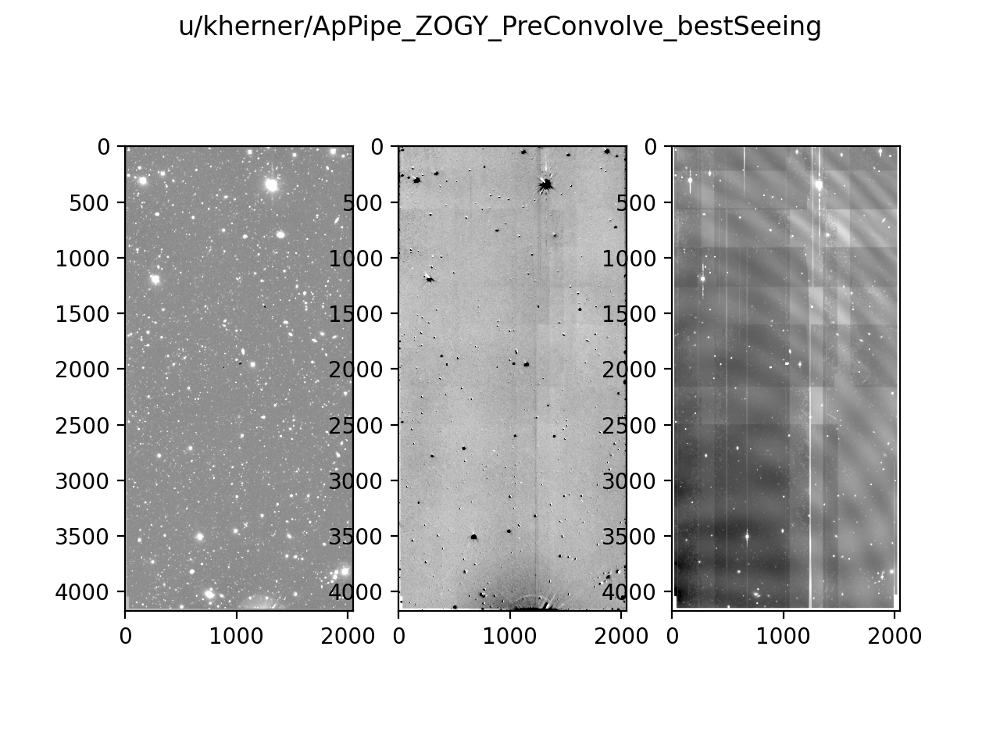

diffim variance median: 0.0023576336


In [8]:
oneVisit = 1220
oneDetector = 66

collection_list = [default_best.collection, zogy_best.collection, preconvolve_best.collection,
                   convolvesci_best.collection, preconvolve_nodecorr_best.collection,
                   convolvesci_nodecorr_best.collection, zogy_preconvolve_best.collection]

for collections in collection_list:
#for collections in [default_best.collection, preconvolve_best.collection]:
    calexp = butler.get('calexp', instrument='HSC',
                        visit=oneVisit, detector=oneDetector, collections=collections)
    diffim = butler.get('deepDiff_differenceExp', instrument='HSC',
                        visit=oneVisit, detector=oneDetector, collections=collections)

    calexpNorm = ImageNormalize(calexp.image.array, interval=ZScaleInterval(), stretch=SqrtStretch())
    diffimNorm = ImageNormalize(diffim.image.array, interval=ZScaleInterval(), stretch=SqrtStretch())
    diffimVarNorm = ImageNormalize(diffim.variance.array, interval=ZScaleInterval(), stretch=SqrtStretch())

    fig, (ax1, ax2, ax3) = plt.subplots(1, 3)
    fig.suptitle(collections)
    ax1.imshow(calexp.image.array, cmap='gray', norm=calexpNorm)
    ax2.imshow(diffim.image.array, cmap='gray', norm=diffimNorm)
    ax3.imshow(diffim.variance.array, cmap='gray', norm=diffimVarNorm)
    
    print('diffim variance median:', np.median(diffim.variance.array))

## Do it again, for for middle seeing templates

<IPython.core.display.Javascript object>


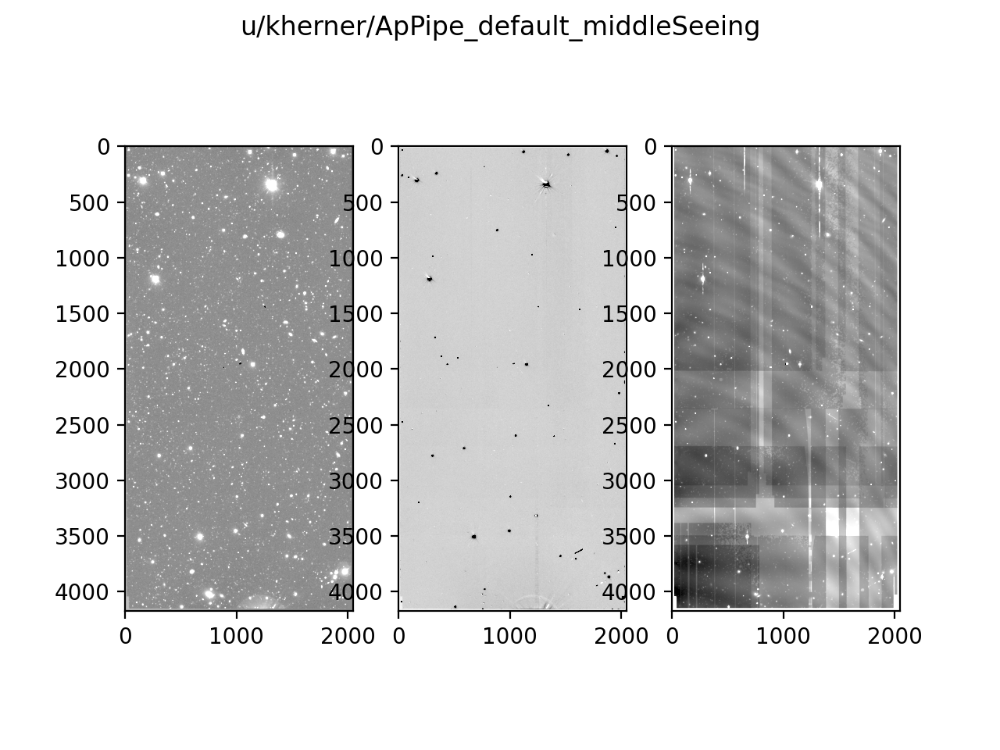

diffim variance median: 717.03485


<IPython.core.display.Javascript object>


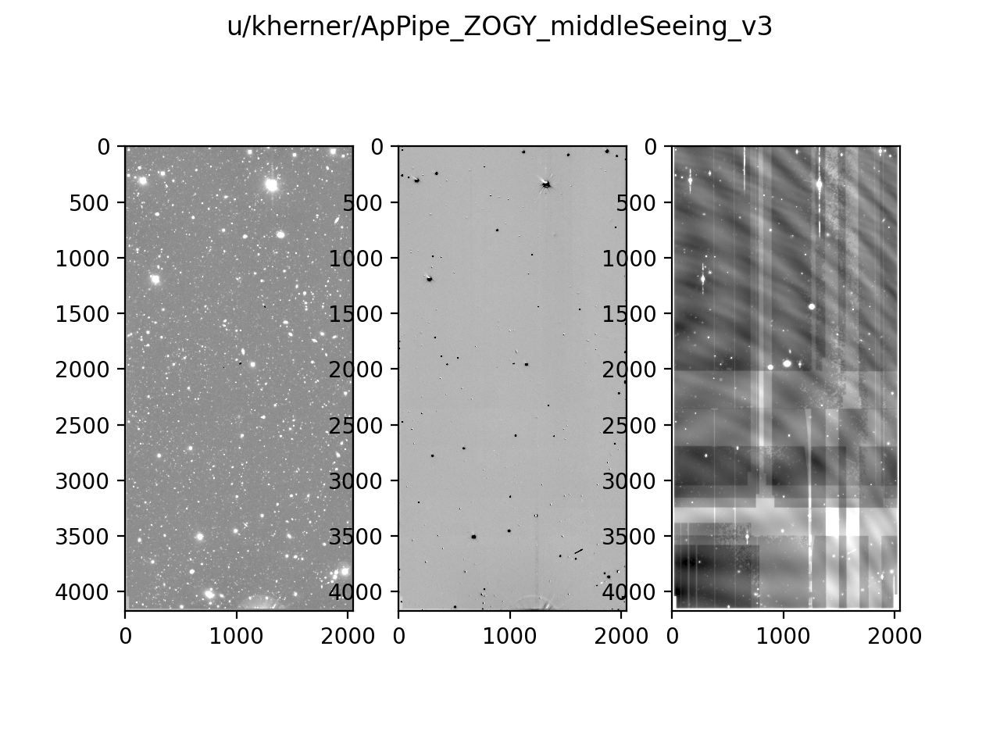

diffim variance median: 11.64479


<IPython.core.display.Javascript object>


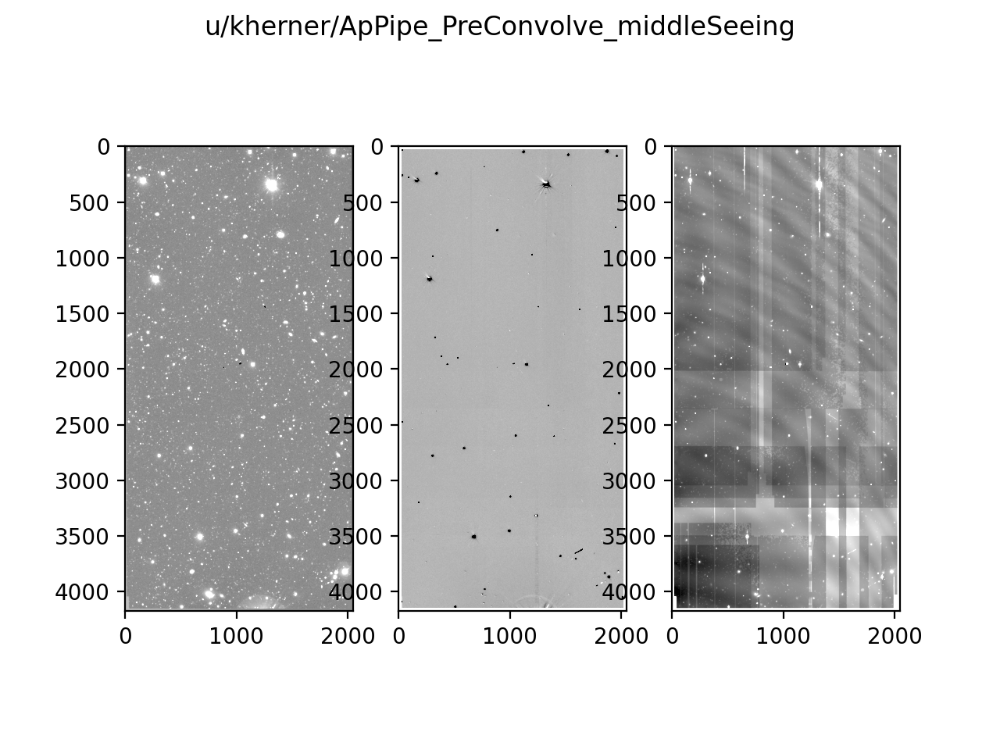

diffim variance median: 677.5049


<IPython.core.display.Javascript object>


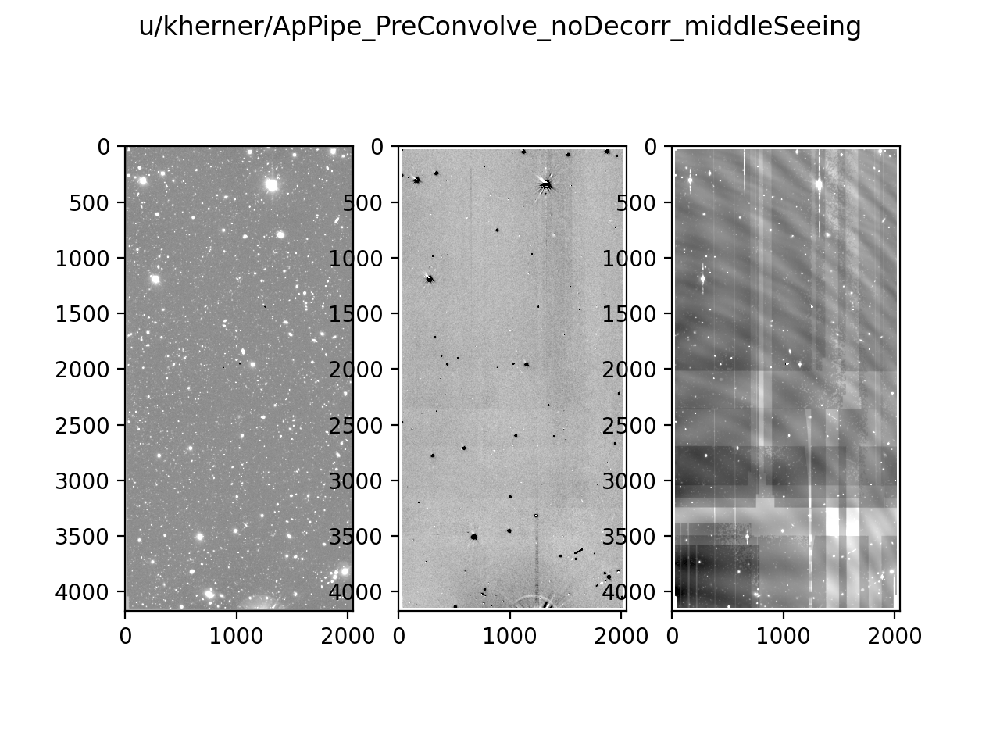

diffim variance median: 37.54929


<IPython.core.display.Javascript object>


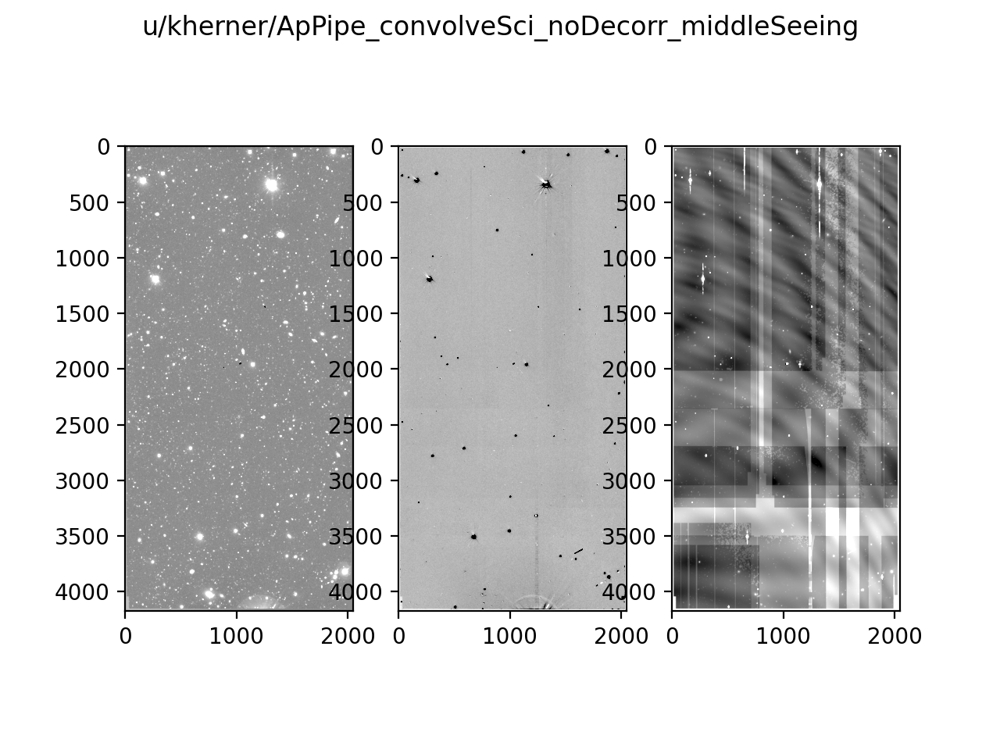

diffim variance median: 179.75383


<IPython.core.display.Javascript object>


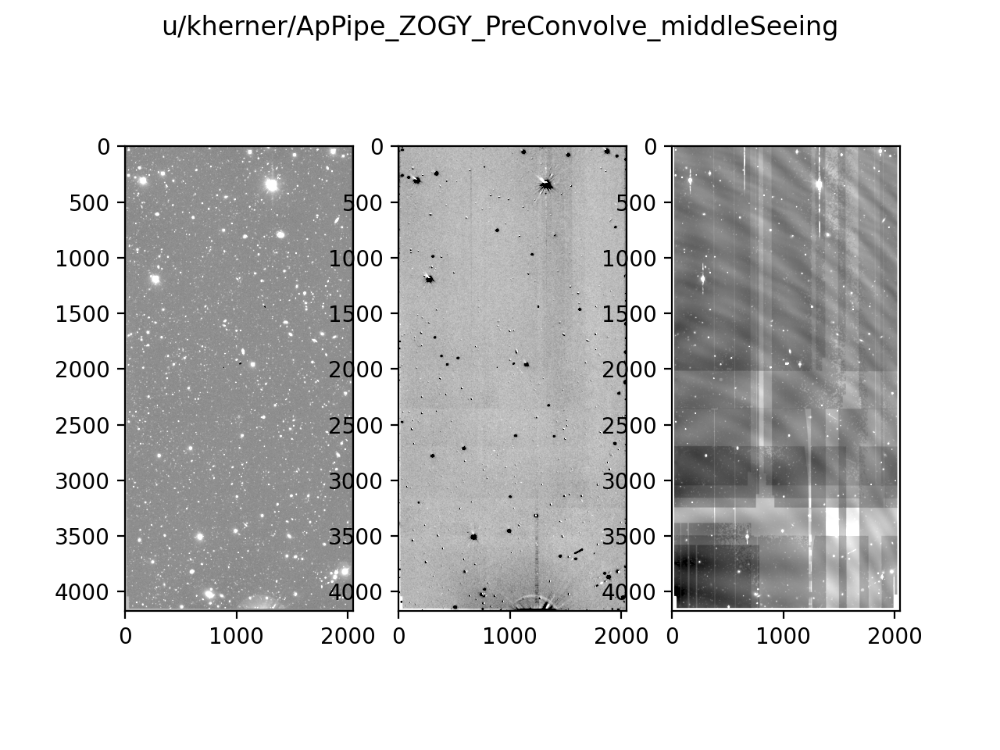

diffim variance median: 0.0039798417


In [11]:
collection_list = [default_middle.collection, zogy_middle.collection, preconvolve_middle.collection,
                   #convolvesci_middle.collection,
                   preconvolve_nodecorr_middle.collection,
                   convolvesci_nodecorr_middle.collection, zogy_preconvolve_middle.collection]

for collections in collection_list:
    calexp = butler.get('calexp', instrument='HSC',
                        visit=oneVisit, detector=oneDetector, collections=collections)
    diffim = butler.get('deepDiff_differenceExp', instrument='HSC',
                        visit=oneVisit, detector=oneDetector, collections=collections)

    calexpNorm = ImageNormalize(calexp.image.array, interval=ZScaleInterval(), stretch=SqrtStretch())
    diffimNorm = ImageNormalize(diffim.image.array, interval=ZScaleInterval(), stretch=SqrtStretch())
    diffimVarNorm = ImageNormalize(diffim.variance.array, interval=ZScaleInterval(), stretch=SqrtStretch())

    fig, (ax1, ax2, ax3) = plt.subplots(1, 3)
    fig.suptitle(collections)
    ax1.imshow(calexp.image.array, cmap='gray', norm=calexpNorm)
    ax2.imshow(diffim.image.array, cmap='gray', norm=diffimNorm)
    ax3.imshow(diffim.variance.array, cmap='gray', norm=diffimVarNorm)
    
    print('diffim variance median:', np.median(diffim.variance.array))

## And once more, for worst seeing templates

<IPython.core.display.Javascript object>


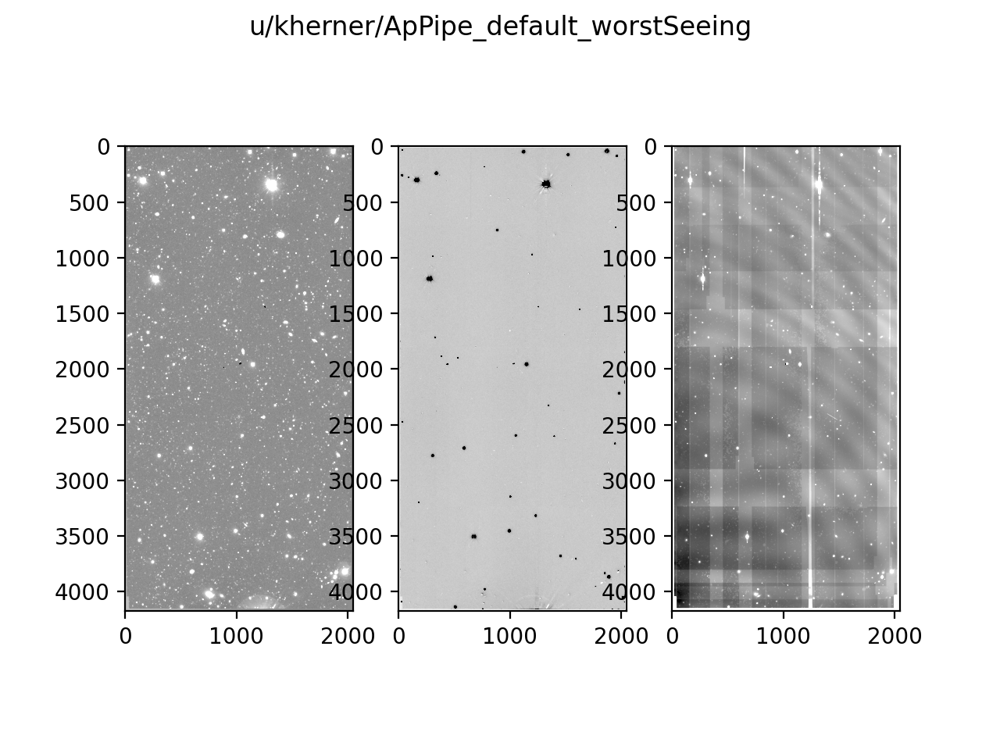

diffim variance median: 705.6452


<IPython.core.display.Javascript object>


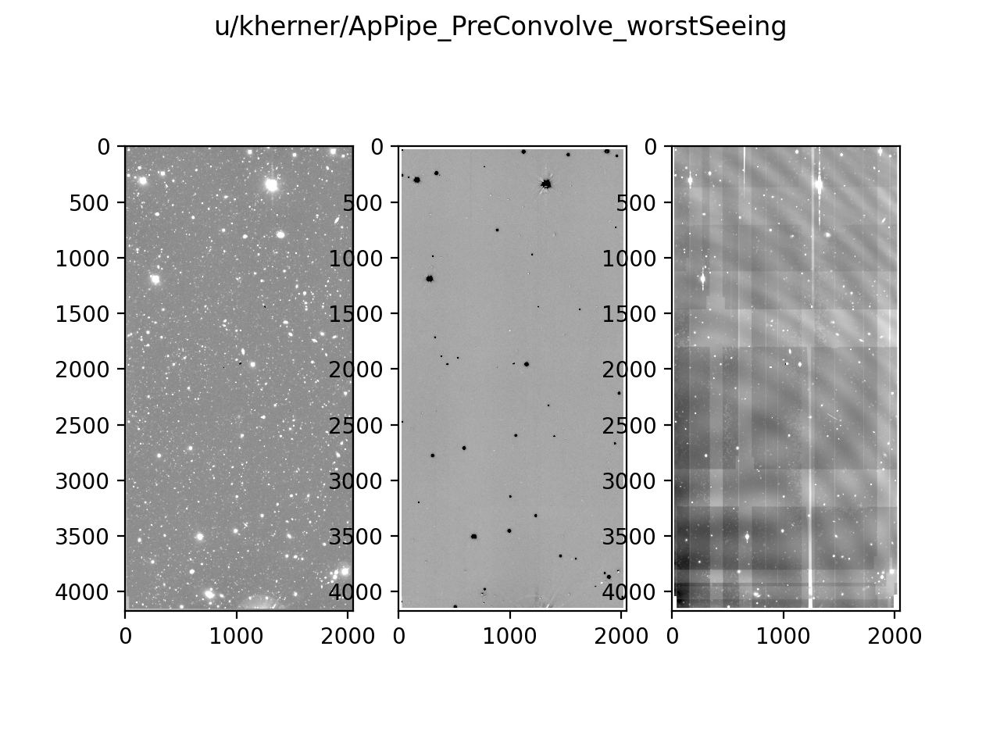

diffim variance median: 614.709


<IPython.core.display.Javascript object>


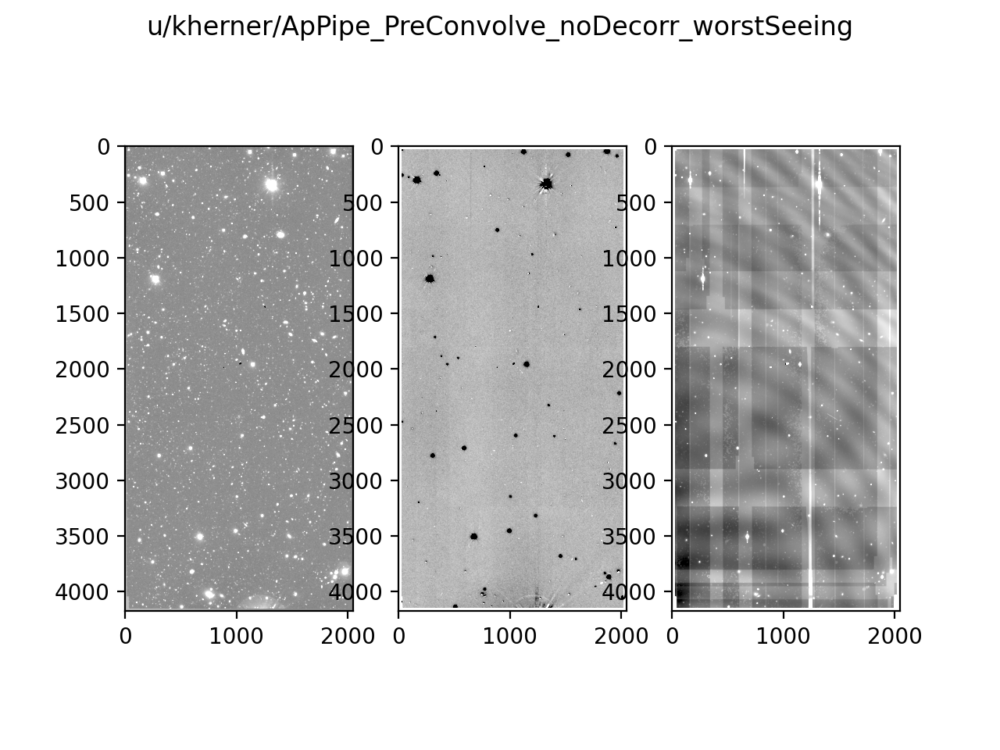

diffim variance median: 42.619278


<IPython.core.display.Javascript object>


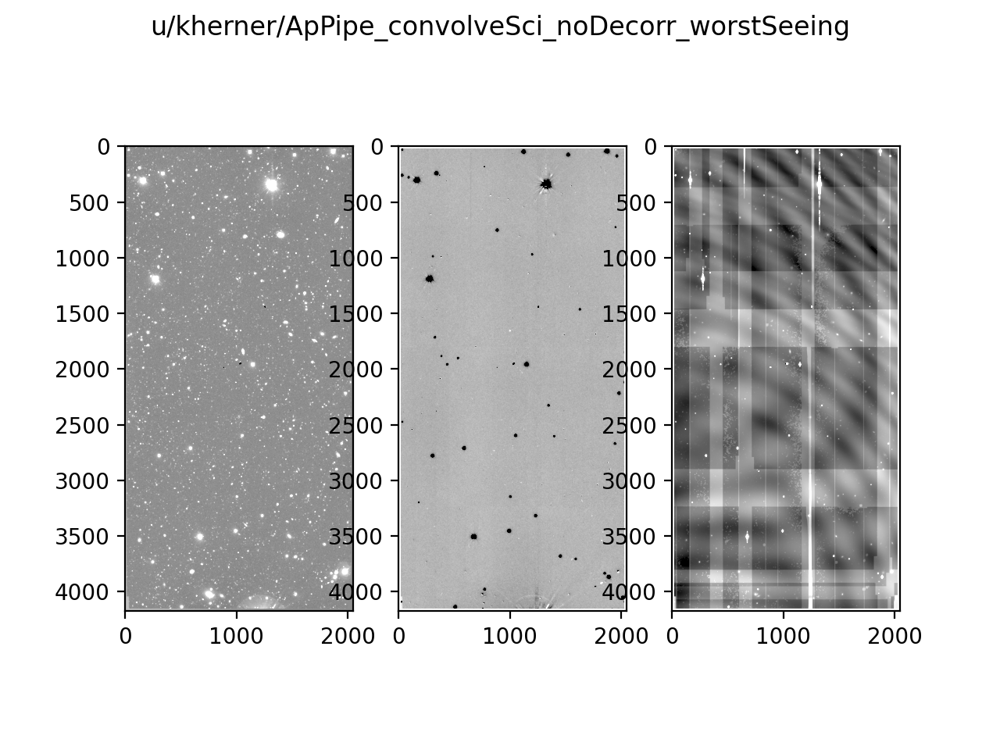

diffim variance median: 123.8052


In [14]:
collection_list = [default_worst.collection, #zogy_worst.collection,
                   preconvolve_worst.collection,
                   #convolvesci_worst.collection,
                   preconvolve_nodecorr_worst.collection,
                   convolvesci_nodecorr_worst.collection] #, zogy_preconvolve_worst.collection]

for collections in collection_list:
    calexp = butler.get('calexp', instrument='HSC',
                        visit=oneVisit, detector=oneDetector, collections=collections)
    diffim = butler.get('deepDiff_differenceExp', instrument='HSC',
                        visit=oneVisit, detector=oneDetector, collections=collections)

    calexpNorm = ImageNormalize(calexp.image.array, interval=ZScaleInterval(), stretch=SqrtStretch())
    diffimNorm = ImageNormalize(diffim.image.array, interval=ZScaleInterval(), stretch=SqrtStretch())
    diffimVarNorm = ImageNormalize(diffim.variance.array, interval=ZScaleInterval(), stretch=SqrtStretch())

    fig, (ax1, ax2, ax3) = plt.subplots(1, 3)
    fig.suptitle(collections)
    ax1.imshow(calexp.image.array, cmap='gray', norm=calexpNorm)
    ax2.imshow(diffim.image.array, cmap='gray', norm=diffimNorm)
    ax3.imshow(diffim.variance.array, cmap='gray', norm=diffimVarNorm)
    
    print('diffim variance median:', np.median(diffim.variance.array))

## Adjust which flags to mark as bad

Current default is just bad, suspect, and saturatedCenter. Quick-look analysis suggests adding interpolated, interpolatedCenter, and edge is reasonable as well. Of course this doesn't automatically get rid of all the bad sources.

In [7]:
badFlagList = ['base_PixelFlags_flag_bad',
               'base_PixelFlags_flag_suspect',
               'base_PixelFlags_flag_saturatedCenter',
               'base_PixelFlags_flag_interpolated',
               'base_PixelFlags_flag_interpolatedCenter',
               'base_PixelFlags_flag_edge',
              ]

## Make key plots for all the runs
Not all of the runs that made it through image differencing managed to successfully write to the APDB. Those bugs will be tracked down on followup tickets.

Here, I'll construct `run_list` to showcase ones with best-seeing templates by default, and showcase ones with worst-seeing templates in the case differencing was run with preconvolution **or** science image convolution (instead of template convolution).

The commented-out runs below have empty APDBs.

In [11]:
run_list = [default_best,  # A&L default settings, best-seeing templates
            zogy_best,  # zogy default settings, best-seeing templates
            preconvolve_worst,  # A&L with preconvolution of science image, worst-seeing templates
            #preconvolve_nodecorr_worst,  # A&L with preconvolution of science image and no decorrelation afterburner, worst-seeing templates
            convolvesci_best,  # A&L with science image convolved instead of template [only done for best-seeing templates]
            convolvesci_nodecorr_worst,  # A&L with science image convolved instead of template and no decorrelation afterurner, worst-seeing templates
            #zogy_preconvolve_worst,  # zogy with preconvolution of science image, worst-seeing templates  
            ]

u/kherner/ApPipe_default_bestSeeing /project/kherner/diffim_sprint_2021-02/bps_testing/bps_default_best.db


<IPython.core.display.Javascript object>


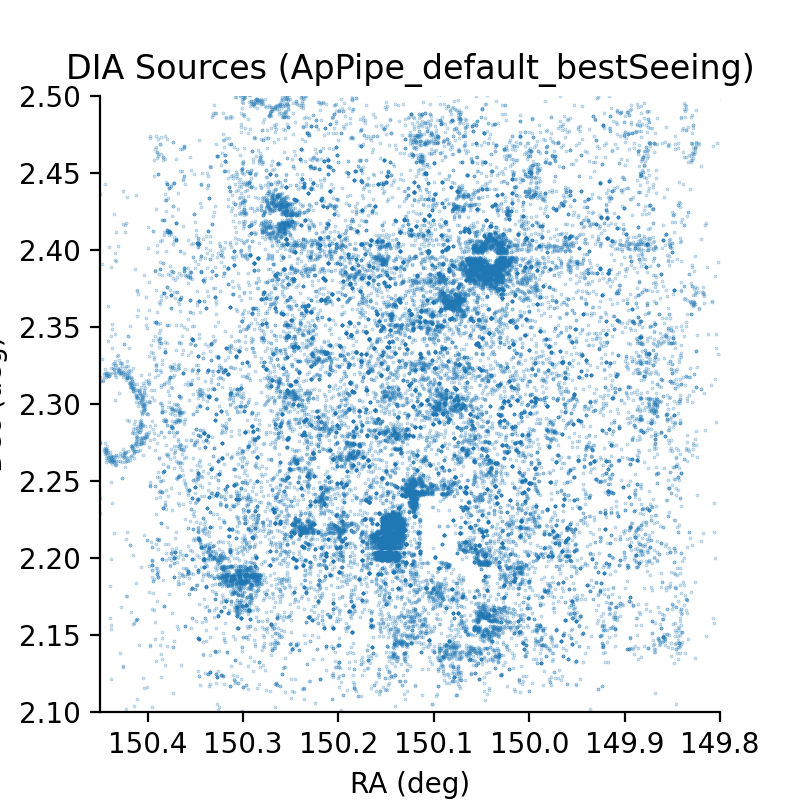

<IPython.core.display.Javascript object>


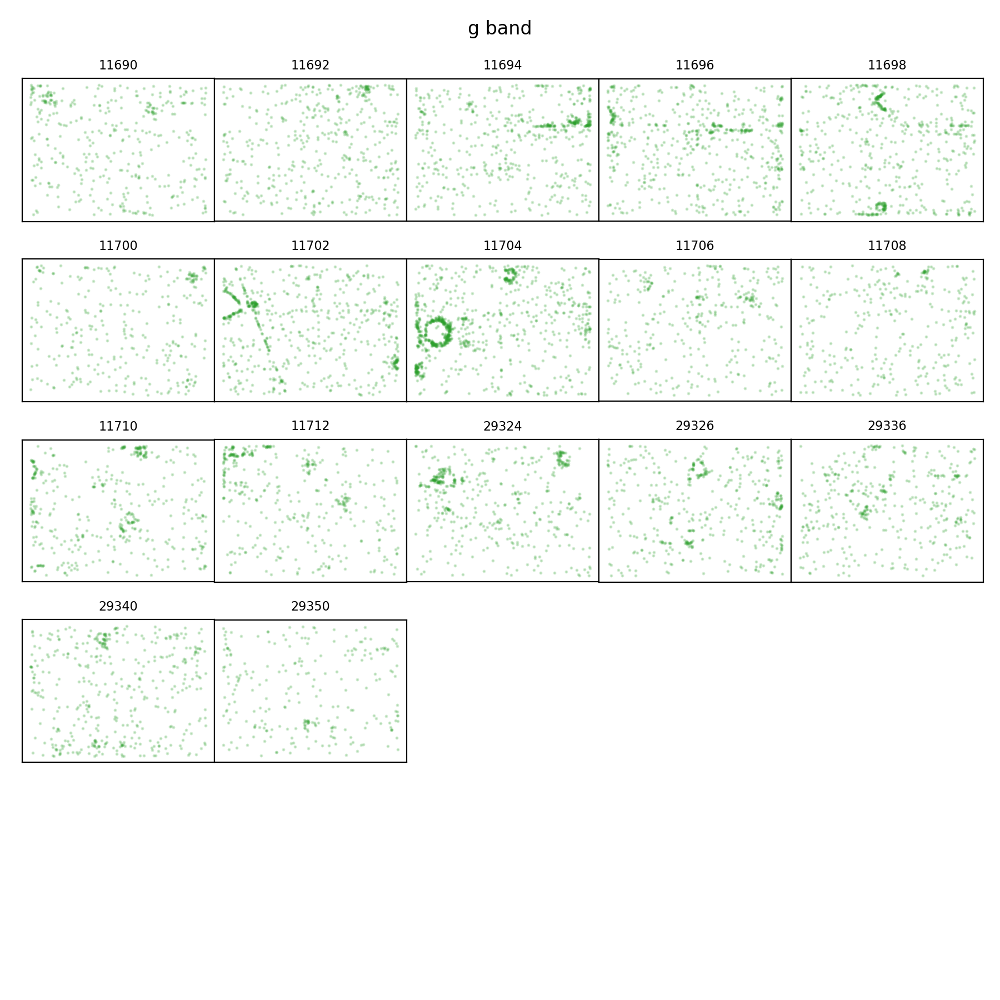

<IPython.core.display.Javascript object>


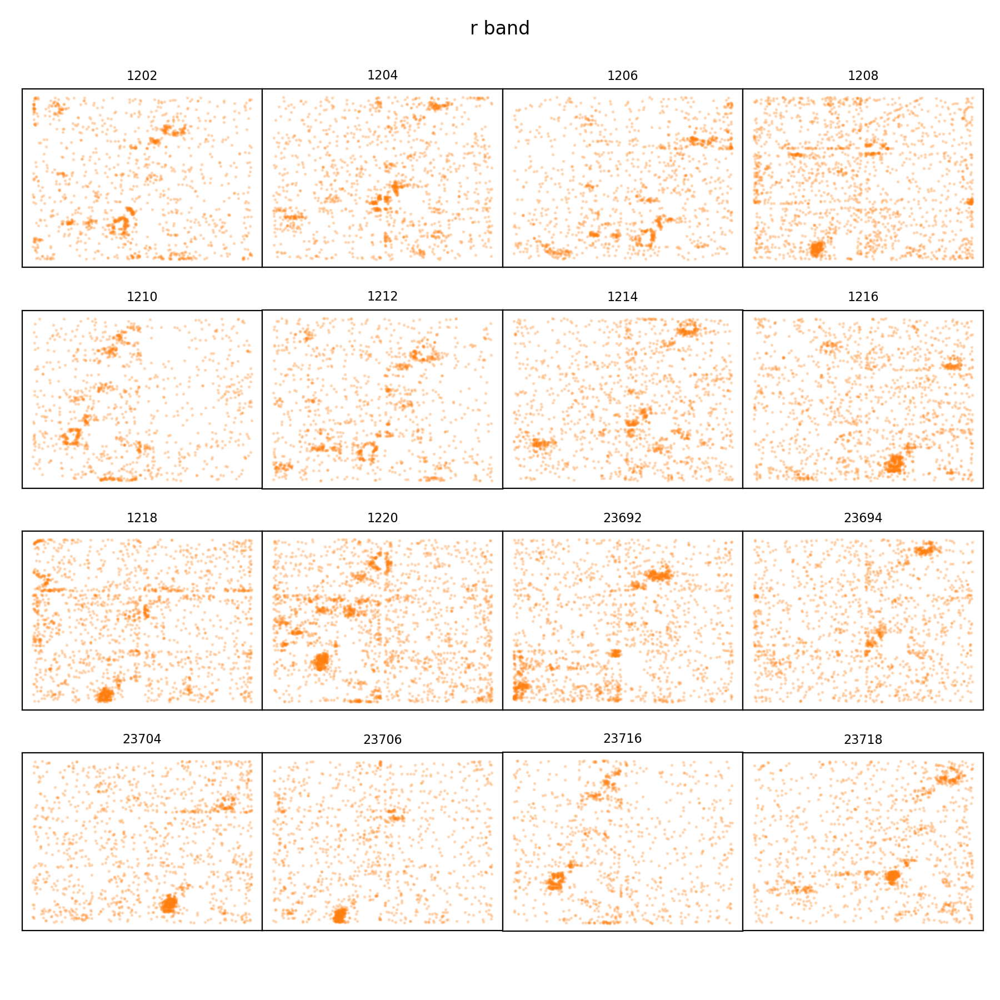

<IPython.core.display.Javascript object>


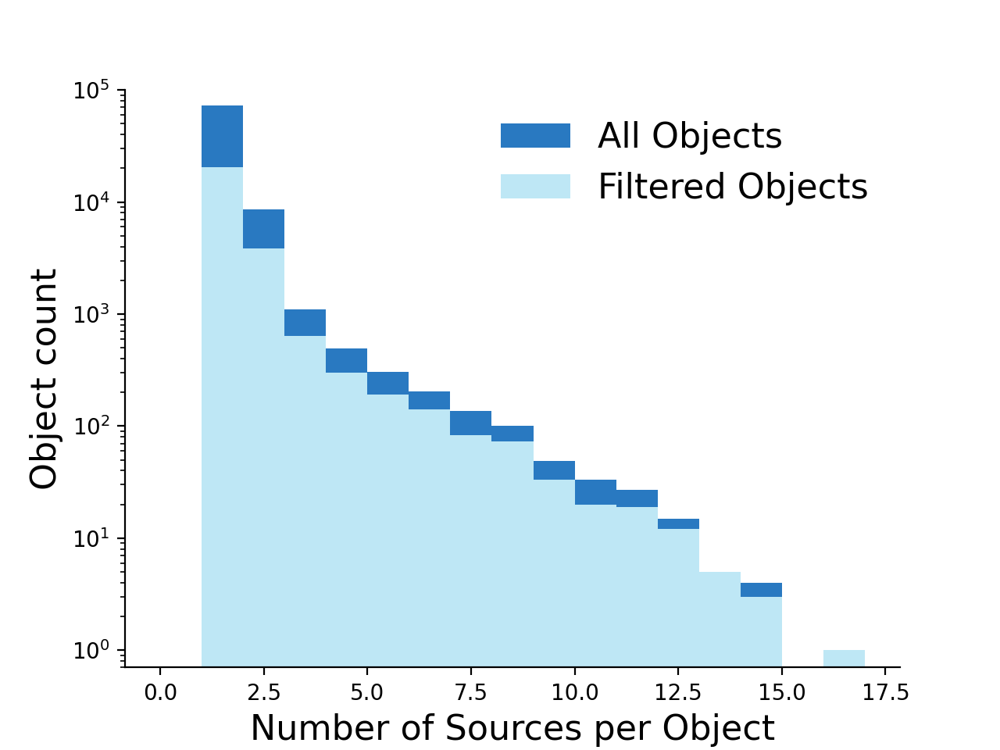

<IPython.core.display.Javascript object>


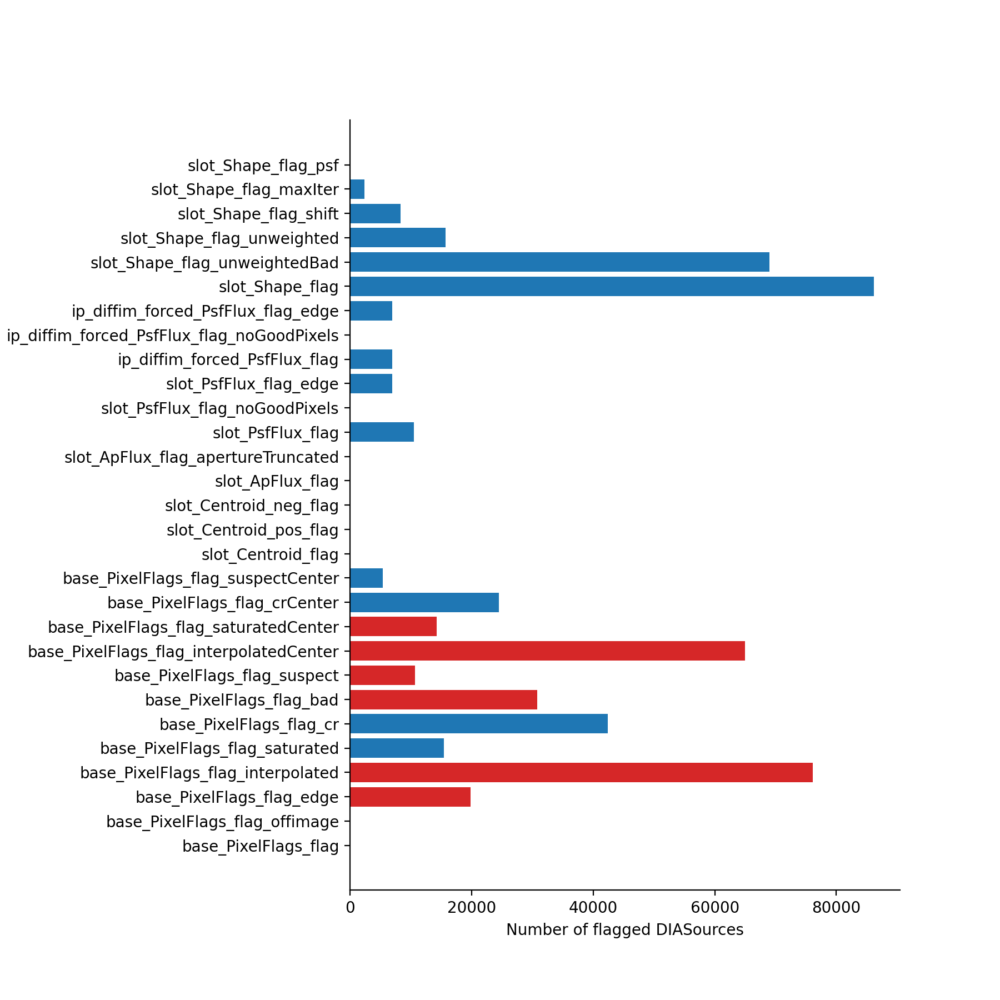

<IPython.core.display.Javascript object>


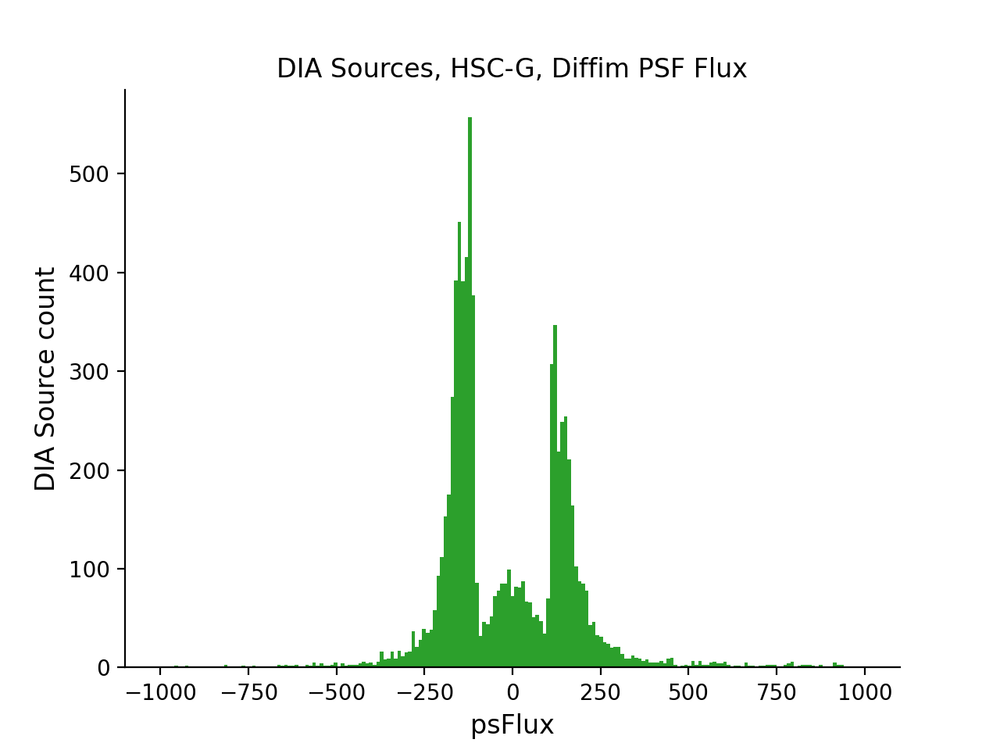

<IPython.core.display.Javascript object>


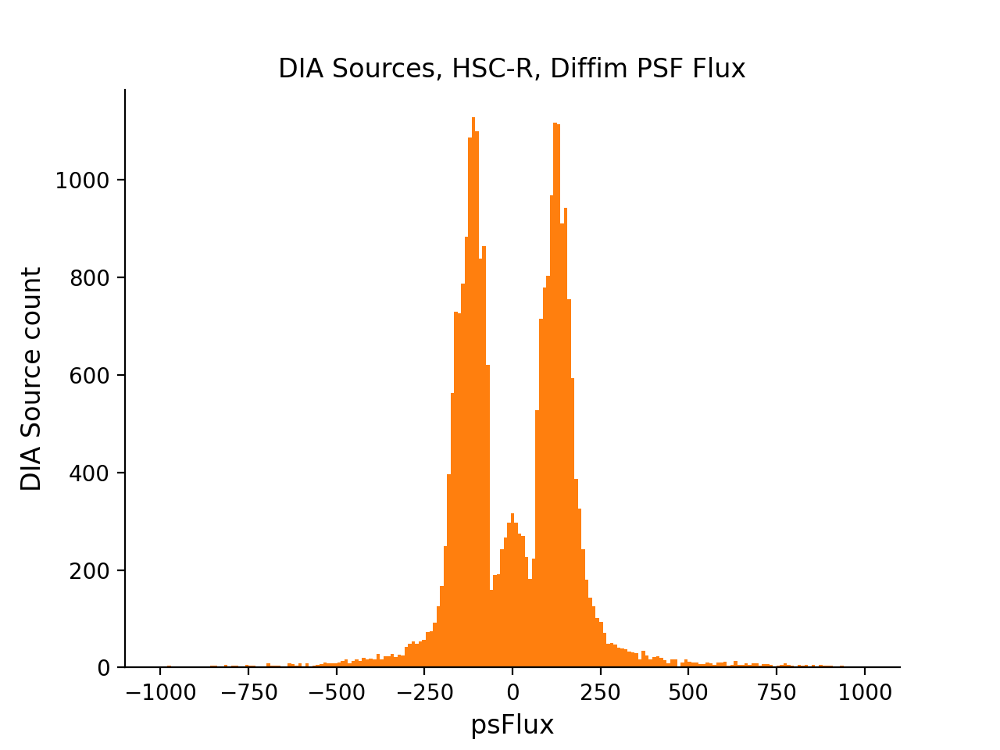

<IPython.core.display.Javascript object>


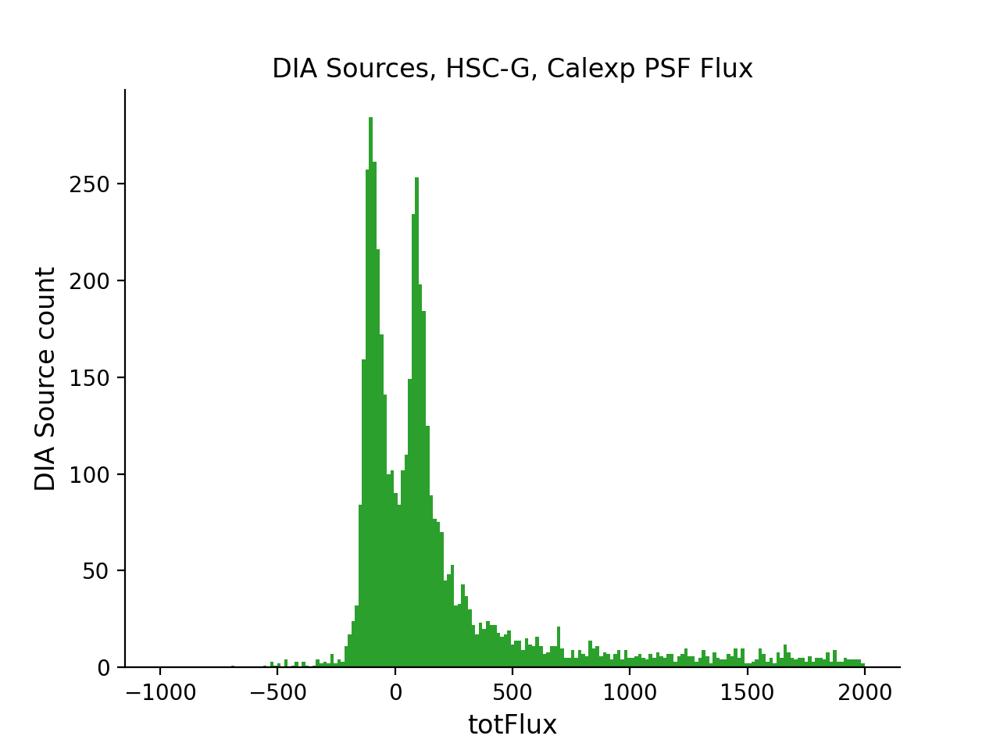

<IPython.core.display.Javascript object>


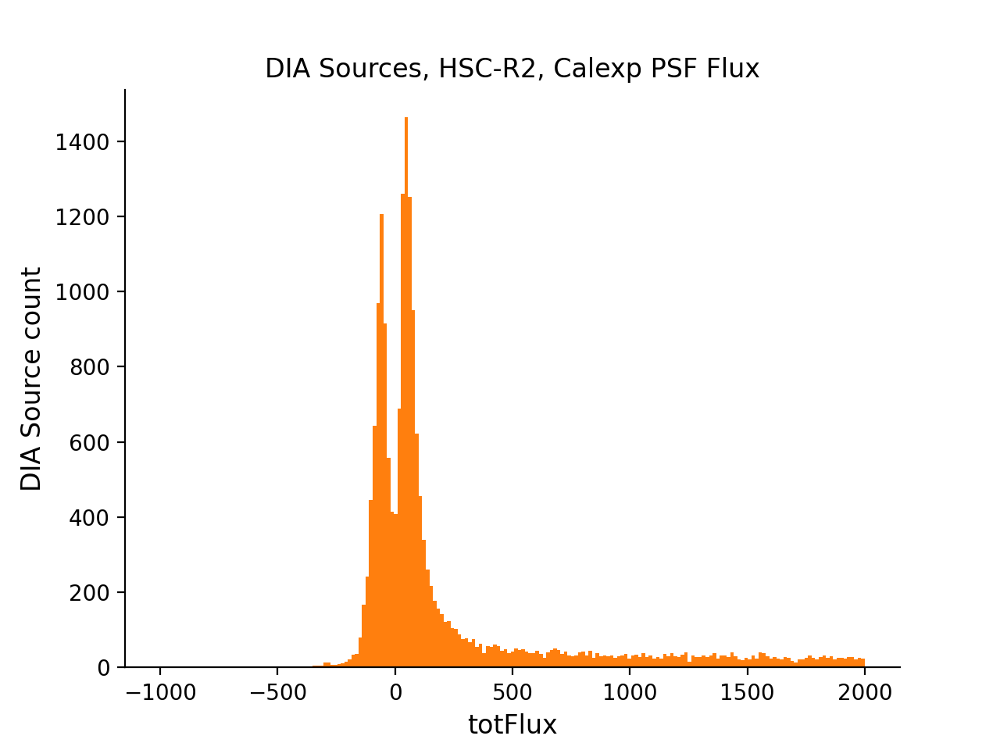

<IPython.core.display.Javascript object>


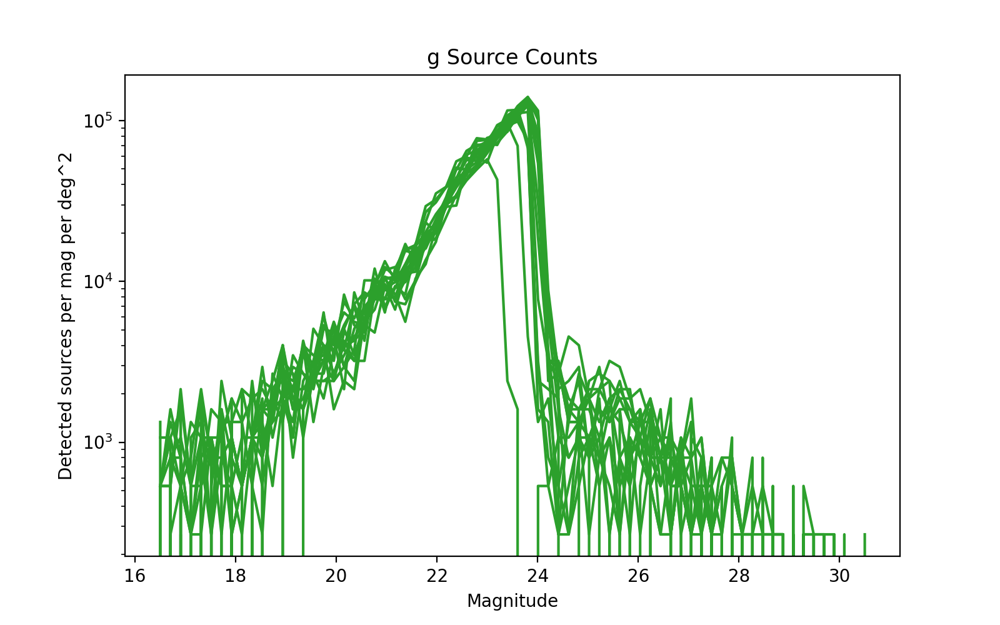

<IPython.core.display.Javascript object>


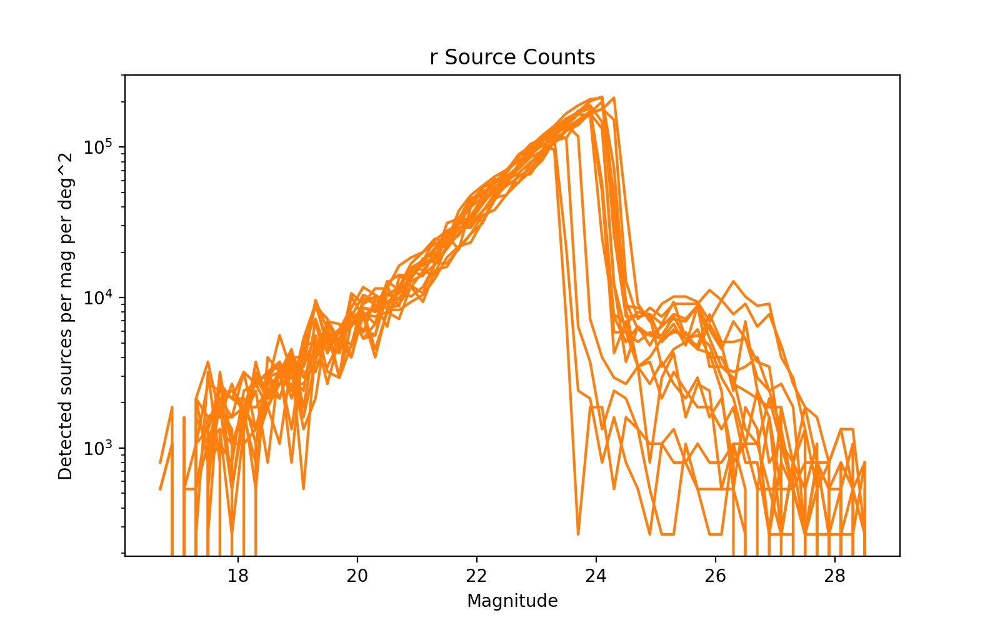

<IPython.core.display.Javascript object>


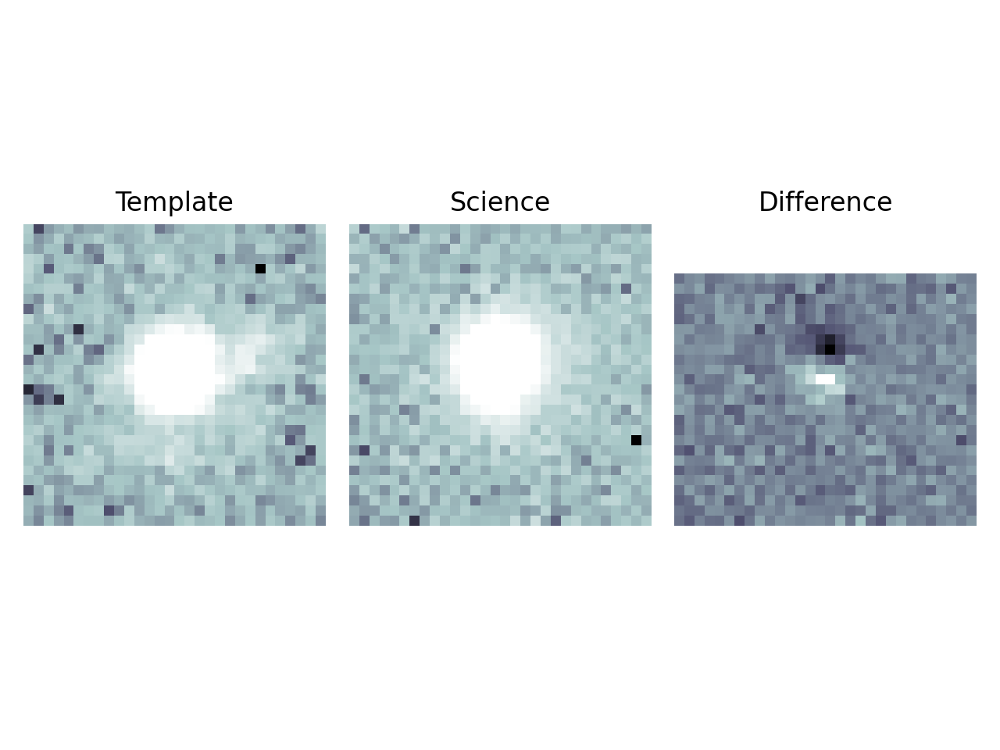

<IPython.core.display.Javascript object>


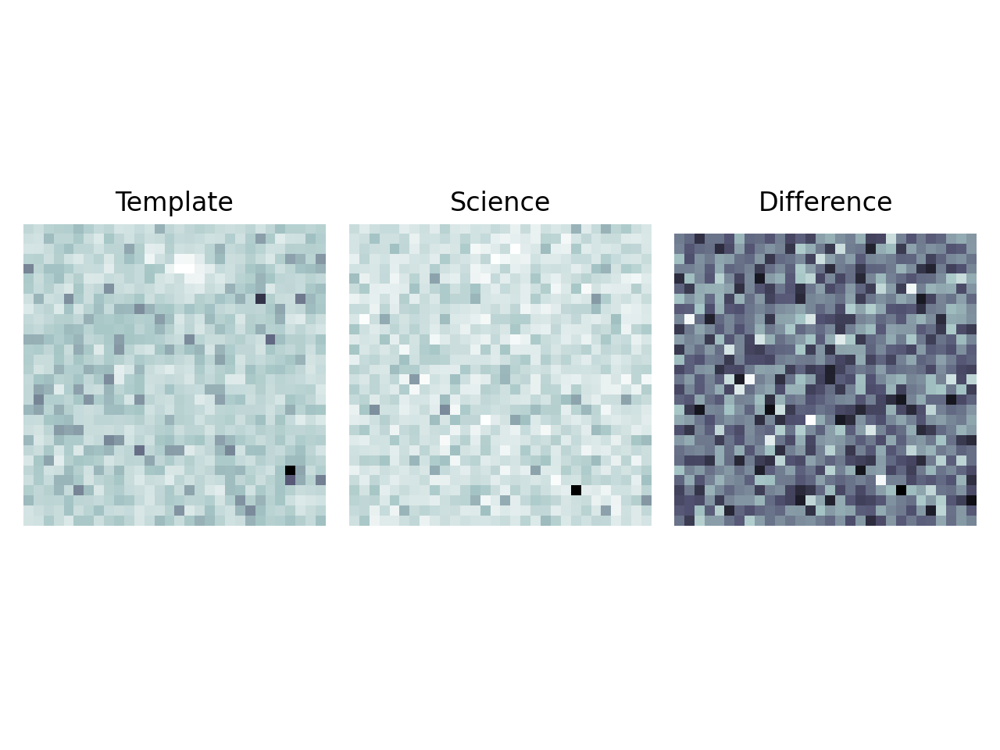

<IPython.core.display.Javascript object>


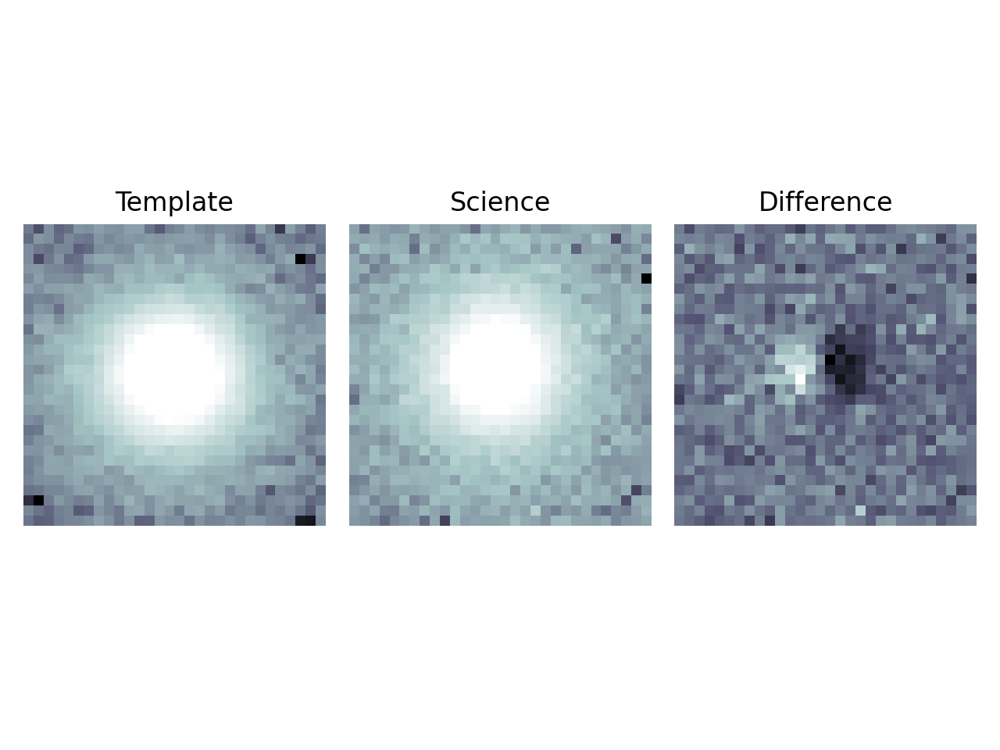

<IPython.core.display.Javascript object>


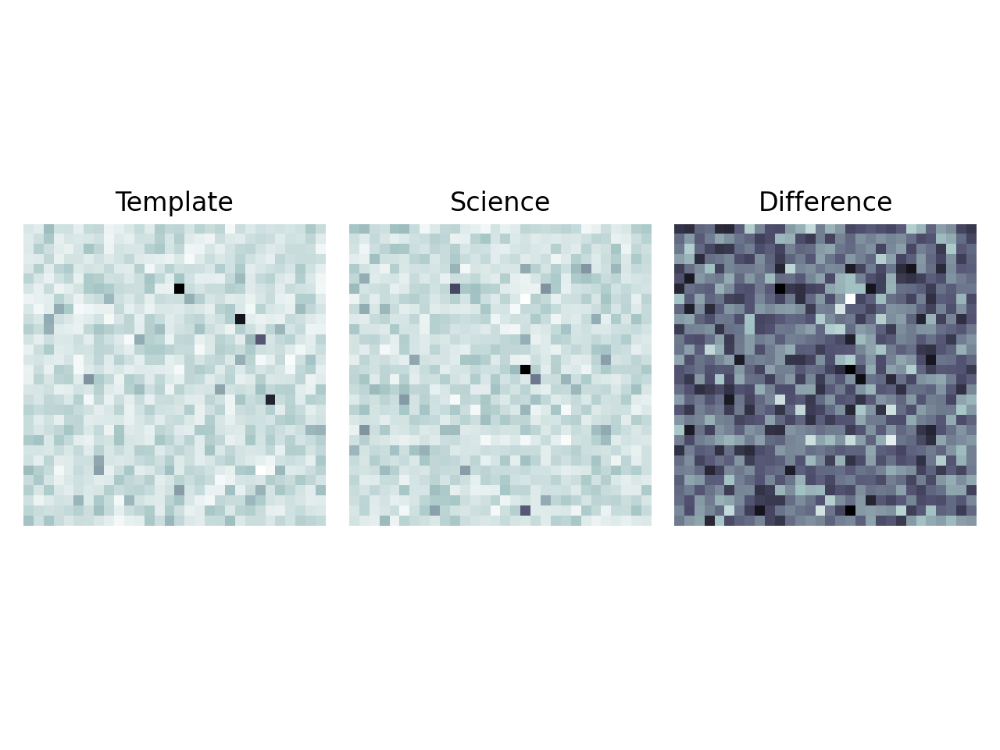

u/kherner/ApPipe_ZOGY_bestSeeing_v3 /project/kherner/diffim_sprint_2021-02/bps_testing/bps_ZOGY_FULL_best3.db


<IPython.core.display.Javascript object>


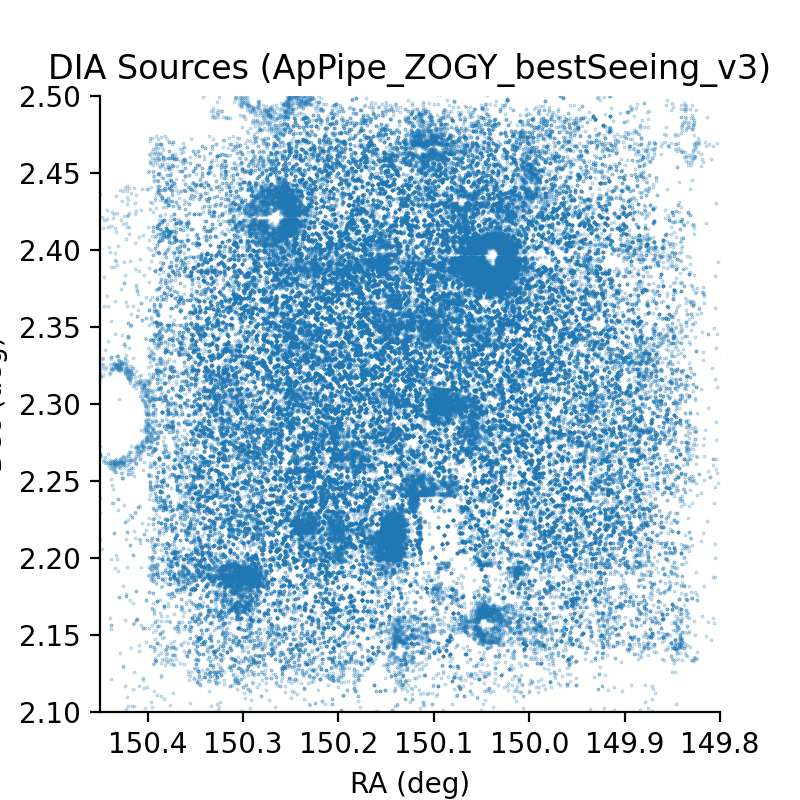

<IPython.core.display.Javascript object>


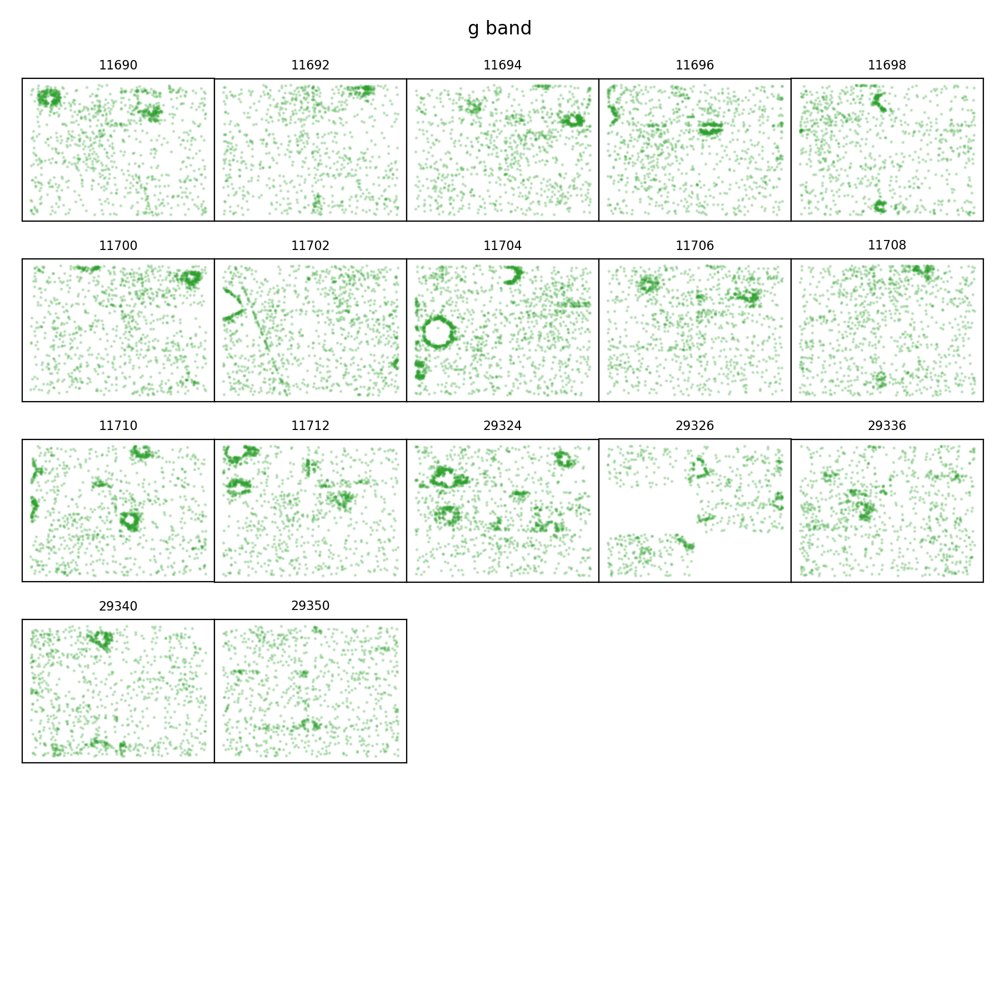

<IPython.core.display.Javascript object>


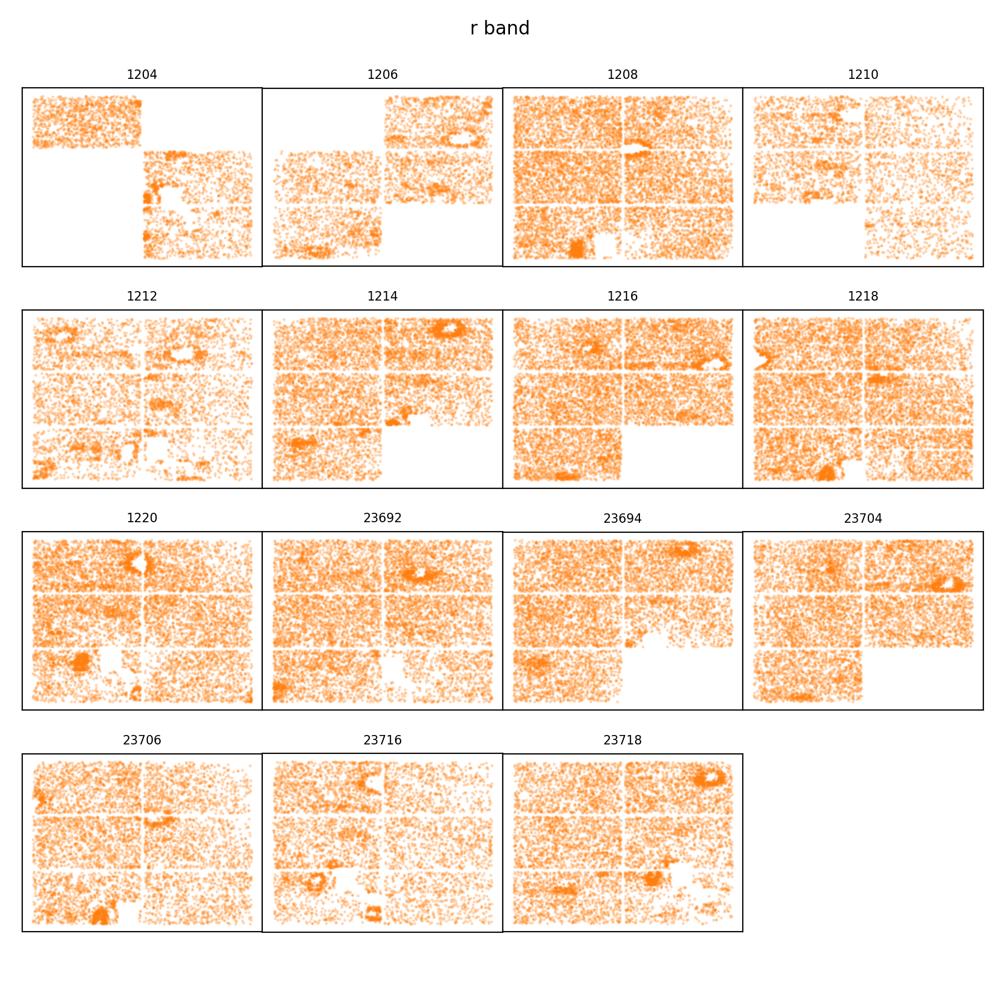

<IPython.core.display.Javascript object>


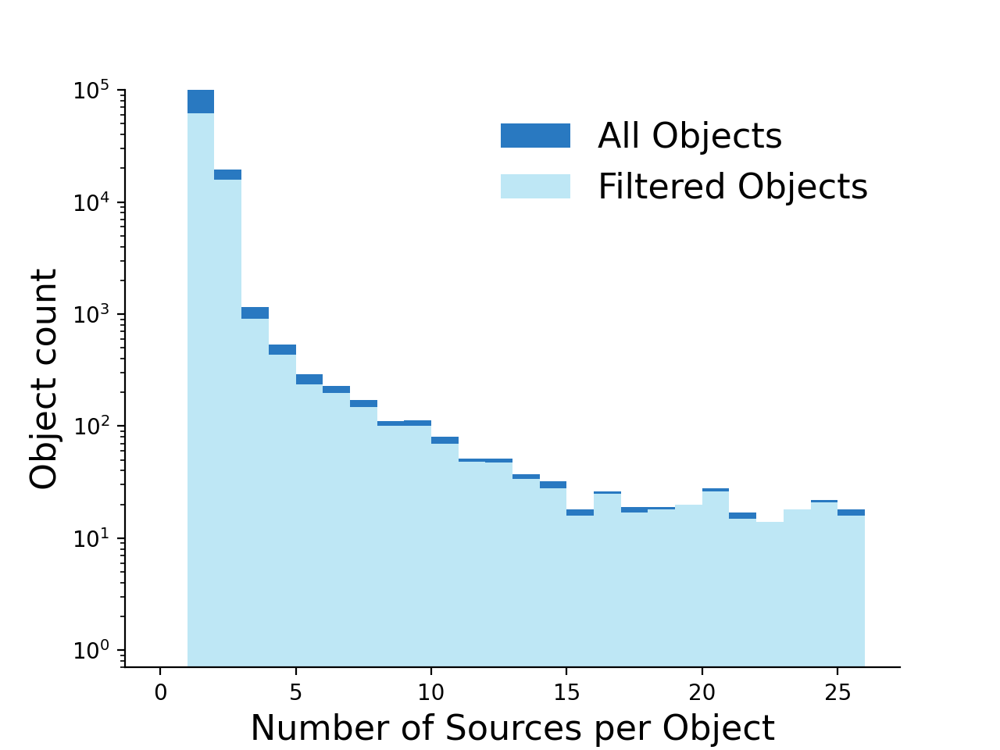

<IPython.core.display.Javascript object>


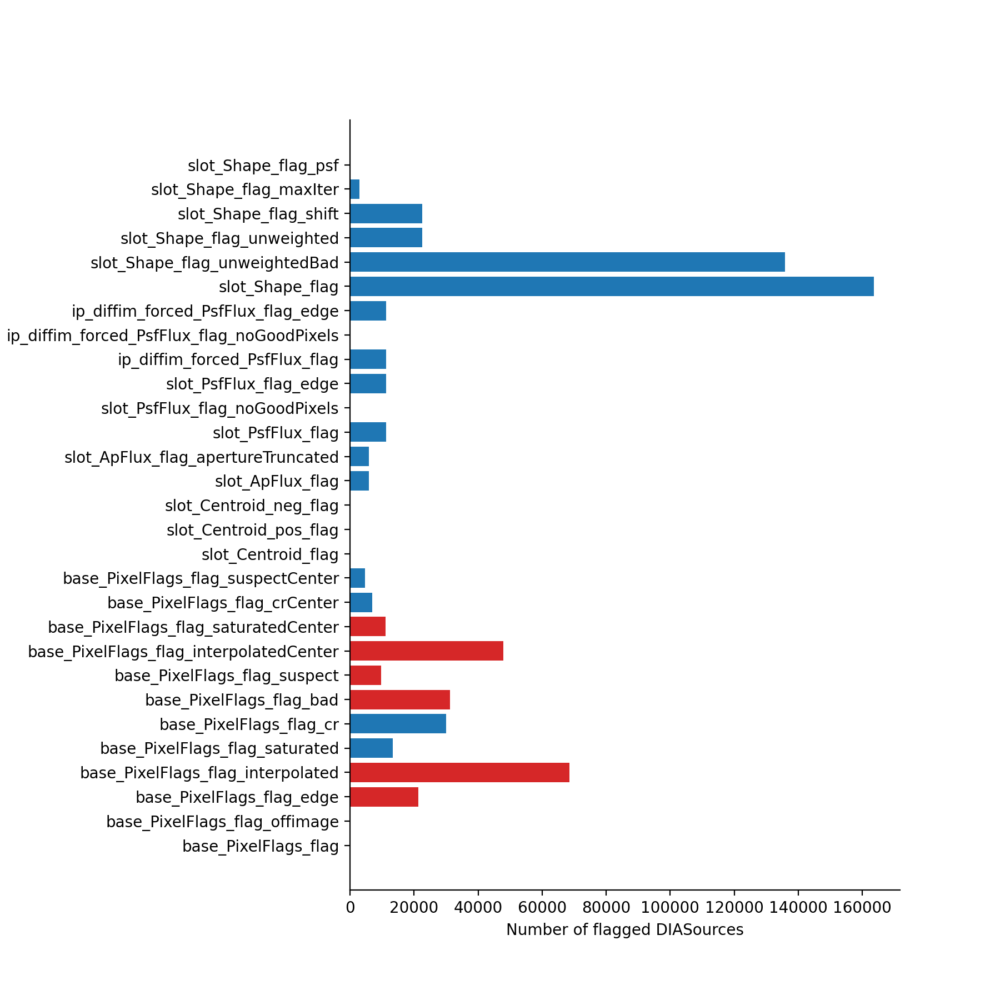

<IPython.core.display.Javascript object>


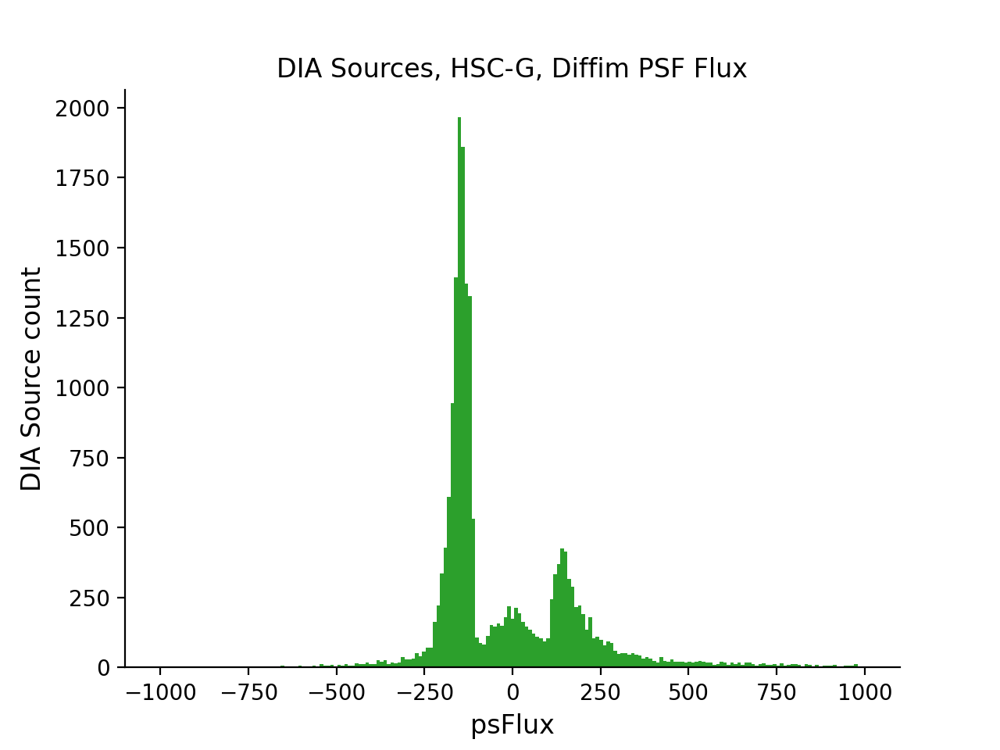

<IPython.core.display.Javascript object>


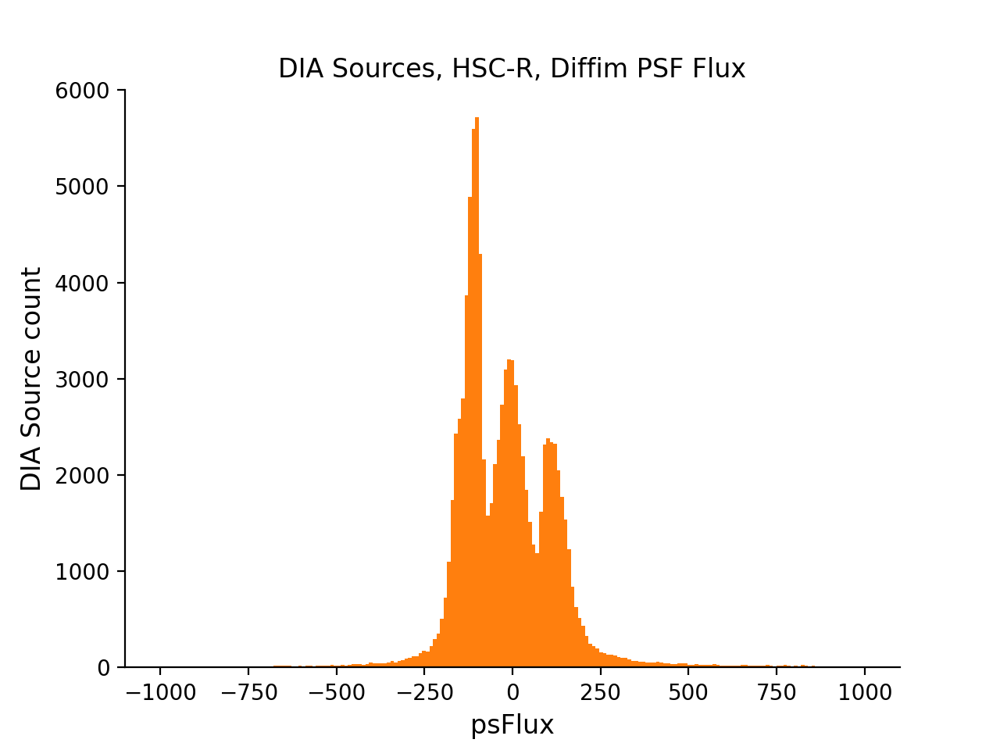

<IPython.core.display.Javascript object>


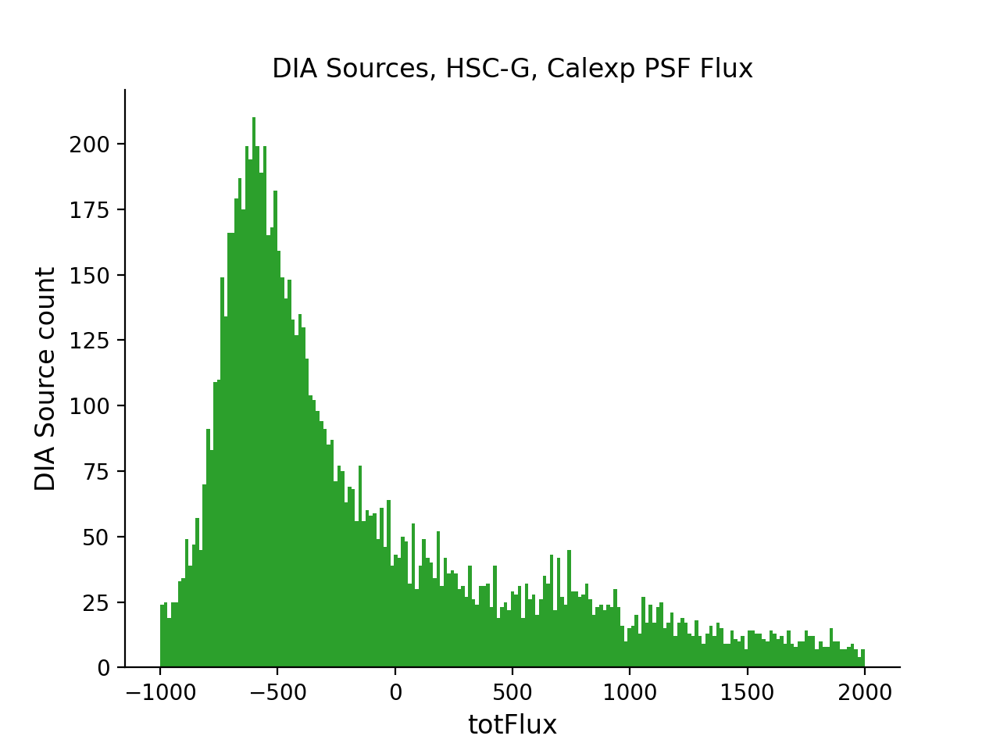

<IPython.core.display.Javascript object>


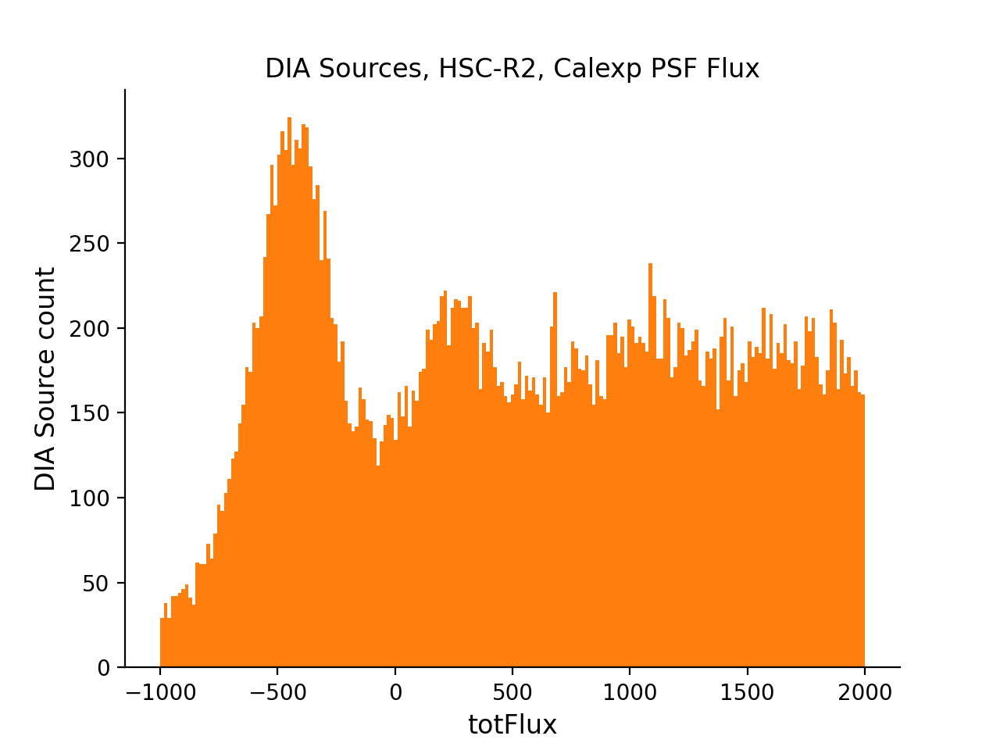

<IPython.core.display.Javascript object>


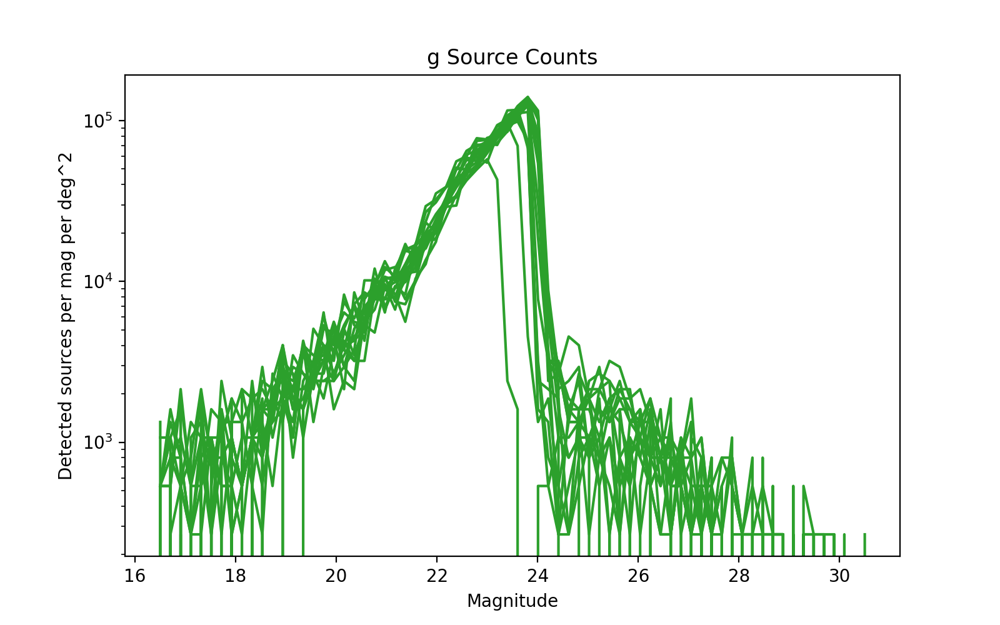

<IPython.core.display.Javascript object>


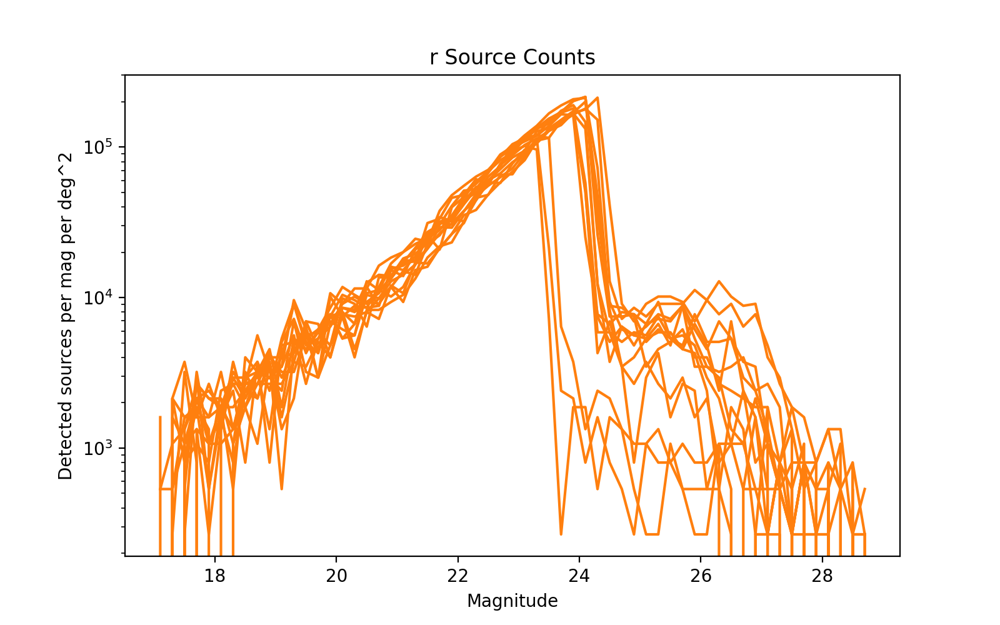

<IPython.core.display.Javascript object>


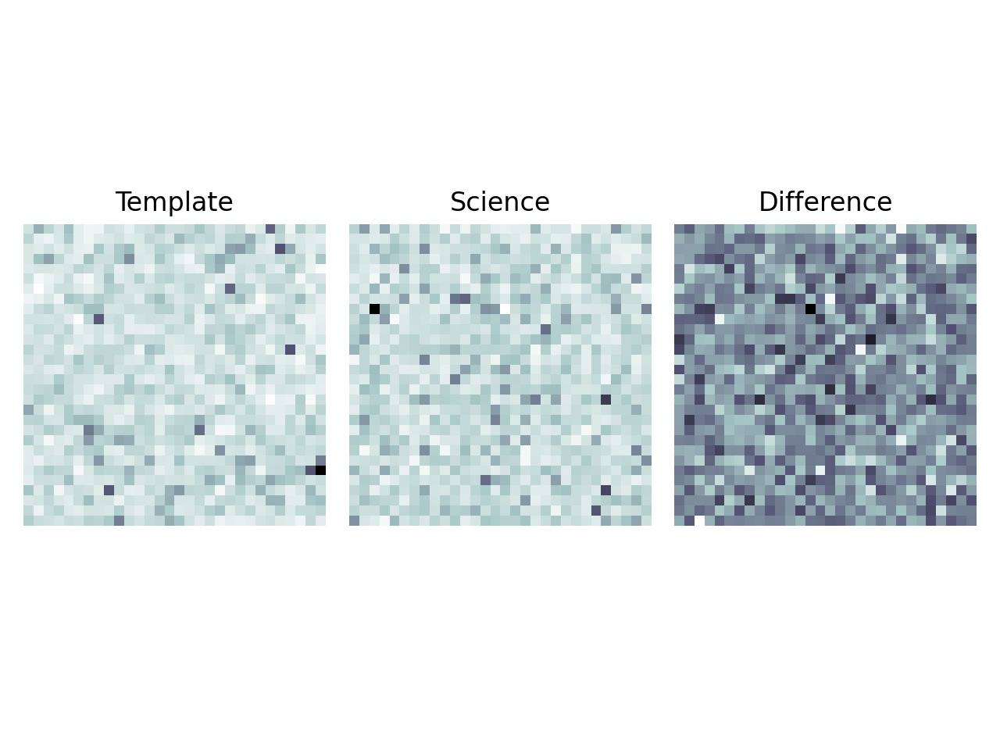

<IPython.core.display.Javascript object>


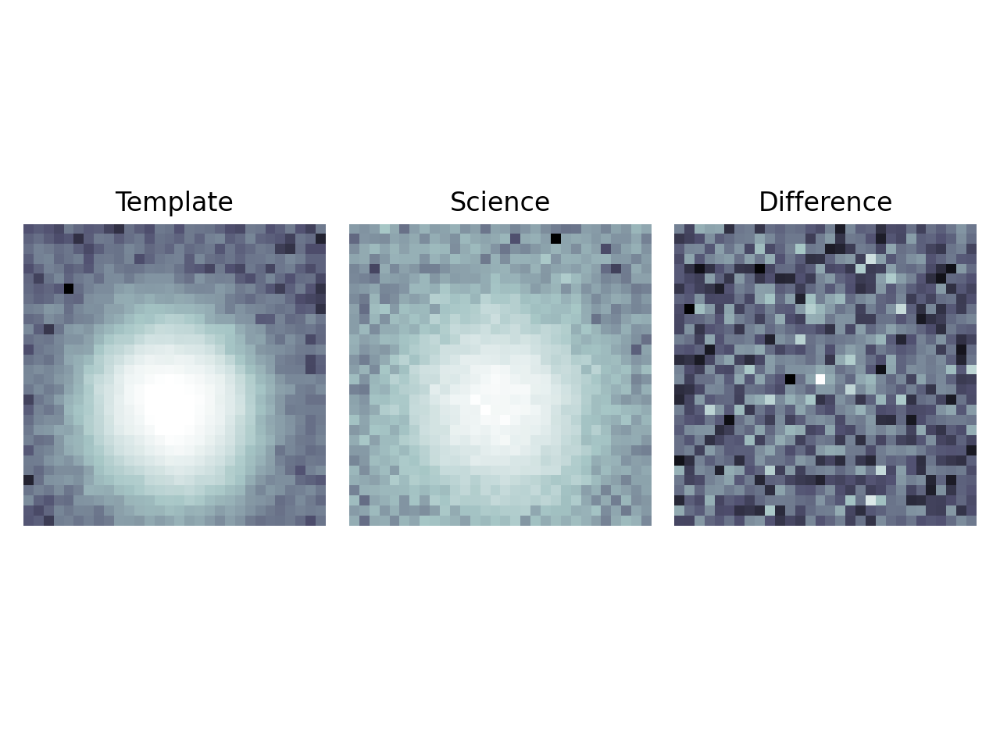

<IPython.core.display.Javascript object>


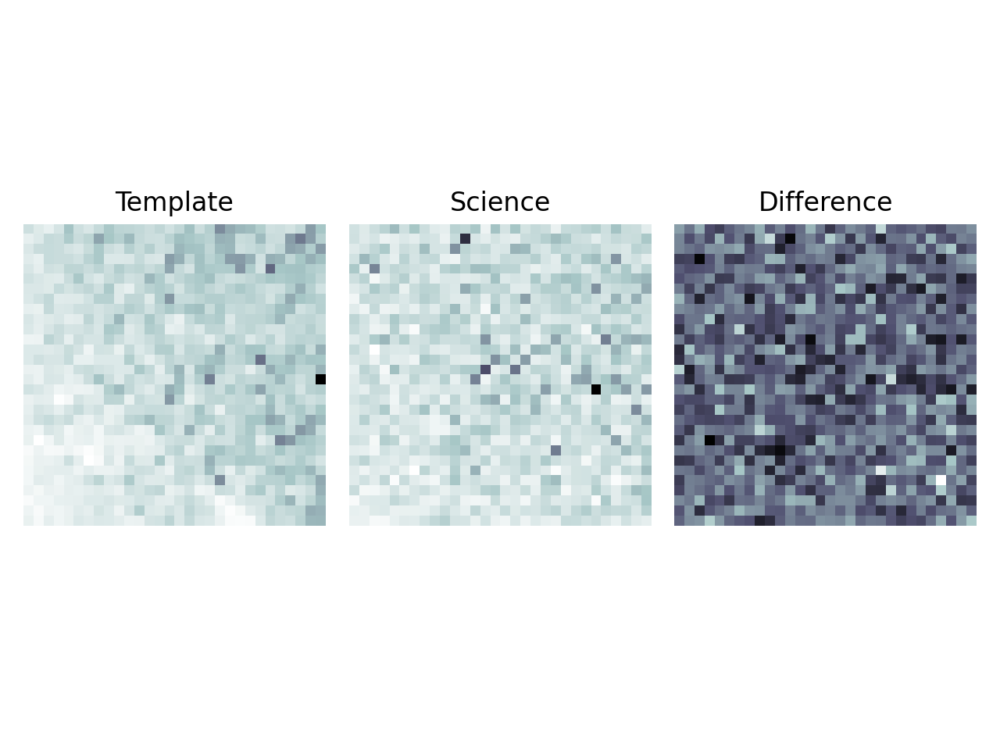

<IPython.core.display.Javascript object>


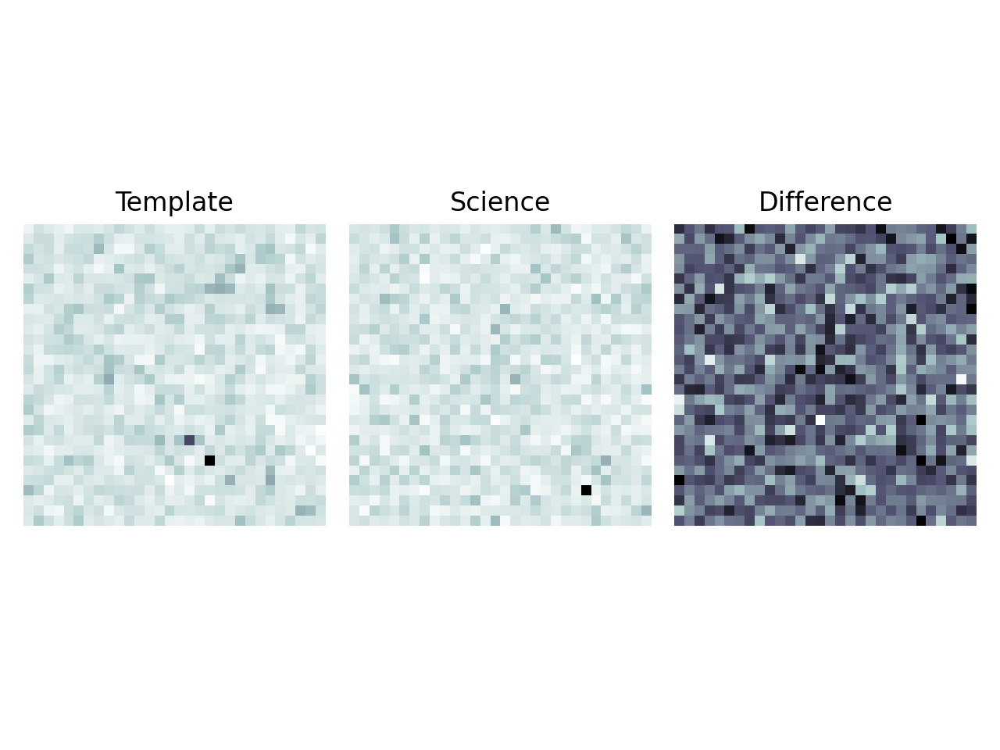

u/kherner/ApPipe_PreConvolve_worstSeeing /project/kherner/diffim_sprint_2021-02/bps_testing/bps_PreConvolve_worst.db


<IPython.core.display.Javascript object>


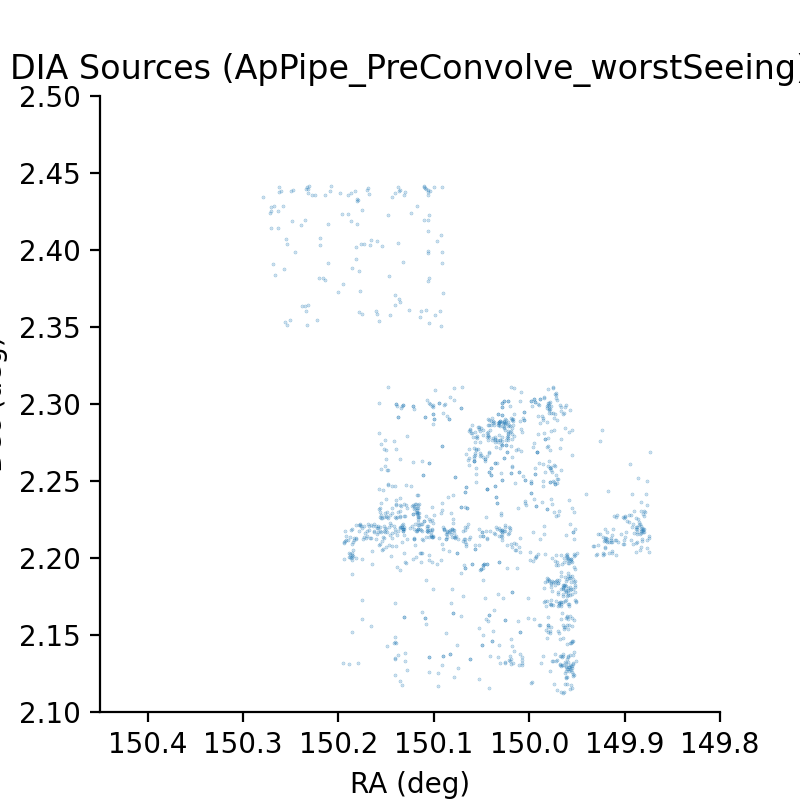

<IPython.core.display.Javascript object>


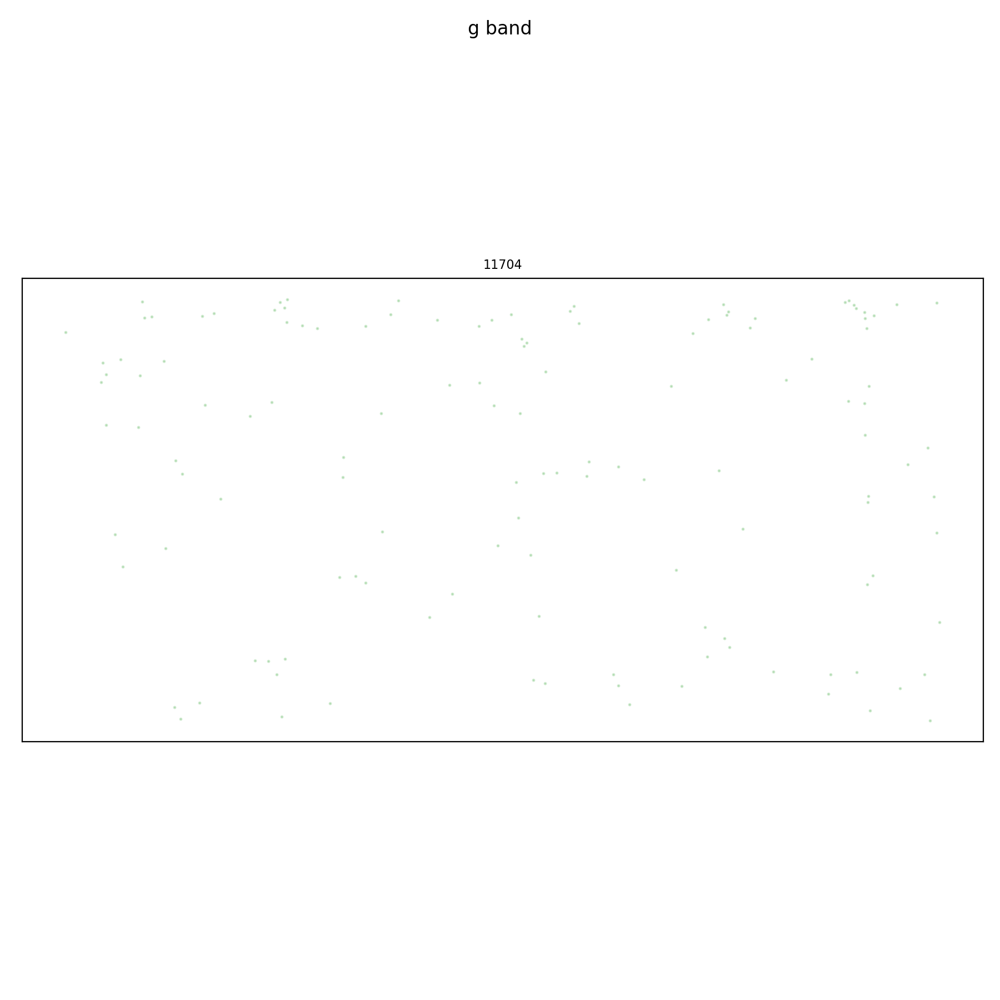

<IPython.core.display.Javascript object>


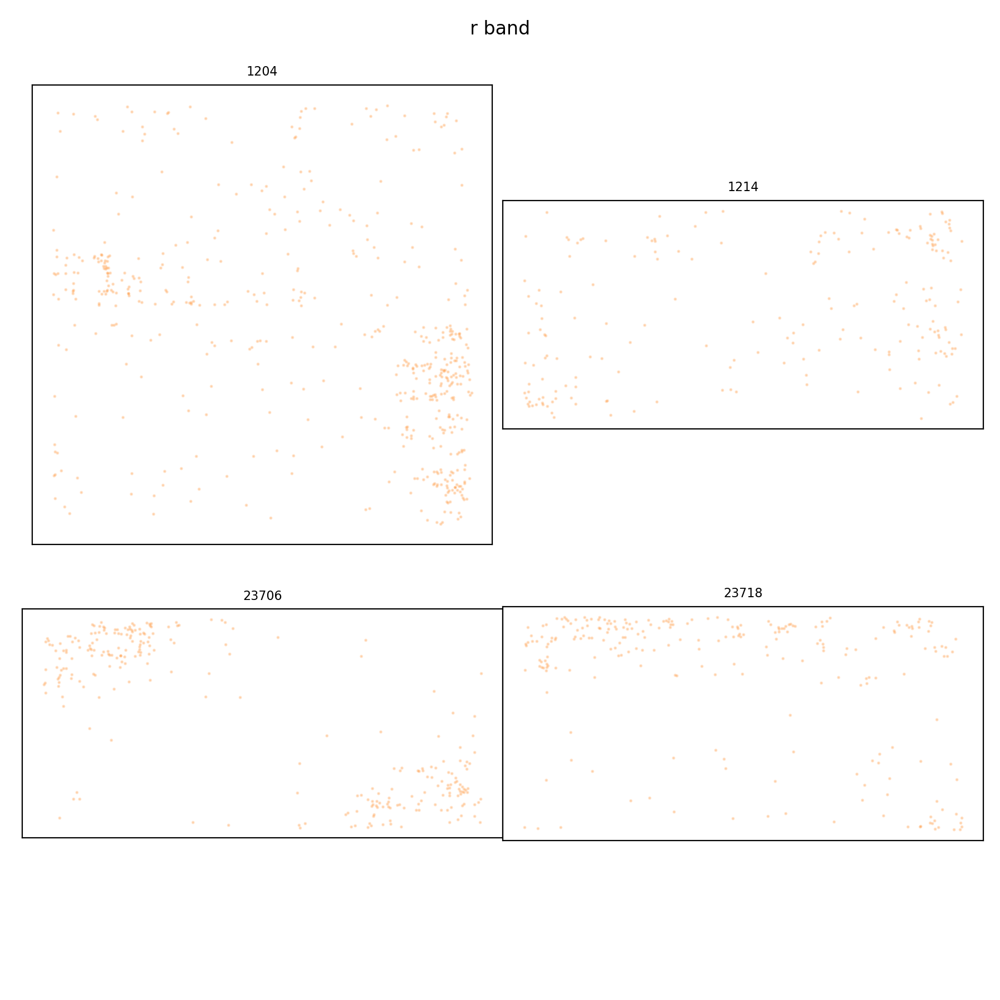

<IPython.core.display.Javascript object>


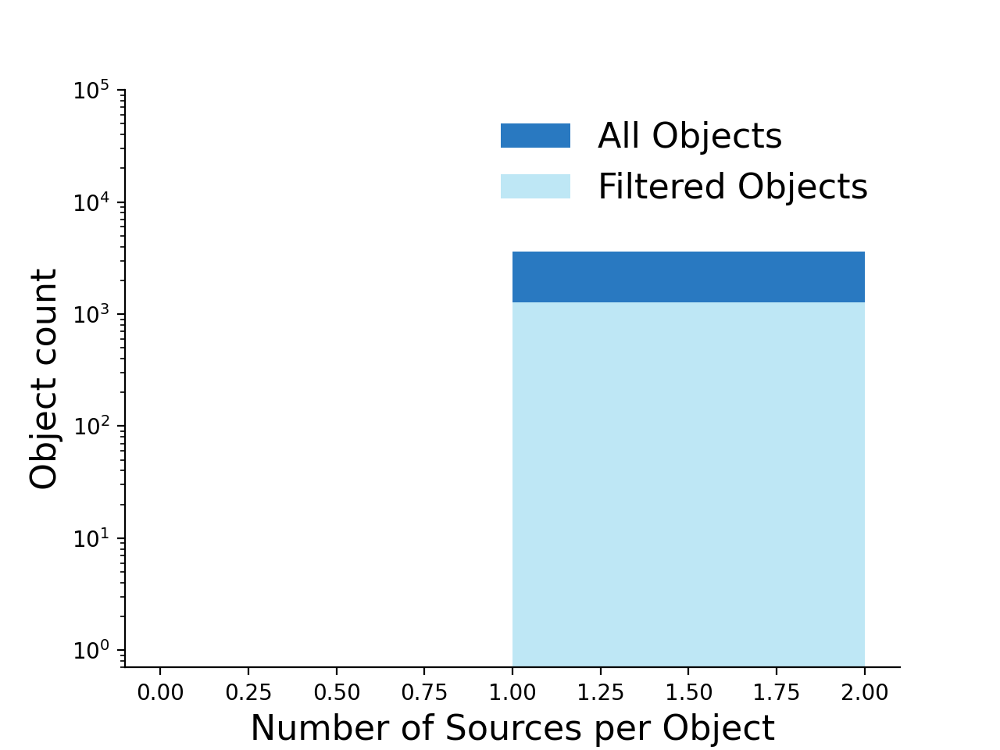

<IPython.core.display.Javascript object>


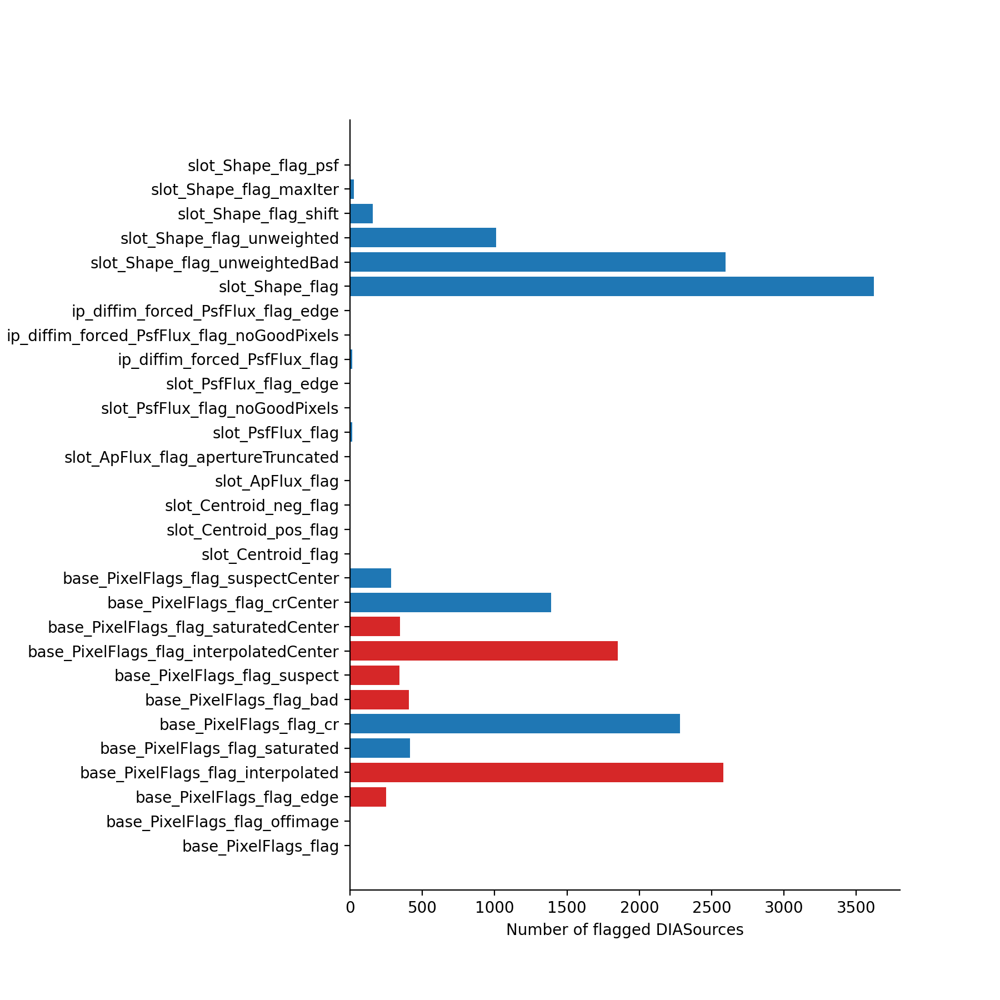

<IPython.core.display.Javascript object>


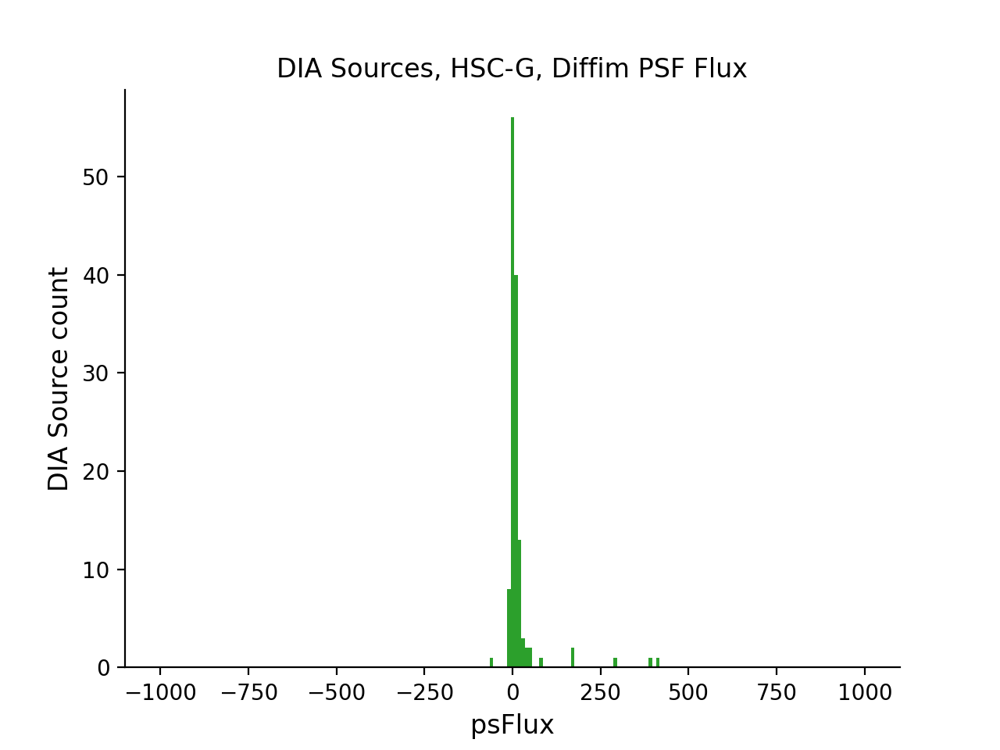

<IPython.core.display.Javascript object>


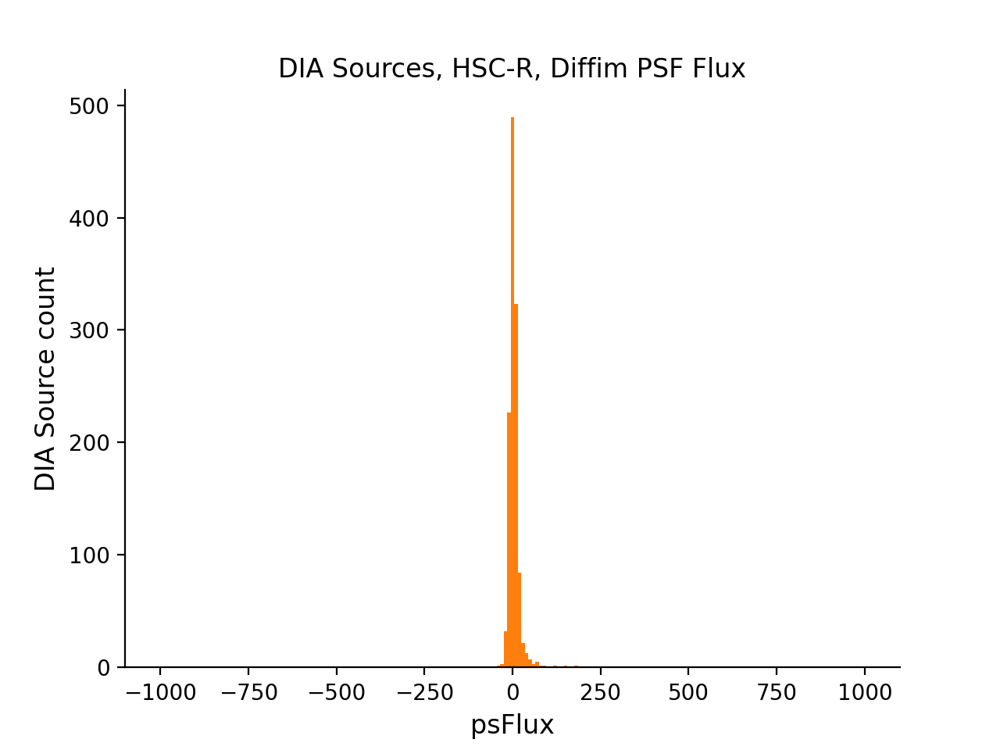

<IPython.core.display.Javascript object>


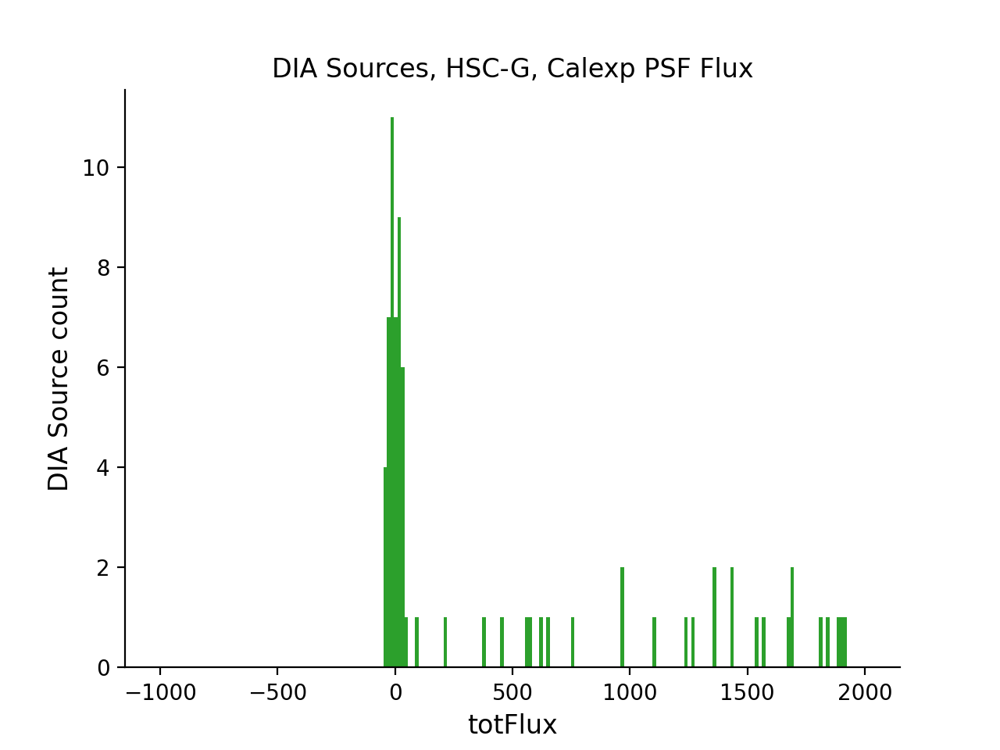

<IPython.core.display.Javascript object>


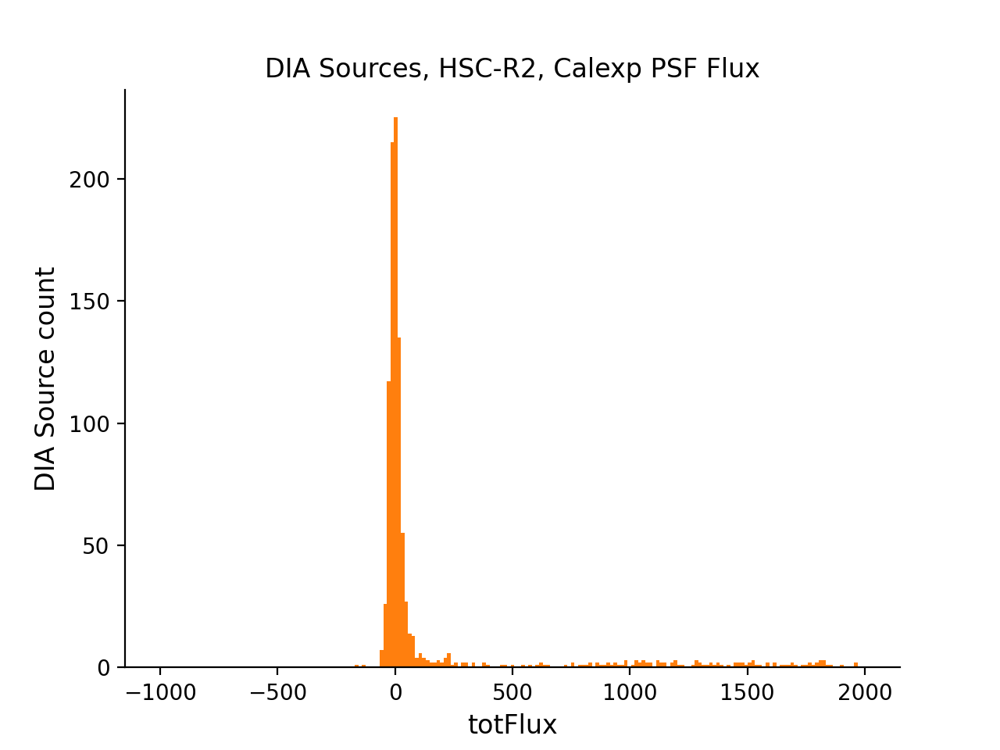

<IPython.core.display.Javascript object>


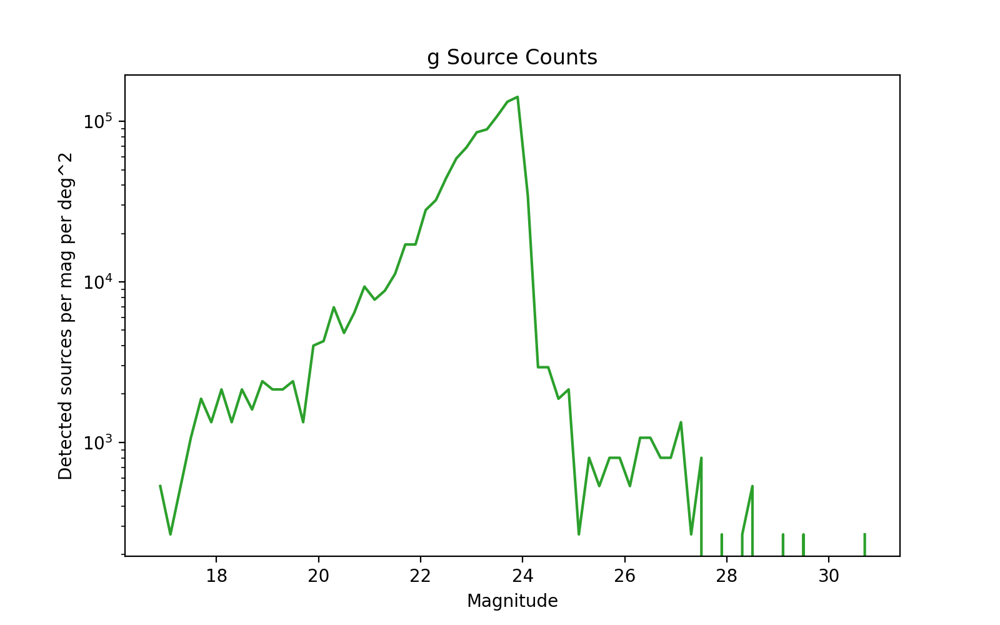

<IPython.core.display.Javascript object>


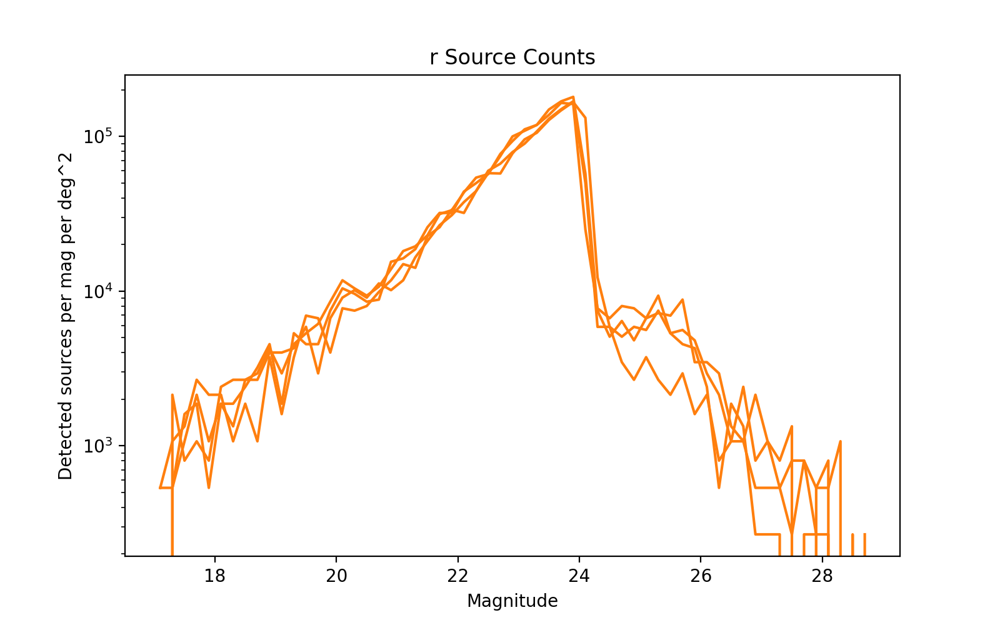

<IPython.core.display.Javascript object>


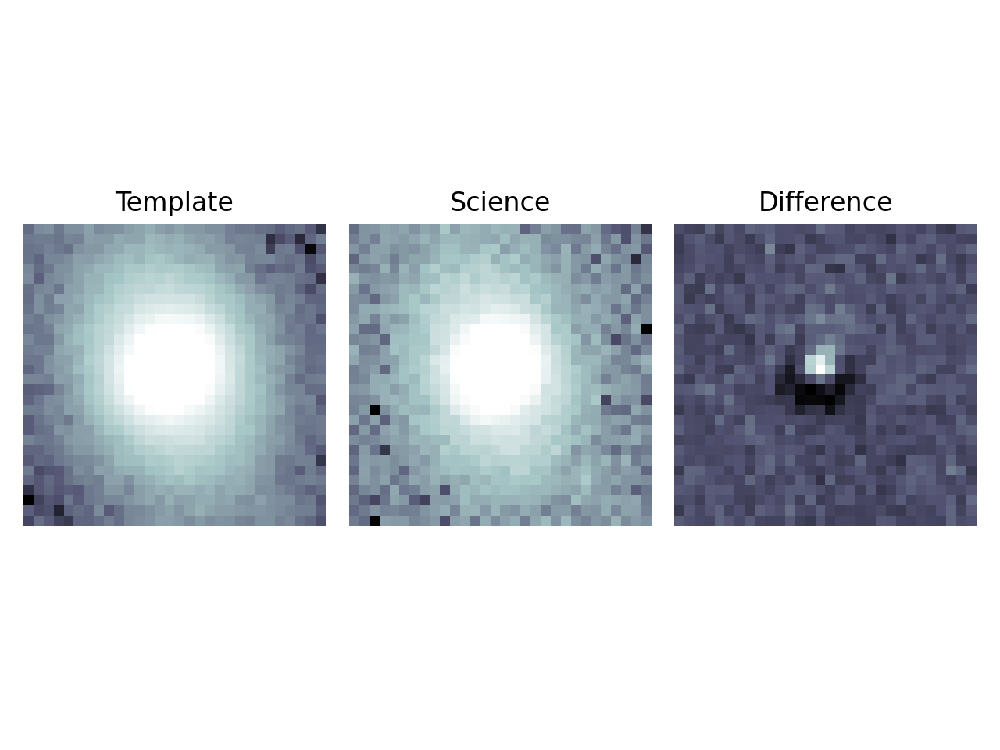

<IPython.core.display.Javascript object>


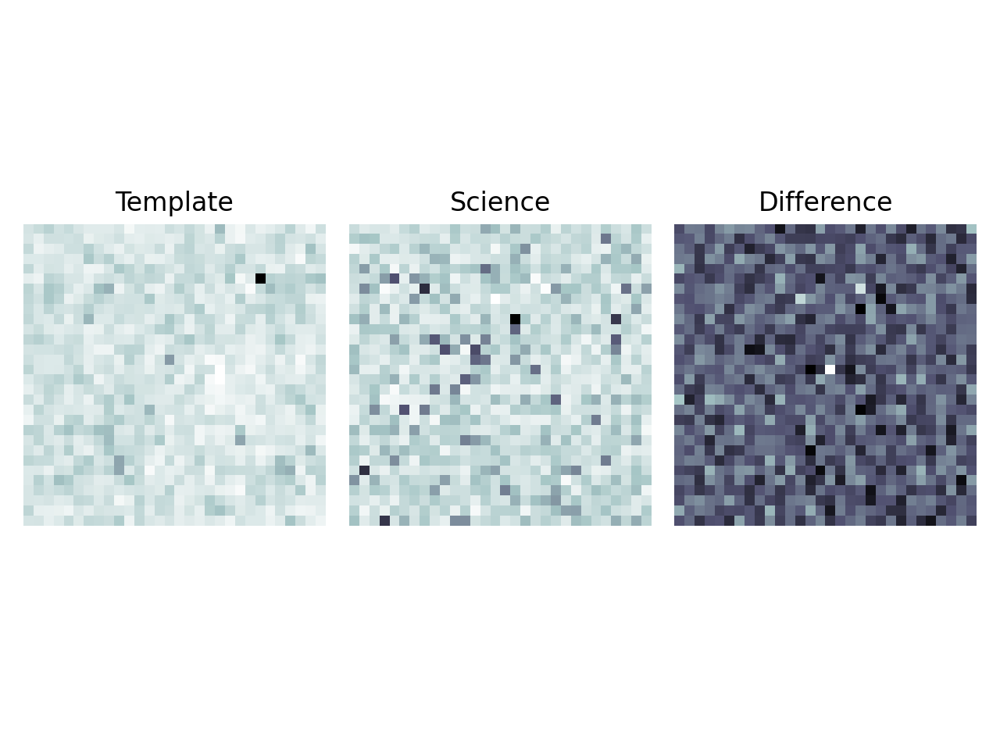

<IPython.core.display.Javascript object>


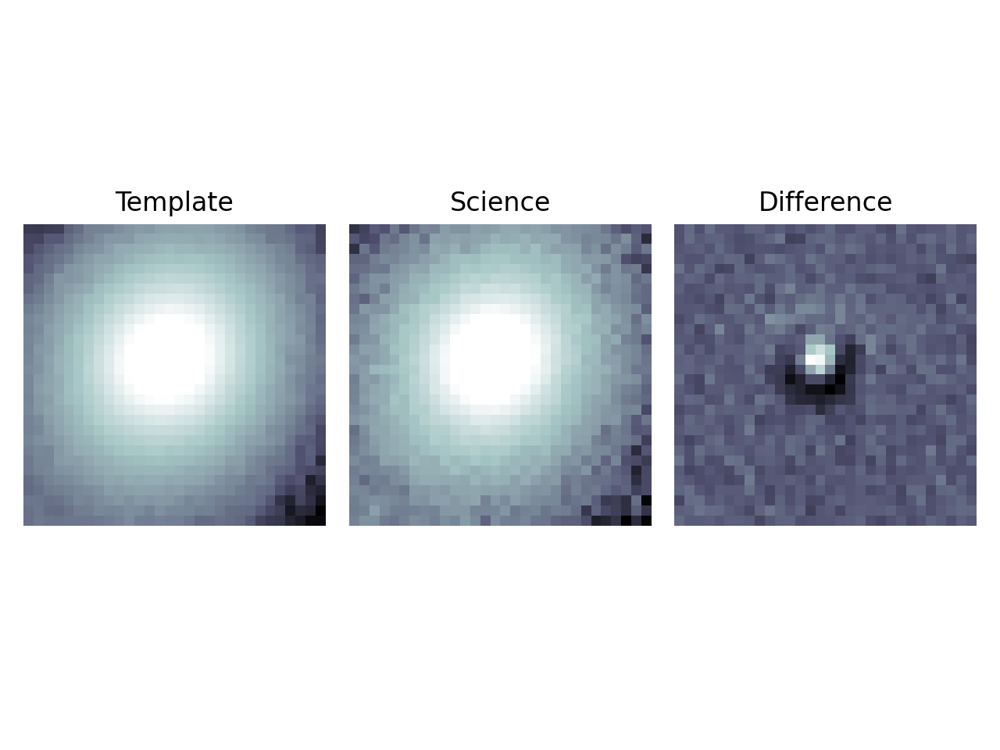

<IPython.core.display.Javascript object>


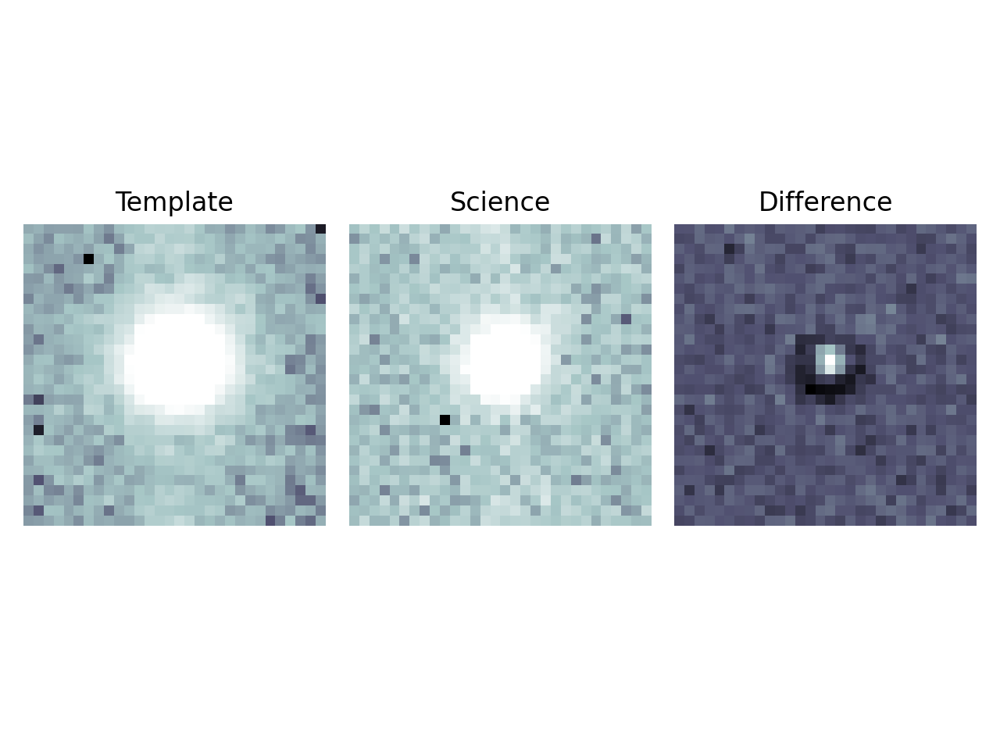

u/kherner/ApPipe_convolveSci_bestSeeing /project/kherner/diffim_sprint_2021-02/bps_testing/bps_convolveSci_best.db


<IPython.core.display.Javascript object>


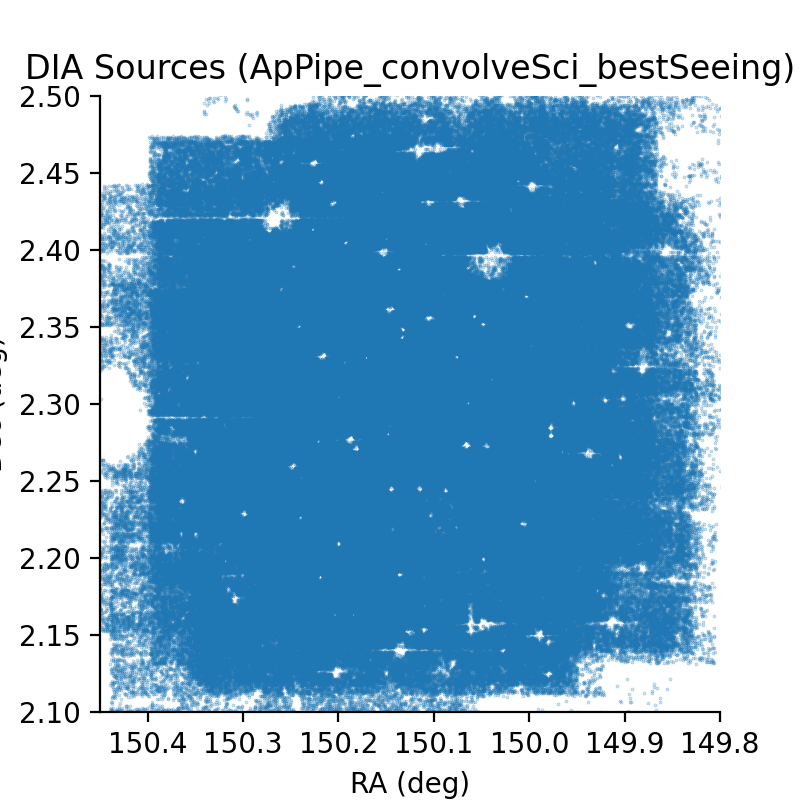

<IPython.core.display.Javascript object>


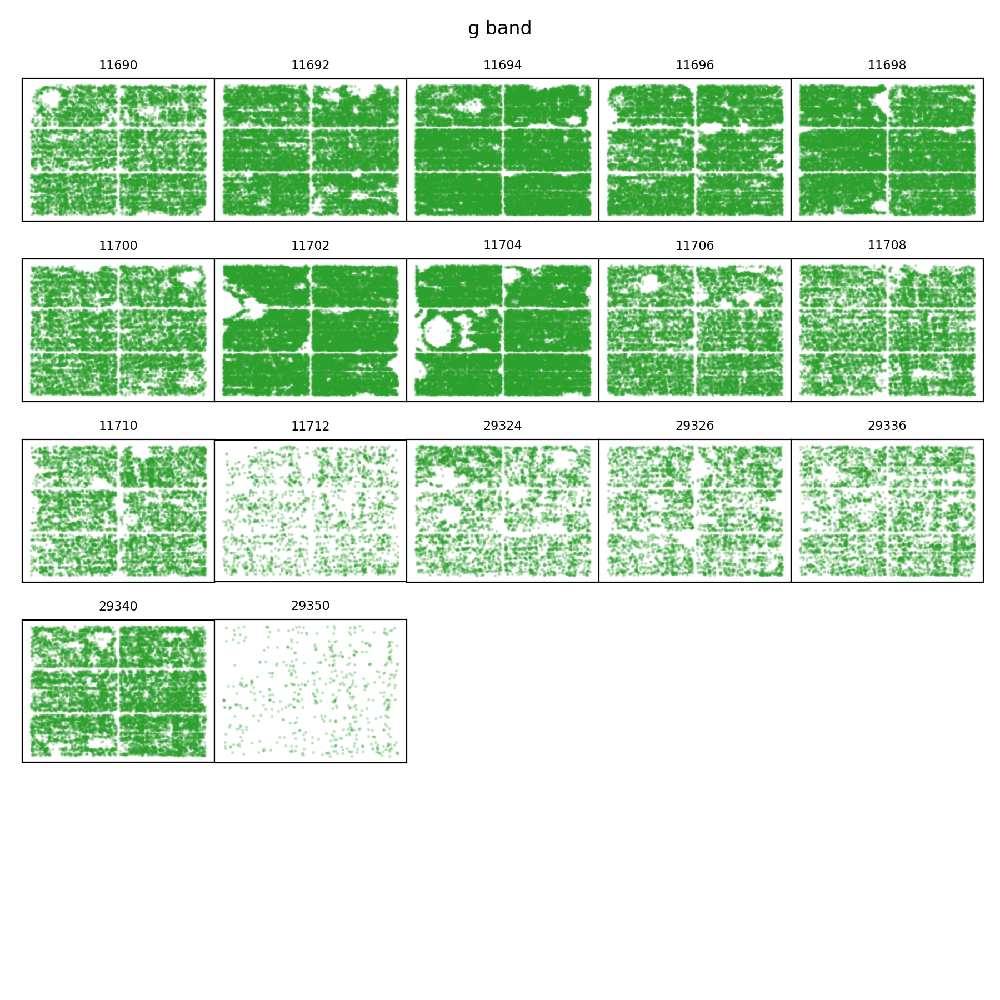

<IPython.core.display.Javascript object>


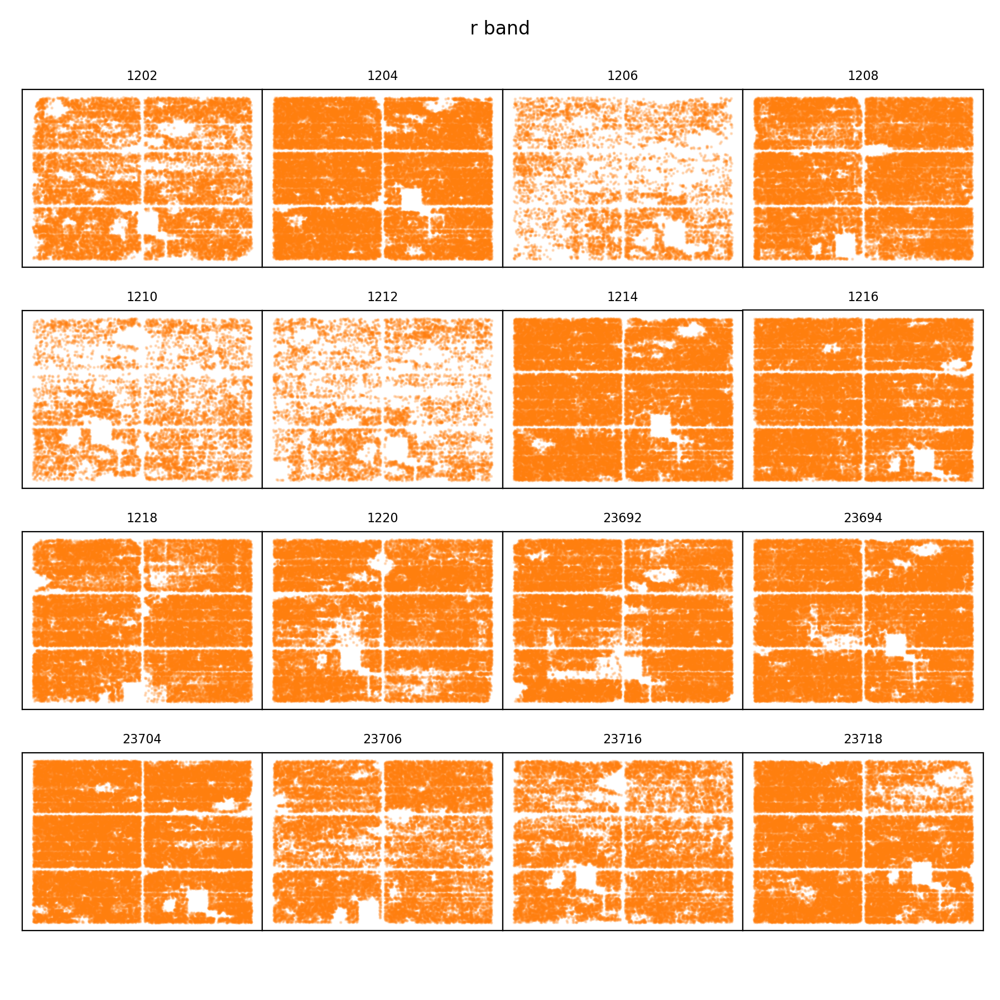

<IPython.core.display.Javascript object>


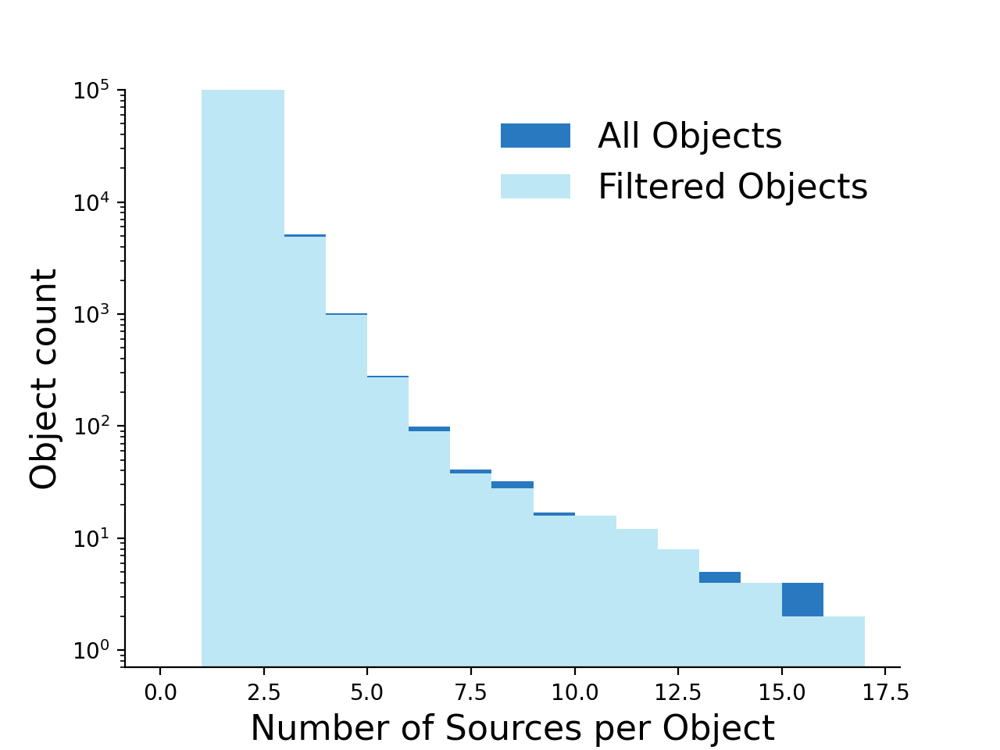

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


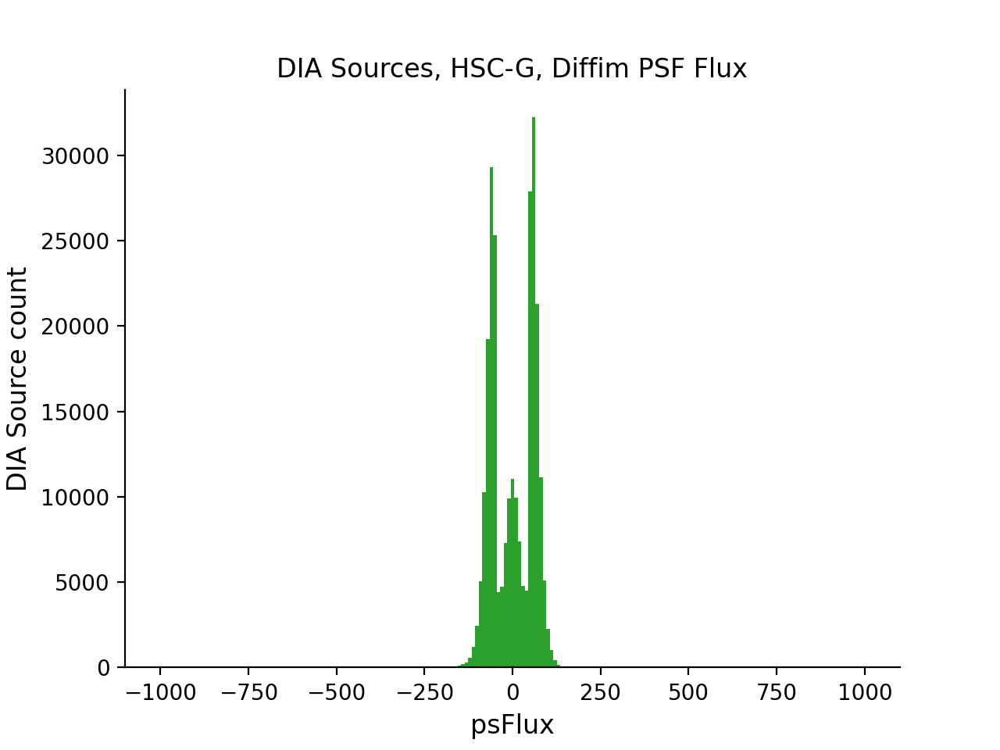

<IPython.core.display.Javascript object>


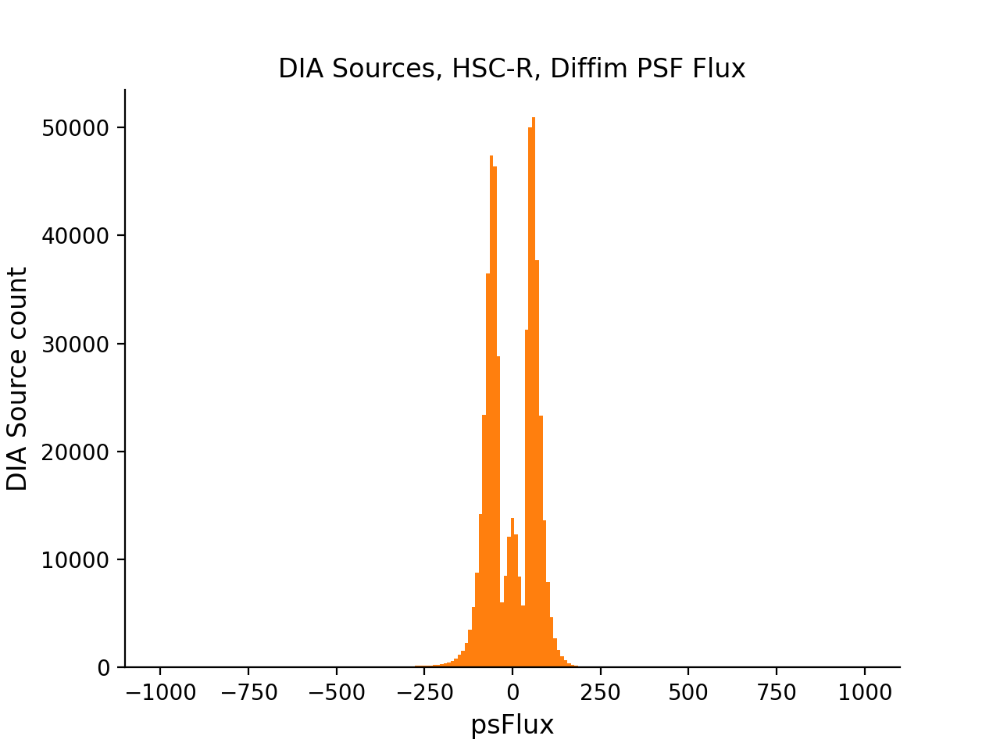

<IPython.core.display.Javascript object>


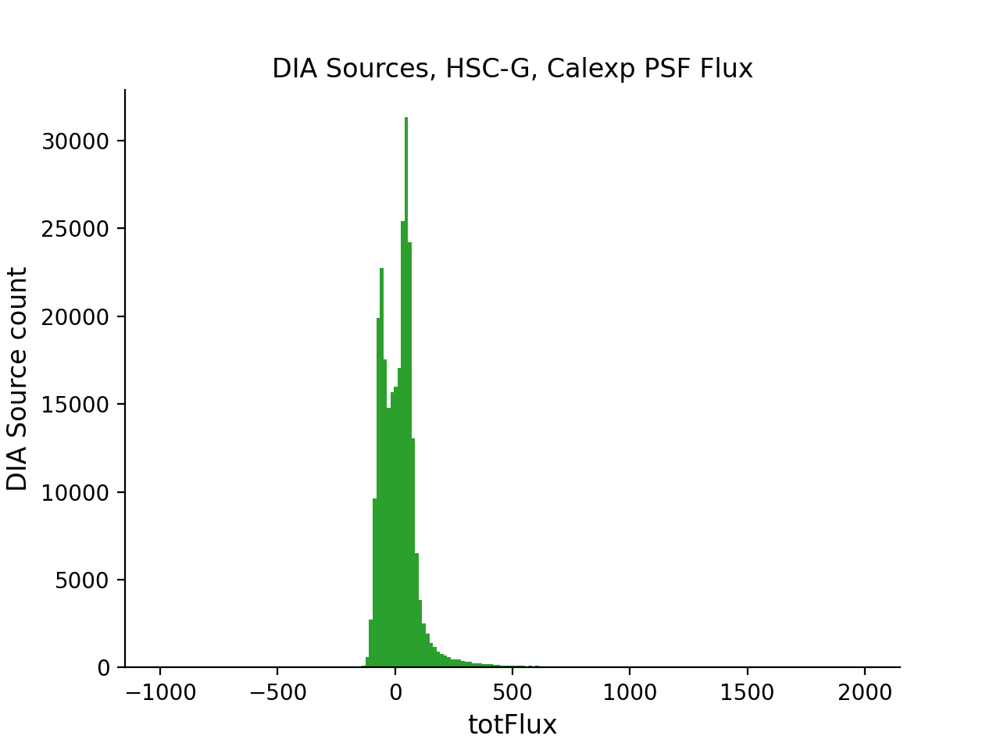

<IPython.core.display.Javascript object>


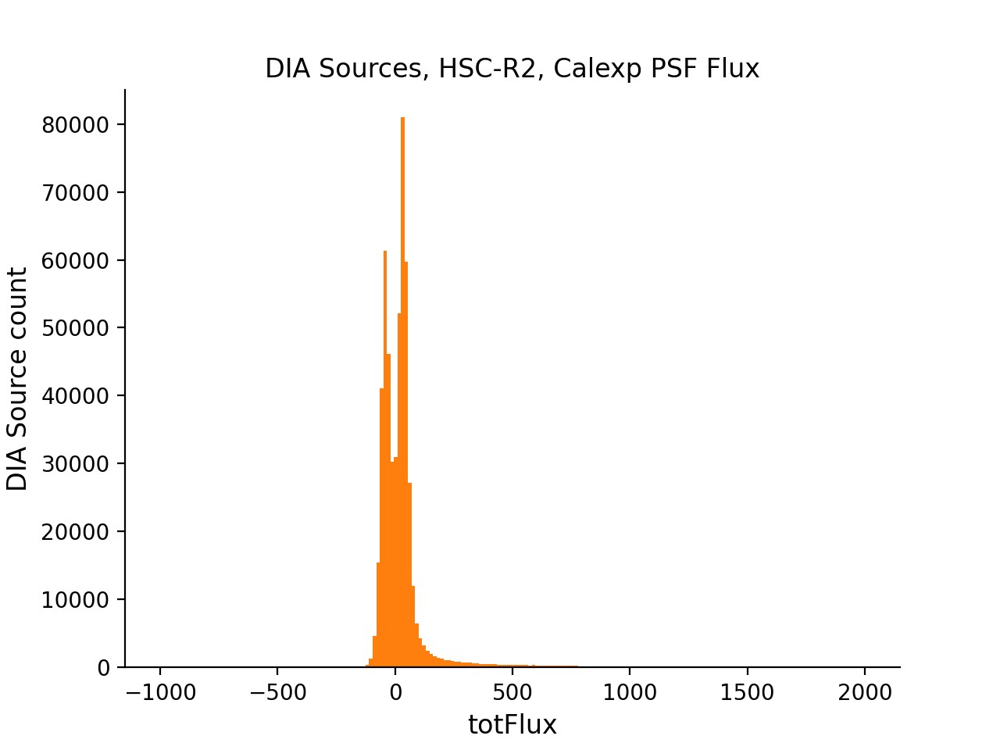

<IPython.core.display.Javascript object>


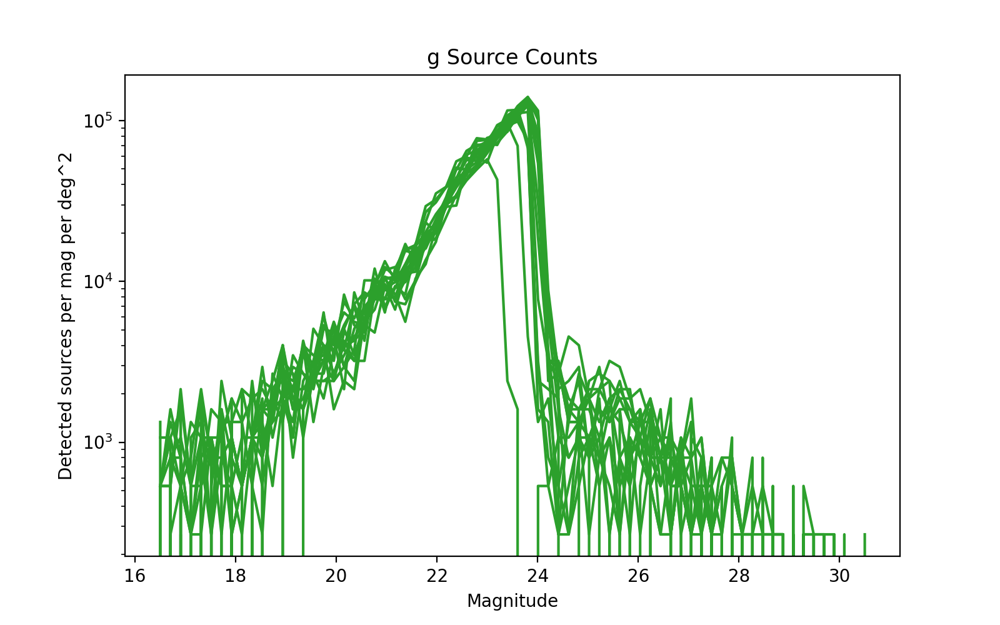

<IPython.core.display.Javascript object>


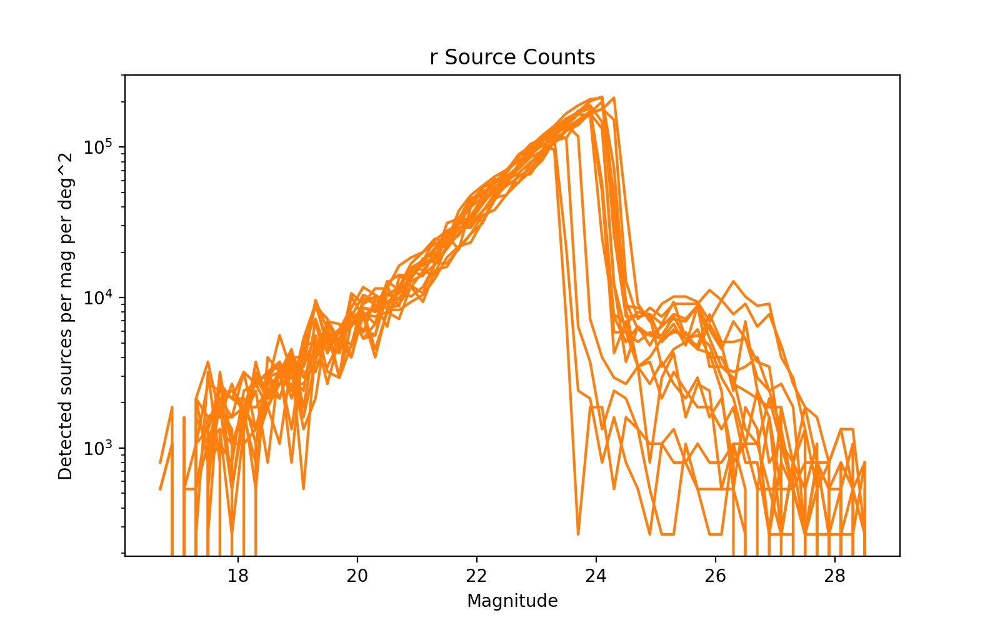

<IPython.core.display.Javascript object>


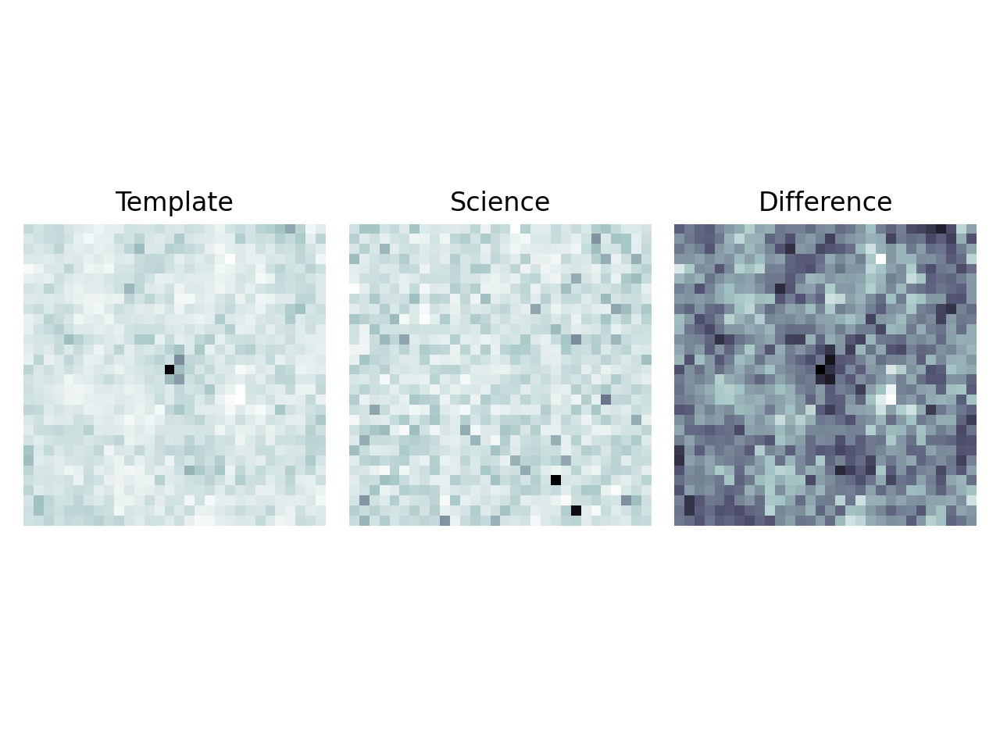

<IPython.core.display.Javascript object>


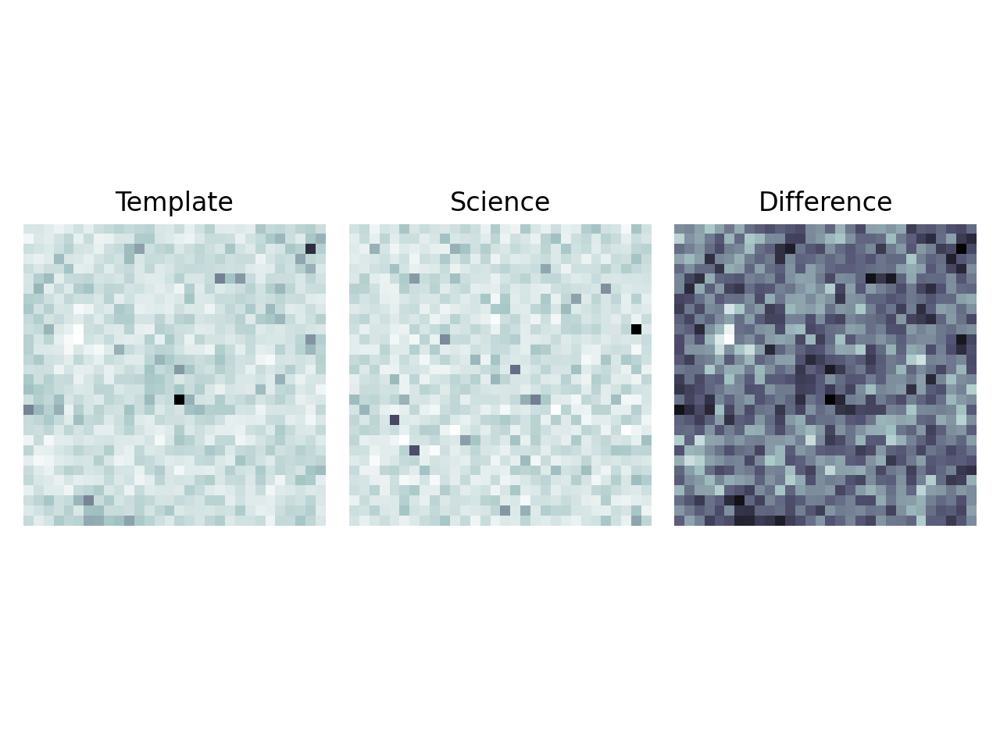

<IPython.core.display.Javascript object>


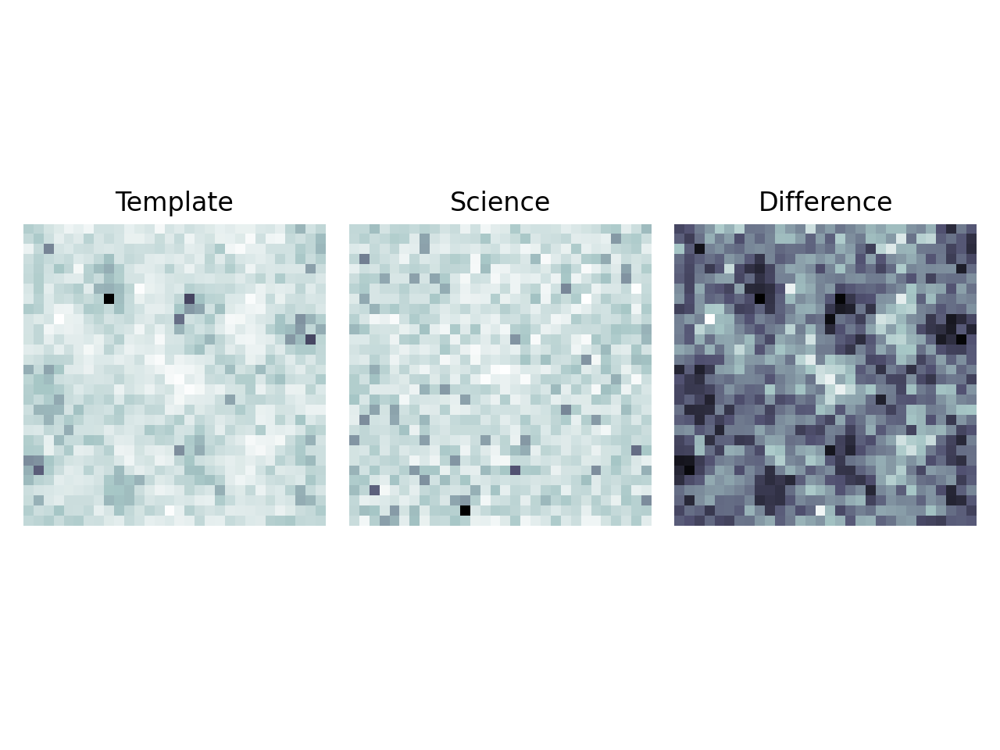

<IPython.core.display.Javascript object>


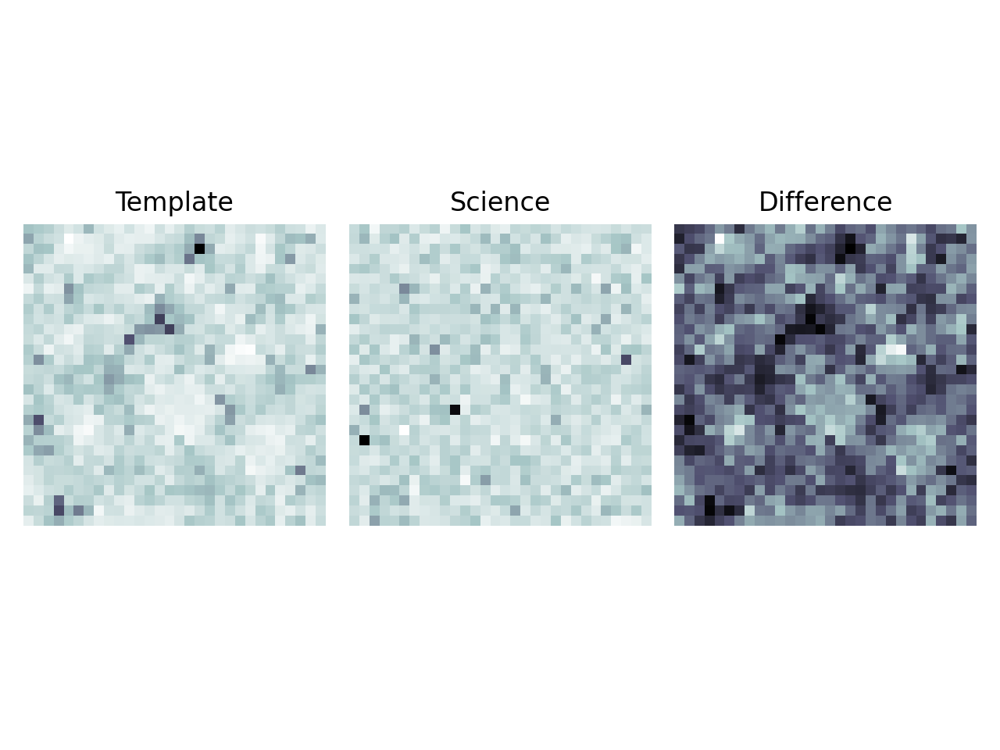

u/kherner/ApPipe_convolveSci_noDecorr_worstSeeing /project/kherner/diffim_sprint_2021-02/bps_testing/bps_convolveSci_noDecorr_worst.db


<IPython.core.display.Javascript object>


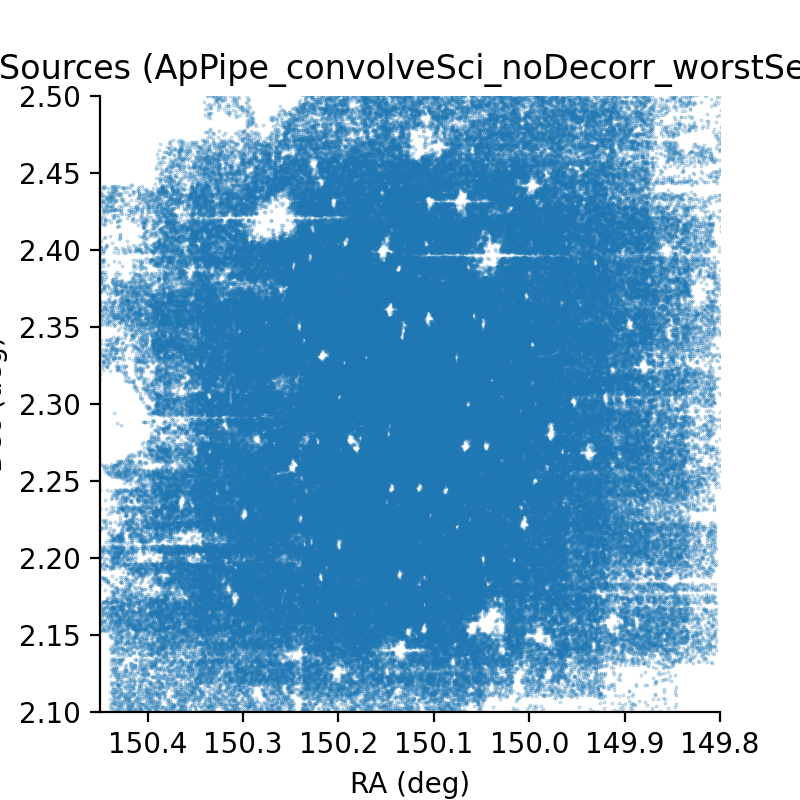

<IPython.core.display.Javascript object>


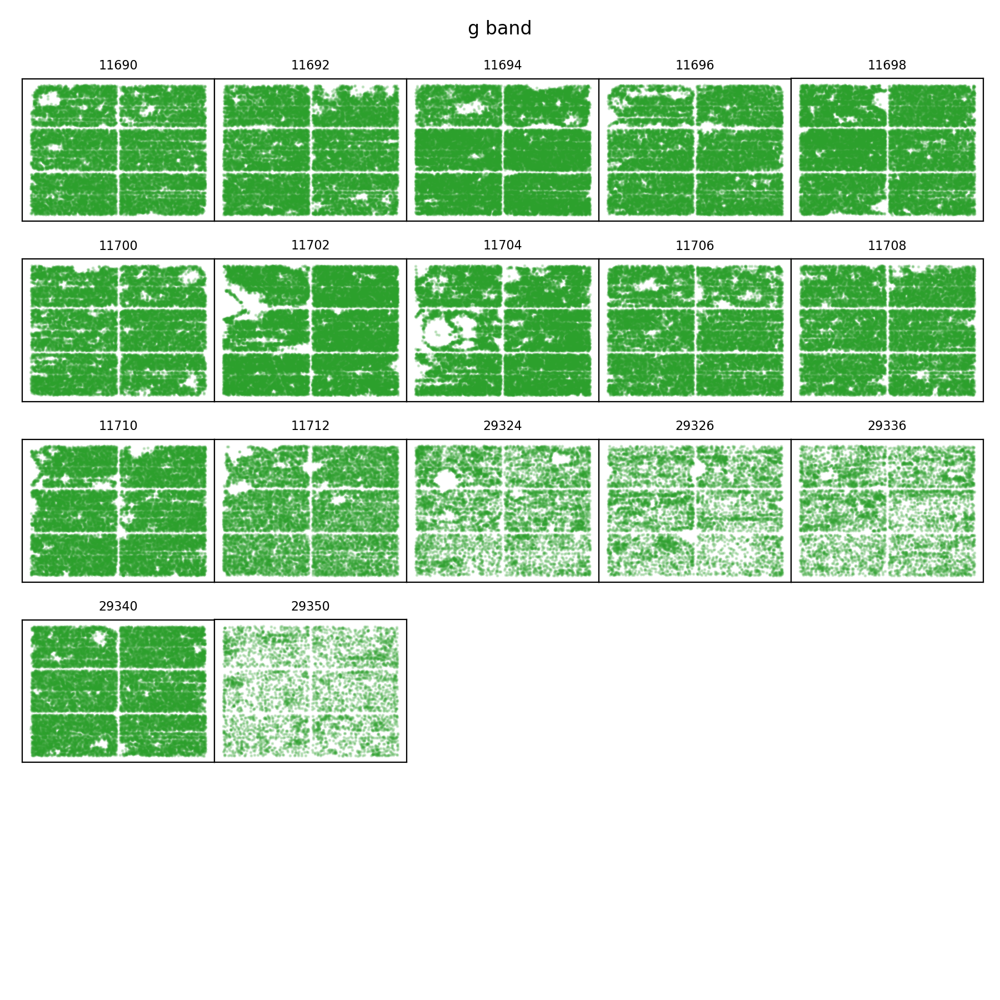

<IPython.core.display.Javascript object>


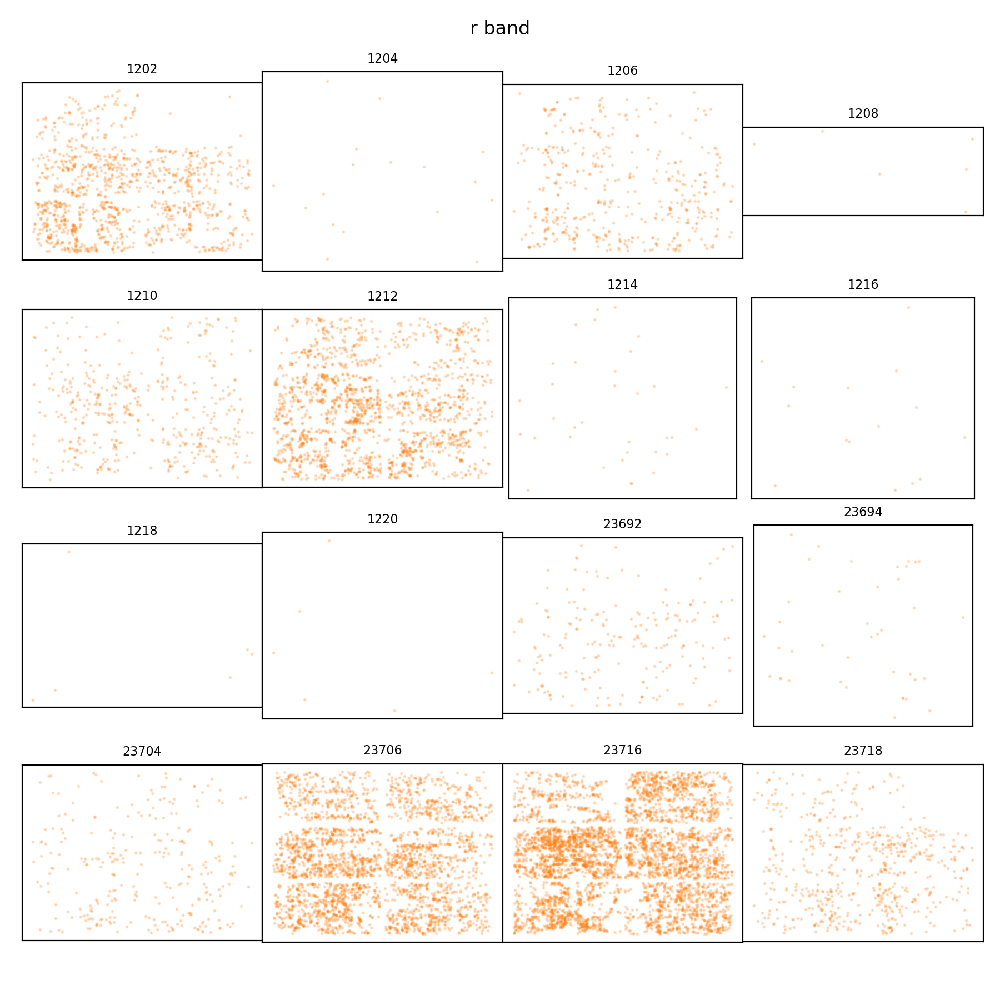

<IPython.core.display.Javascript object>


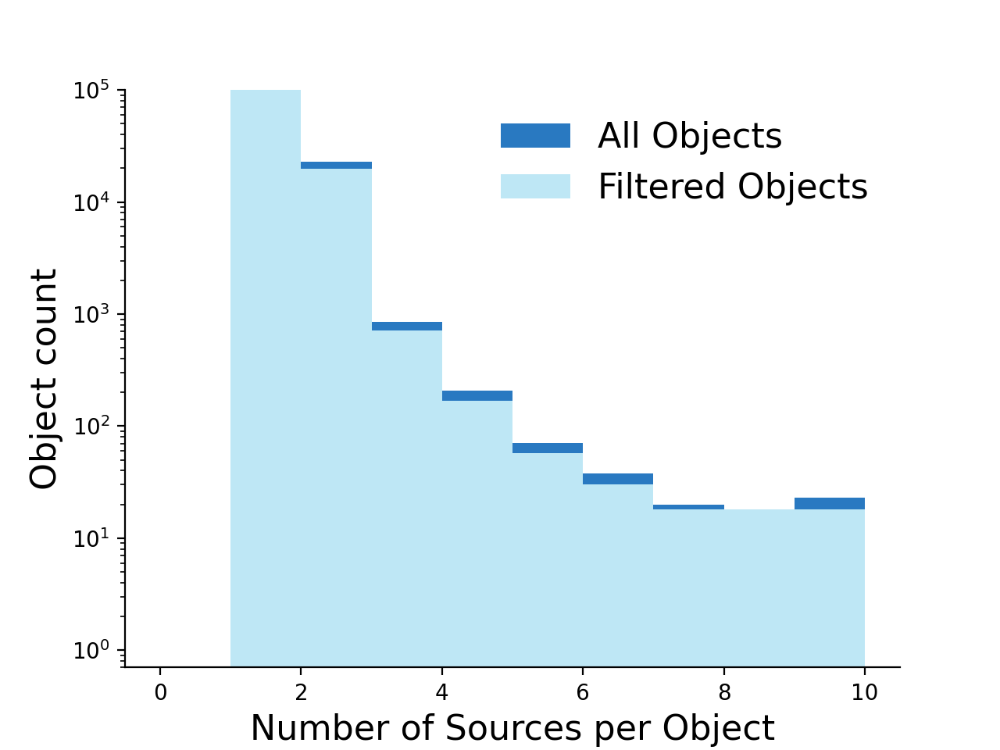

<IPython.core.display.Javascript object>


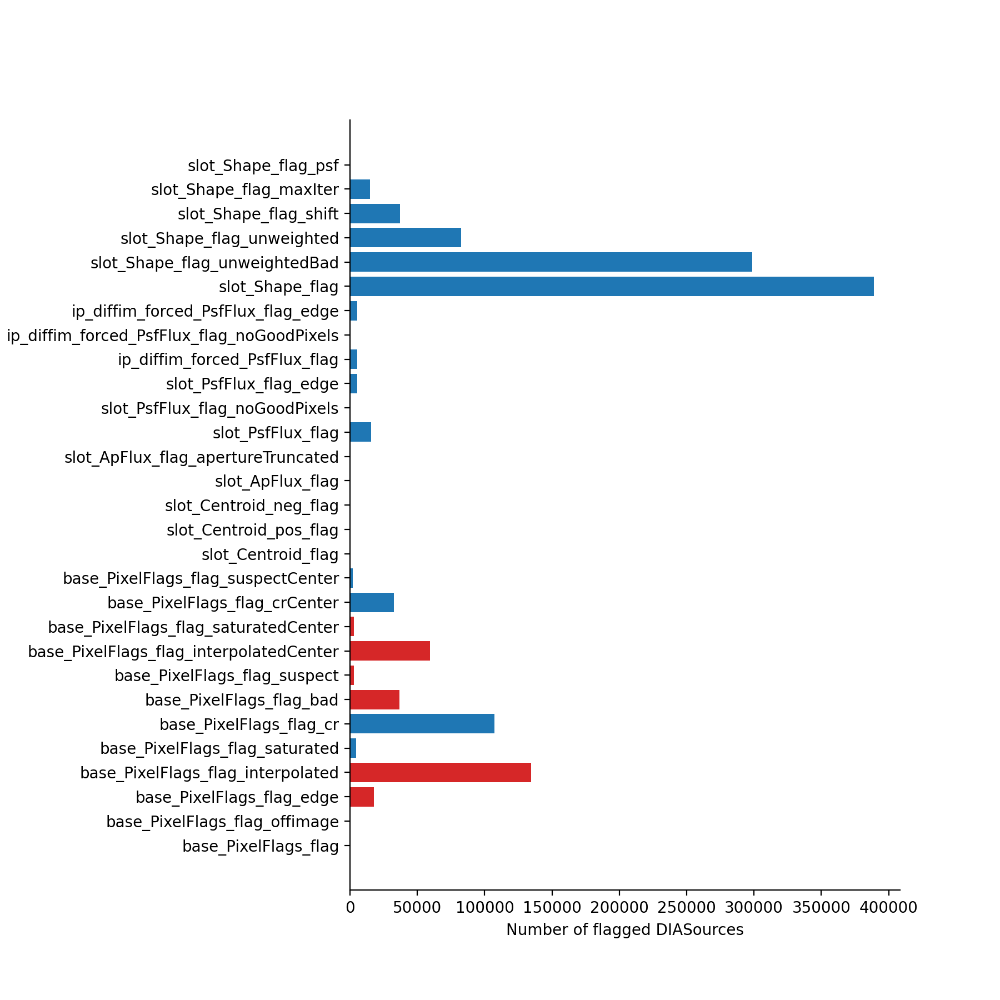

<IPython.core.display.Javascript object>


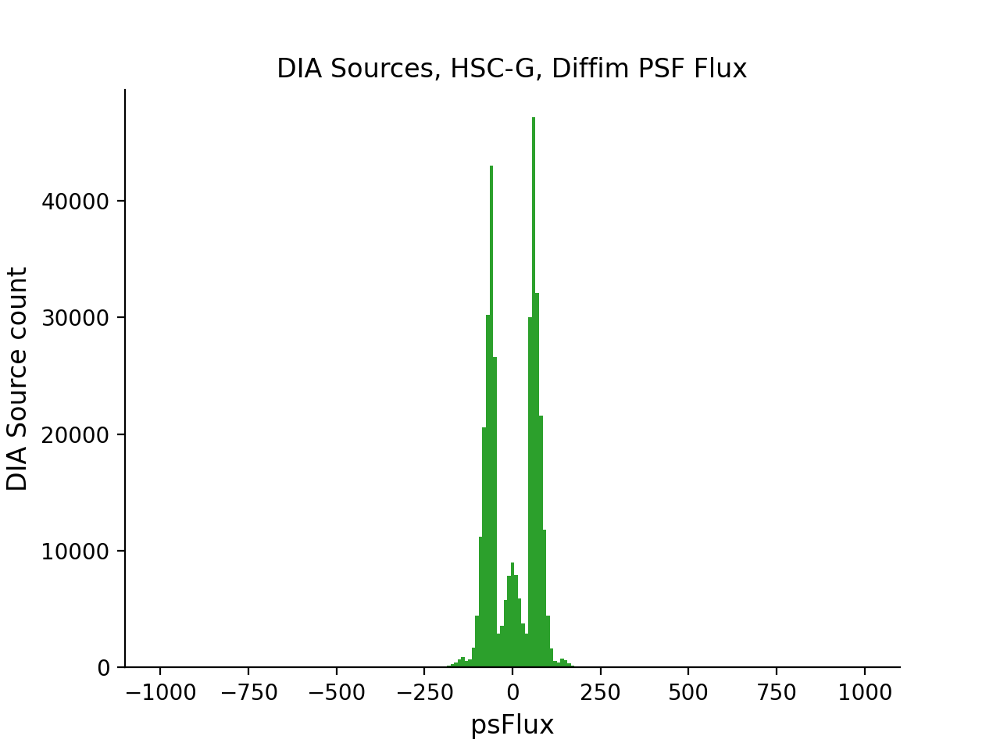

<IPython.core.display.Javascript object>


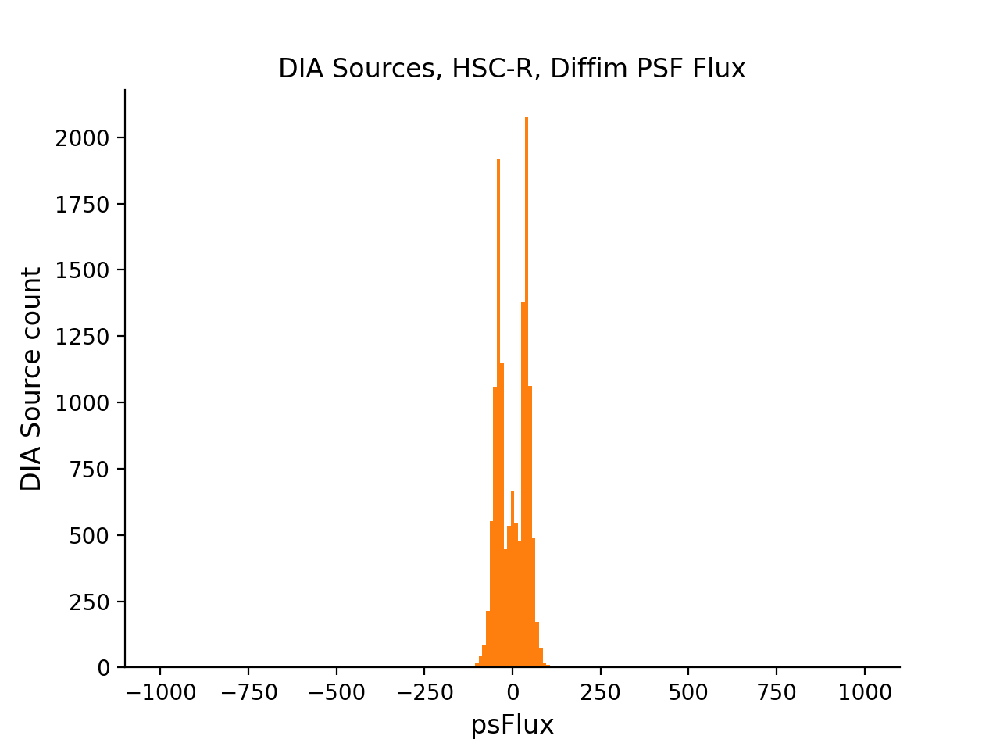

<IPython.core.display.Javascript object>


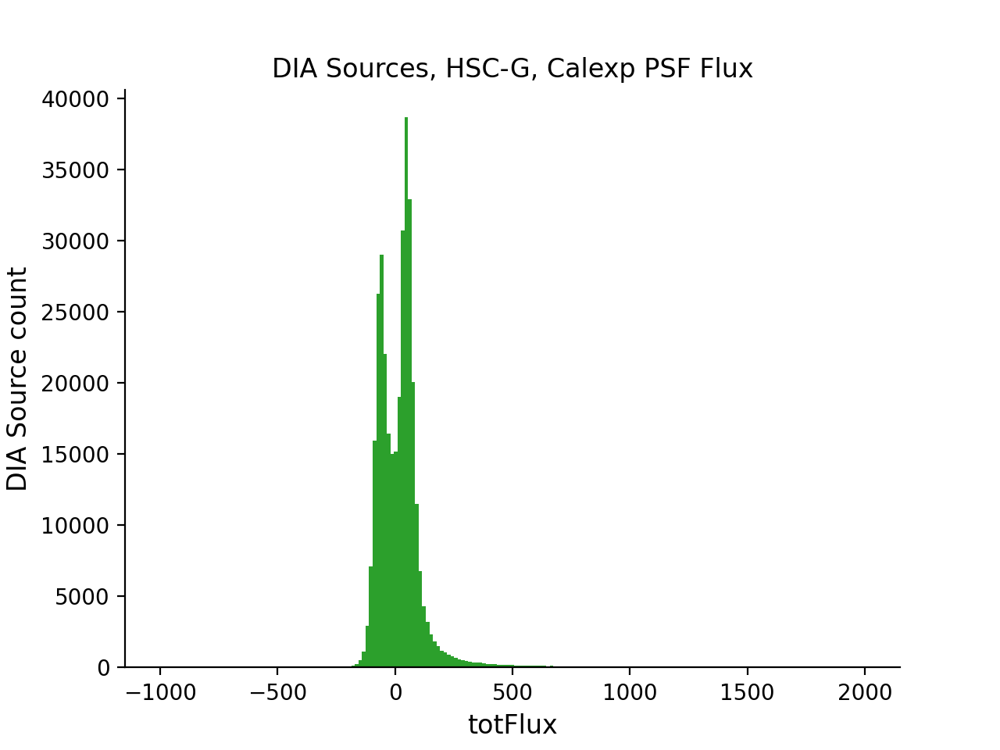

<IPython.core.display.Javascript object>


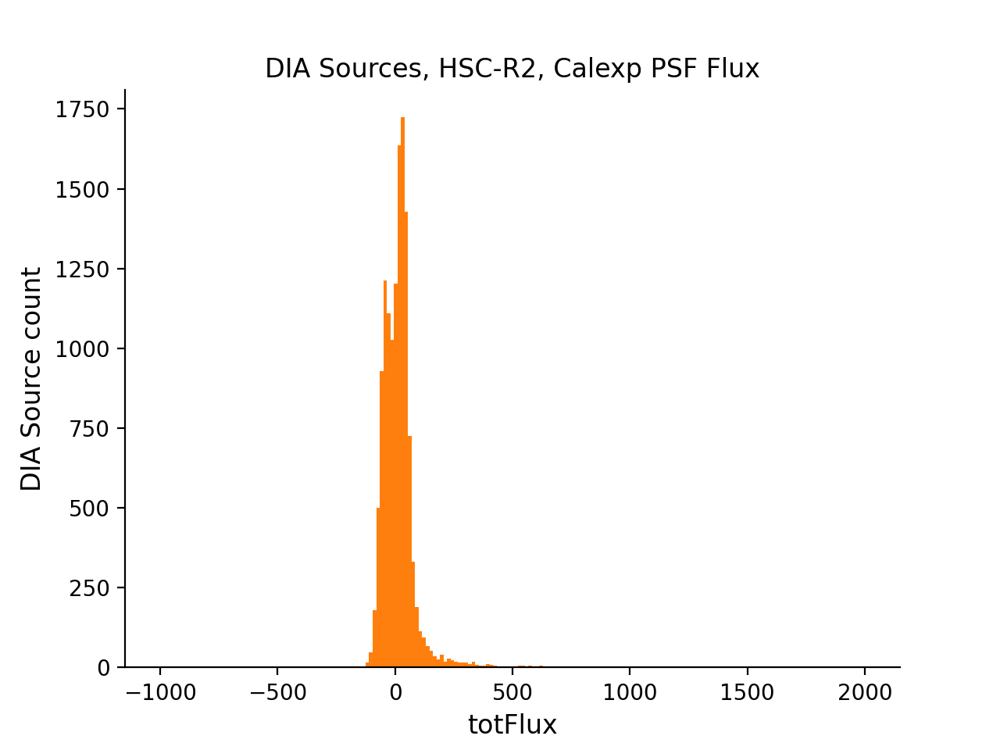

<IPython.core.display.Javascript object>


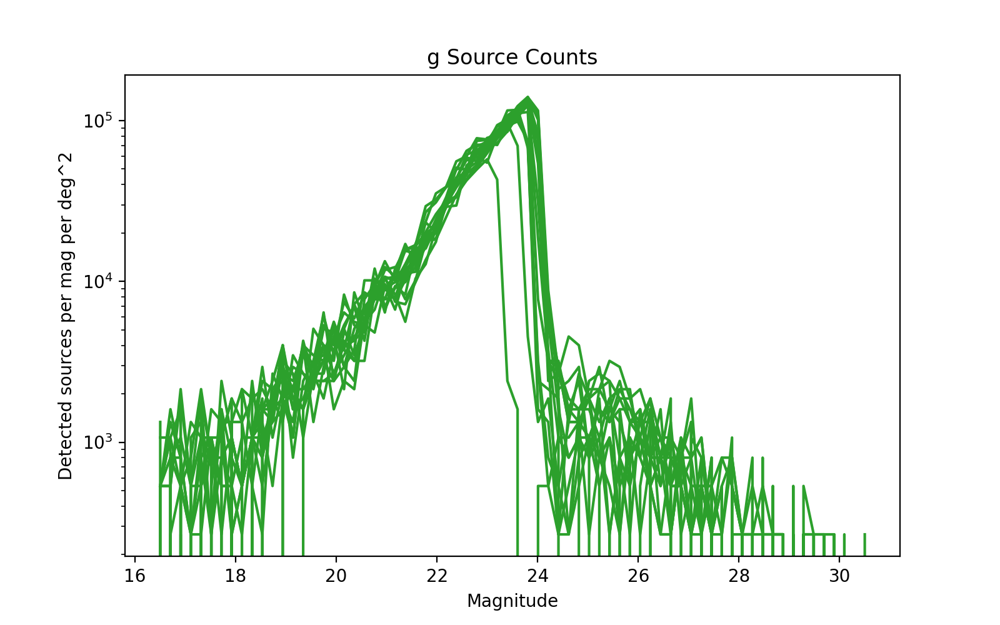

<IPython.core.display.Javascript object>


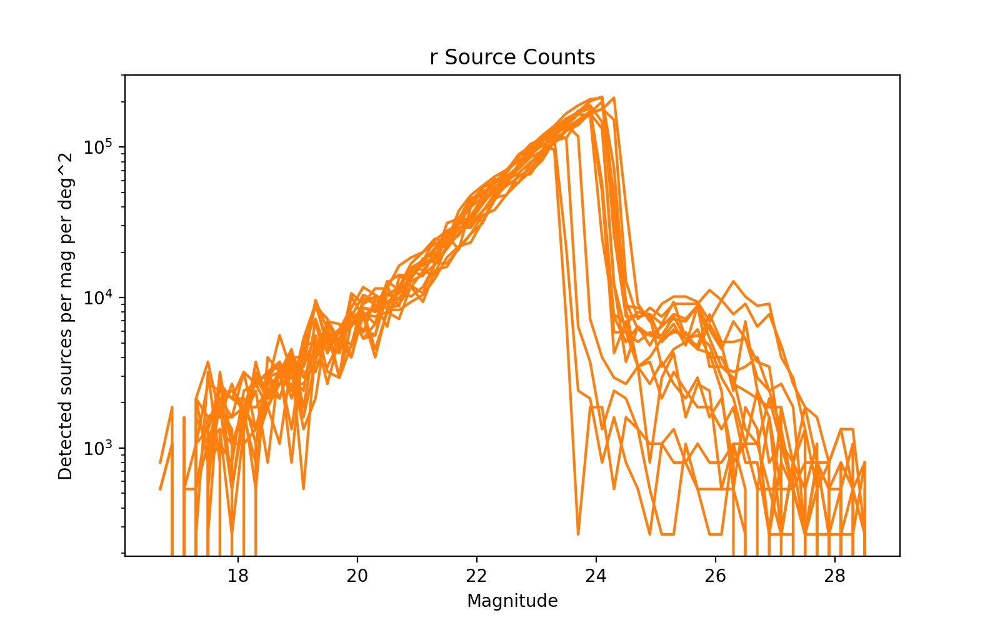

<IPython.core.display.Javascript object>


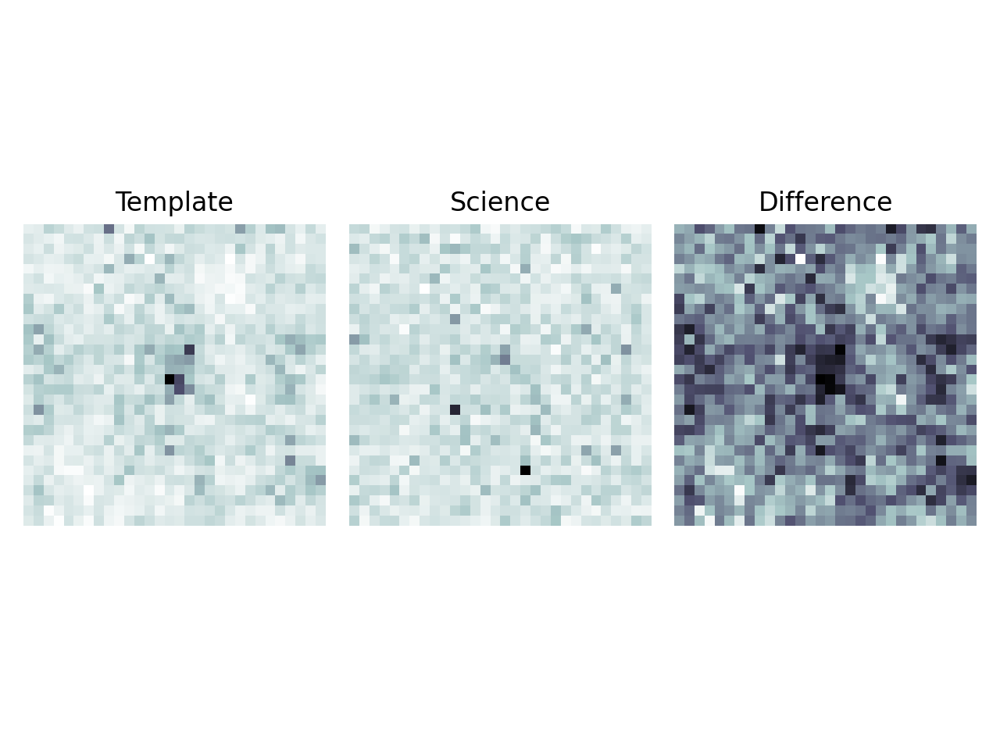

<IPython.core.display.Javascript object>


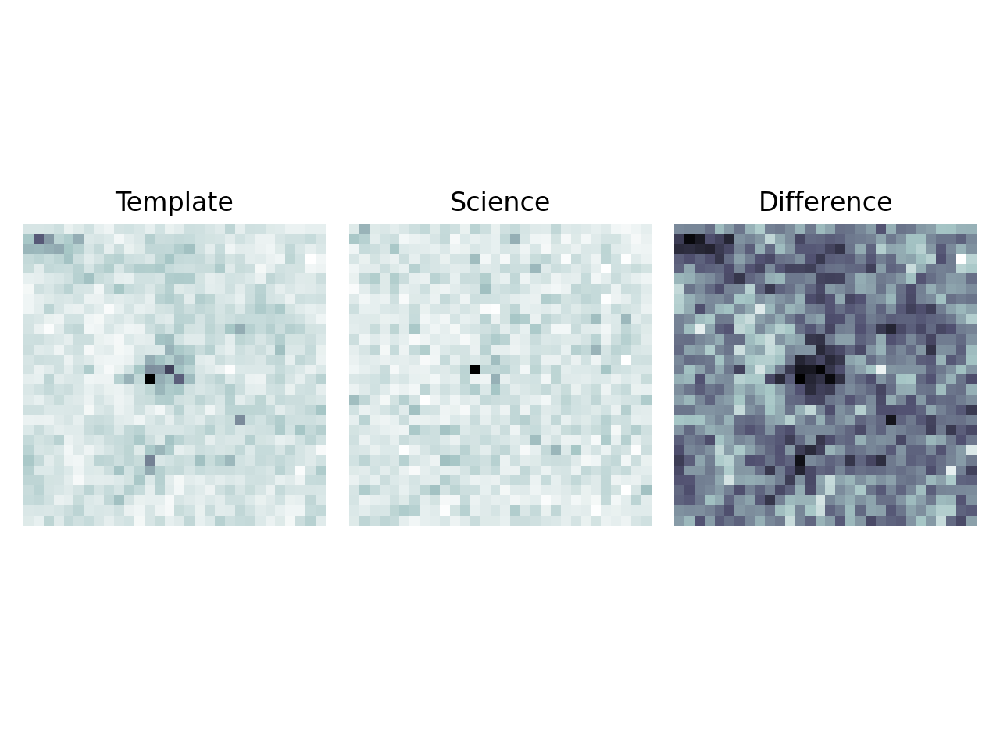

<IPython.core.display.Javascript object>


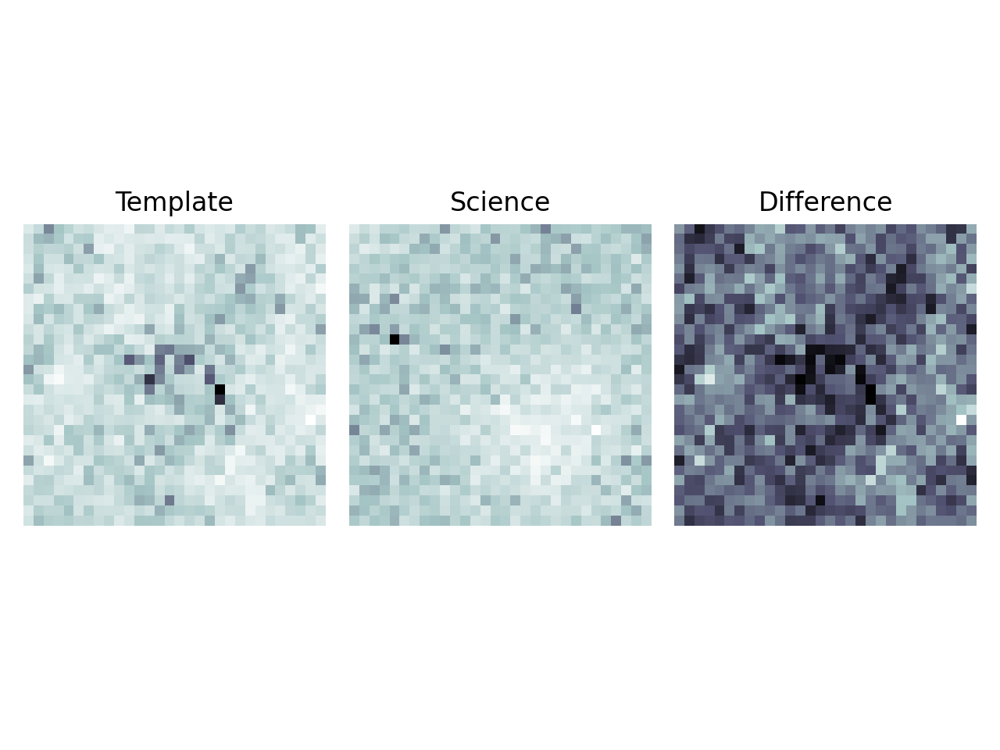

<IPython.core.display.Javascript object>


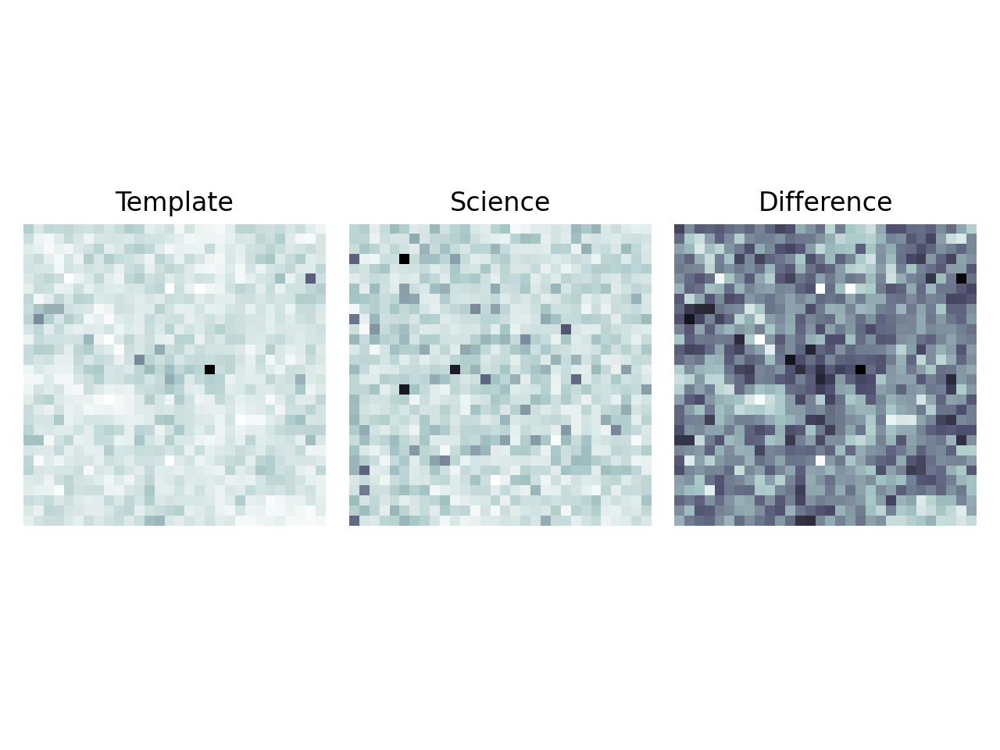

In [15]:
for run in run_list:
    collection = run.collection
    apdb = run.apdb
    print(collection, apdb)
    dbPath = apdb
    objTable, srcTable, goodObj, goodSrc = pla.loadTables(repo, dbType='sqlite', dbName=dbPath, gen='gen3',
                                                          instrument='HSC')
    srcTable = pla.addVisitCcdToSrcTable(srcTable, instrument='HSC', gen='gen3', butler=butler)
    flagTable, srcTableFlags, flagFilter, goodSrc, goodObj = pla.makeSrcTableFlags(srcTable, objTable,
                                                                                   badFlagList=badFlagList,
                                                                                   gen='gen3', instrument='HSC',
                                                                                   repo=repo)
    # Good DIA Sources
    fig = plt.figure(figsize=(4,4))
    xlim = (150.45, 149.8)
    ylim = (2.1, 2.5)
    ax = fig.add_subplot(111)
    plt.setp(ax, xlim=xlim, ylim=ylim)
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.scatter(goodSrc['ra'], goodSrc['decl'], c='C0', s=0.1, marker='o', alpha=0.4)
    ax.set_xlabel('RA (deg)')
    ax.set_ylabel('Dec (deg)')
    ax.set_title(f'DIA Sources ({str(collection).split("/")[-1]})')
    
    # Good DIA Sources by visit
    bandList = ['g', 'r']
    colorList = ['C2', 'C1']
    for band, color in zip(bandList, colorList):
        pla.plotDiaSourcesOnSkyGrid(repo, goodSrc.loc[goodSrc['filterName'] == band],
                                    title=band+' band', color=color, size=5)
    
    # How many DIA Sources comprise each DIA Object
    hist = doa.plotDiaObjectHistogram(objTable, goodObj)
    
    # Flag bar chart
    pla.plotFlagHist(srcTable, badFlagList=badFlagList)
    
    # Flux distributions
    pla.plotFluxHistSrc(goodSrc.loc[goodSrc['filterName'] == 'g'], fluxType='psFlux',
                        title='DIA Sources, HSC-G, Diffim PSF Flux', color1='C2', binmin=-1e3, binmax=1e3)
    pla.plotFluxHistSrc(goodSrc.loc[goodSrc['filterName'] == 'r'], fluxType='psFlux',
                        title='DIA Sources, HSC-R, Diffim PSF Flux', color1='C1', binmin=-1e3, binmax=1e3)
    pla.plotFluxHistSrc(goodSrc.loc[goodSrc['filterName'] == 'g'], fluxType='totFlux',
                        title='DIA Sources, HSC-G, Calexp PSF Flux', color1='C2', binmin=-1e3, binmax=2e3)
    pla.plotFluxHistSrc(goodSrc.loc[goodSrc['filterName'] == 'r'], fluxType='totFlux',
                        title='DIA Sources, HSC-R2, Calexp PSF Flux', color1='C1', binmin=-1e3, binmax=2e3)
    
    # Flux histograms
    pla.source_magnitude_histogram(repo, goodSrc, 'g', 'HSC', collection)
    pla.source_magnitude_histogram(repo, goodSrc, 'r', 'HSC', collection)
    
    # A few cutouts
    for index, source in goodSrc[:4].iterrows():
        dataId = {'detector': int(goodSrc['ccd'][index]), 'visit': int(goodSrc['visit'][index]), 'instrument': 'HSC'}
        center = lsst.geom.SpherePoint(goodSrc['ra'][index], goodSrc['decl'][index], lsst.geom.degrees)
        scienceCutout, differenceCutout, templateCutout = plc.retrieveCutouts(butler, dataId, collection, center)
        plc.plotCutout(scienceCutout, differenceCutout, templateCutout)